## Load imports

In [1]:
from unittest.mock import patch

# Disable tqdm progress bars globally for LaplaceRFM
with patch("tqdm.contrib.tenumerate", lambda iterable, *args, **kwargs: enumerate(iterable)):
    from rfm import LaplaceRFM
import re
import os
import numpy as np
import pandas as pd
import torch
from pathlib import Path
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.linear_model import Ridge
from torch.utils.data import DataLoader, TensorDataset
from itertools import combinations
from statsmodels.stats.multitest import multipletests
import matplotlib.pyplot as plt
import seaborn as sns

from Capybara.preprocess import DataPreprocessor, MultiDS
from Capybara.pipeline import (
    LaplaceRFMAnalyzer,
    RidgeTrainer,
    RFMGroupAnalysis,
    TransferabilityAnalysis,
    TransferabilityTools,
    OverlapFinder,
    DataSetNameParser,
    TrainTestIndexBuilder,
    PredictionCombiner,
    PredictionPlotter,
    load_perf
)
from Capybara.ridge_equations import (
    ThresholdEquationBuilder,
    EquationEvaluator,
    EquationAverager,
)
from Capybara.utils import write_groups_csv, write_importance_csv, dump_json, load_json


In [2]:
import importlib
import Capybara.utils
importlib.reload(Capybara.utils)

<module 'Capybara.utils' from 'c:\\Users\\sorsinelli\\Documents\\GitHub\\CAPYBARA\\Capybara\\utils.py'>

In [2]:


pre = DataPreprocessor(
    paths=["Data/Dataset Master File.csv"],
    response_col="HAI",                 # <-- any measurement
    response_transform=lambda x: np.log2(x/5),  # <-- any transform
    viruses_to_keep=["H3N2"],                            # keep all feature columns
)

filtered_df, dataset_dict, *_ = pre.run()


## Preprocess

In [69]:
from pathlib import Path  

mega_csv = Path("Data/Dataset Master File.csv") 

pre = DataPreprocessor(
    paths=[mega_csv],
    exclude_datasets=[
        "",
    ],
    viruses_to_keep=["H3N2"],
)

filtered_df, dataset_dict, dataset__dict_day0, dataset_dict_day21_40 = pre.run()


## Add your own H3N2 Dataset to get predictions from our datasets

In [67]:
import pickle, os, gc
from pathlib import Path
import pandas as pd
# ------------------------------------------------------------------
# 0)  Read the CSV, keep only the target dataset rows
# ------------------------------------------------------------------
full_csv = "Dataset File.csv"
target_ds = "Dataset Name"

df_all = pd.read_csv(full_csv, low_memory=False)
df_one = df_all[df_all["Dataset"] == target_ds]

# Write a temporary CSV so DataPreprocessor still sees "a file"
tmp_csv = "tmp_only.csv"
df_one.to_csv(tmp_csv, index=False)

# ------------------------------------------------------------------
# 1)  Run DataPreprocessor exactly as before
# ------------------------------------------------------------------
pre = DataPreprocessor(paths=[tmp_csv])      # now a path, not a DF
_, new_dataset_dict, *_ = pre.run()
new_name = list(new_dataset_dict.keys())[0]  # should be "target_ds name"

dataset_dict[new_name] = new_dataset_dict[new_name]

# ------------------------------------------------------------------
# 1-B)  Build train_candidates using the FULL dict
# ------------------------------------------------------------------
finder = OverlapFinder()
train_candidates = [
    ds for ds in dataset_dict.keys() if ds != new_name and
    len(finder.find_test_datasets_with_overlap(
            train_dataset_name = ds,
            dataset_dict       = dataset_dict,   # ← full dictionary
            min_overlap        = 3
        )) >= 3
]
print("Will compute:", train_candidates)
##############################################################################
# 3.  Run group-analysis + LOO chunks for each (train_ds, new_name) pair
##############################################################################
rfm = RFMGroupAnalysis(results_dir="results/leave_one_out_RFM")

for tr in train_candidates:
    rfm.run(
        {tr: dataset_dict[tr], new_name: dataset_dict[new_name]},
        overwrite=False        # skip if JSONs already exist
    )
    gc.collect()


FileNotFoundError: [Errno 2] No such file or directory: 'Dataset File.csv'

In [ ]:
# Build the filename pattern  "<train>_2022 UGA_groups.json"
new_suffix = f"_{new_name}_groups.json"
files_for_new = [
    f for f in os.listdir("results/leave_one_out_RFM/groups")
    if f.endswith(new_suffix)
]

ta = TransferabilityAnalysis()
ta.run_transferability_analysis(
    dataset_dict                    = dataset_dict,
    combined_virus_groups_dict_path = "results/virus_groups_all_datasets.json",
    loo_folder                      = "results/leave_one_out_RFM/groups",
    performance_folder              = "results/transferability",
    n_splits                        = 5,
    all_files_override              = files_for_new   # ← passes just those files
)


 Skipping '1997 Fonv_Fonv Ferret_perf.json' (unparseable).
 Skipping '1998 Fonv_Fonv Ferret_perf.json' (unparseable).
 Skipping '2009 Fonv_Fonv Ferret_perf.json' (unparseable).
 Skipping '2009-2011 Hay Infect_Fonv Ferret_perf.json' (unparseable).
 Skipping '2010 Ertesvag_IIV_Fonv Ferret_perf.json' (unparseable).
 Skipping '2010 Fonv_Fonv Ferret_perf.json' (unparseable).
 Skipping '2012 Ertesvag_LAIV_Fonv Ferret_perf.json' (unparseable).
 Skipping '2012-2015 Hay Infect_Fonv Ferret_perf.json' (unparseable).
 Skipping '2013 Ertesvag_IIV_Fonv Ferret_perf.json' (unparseable).
 Skipping '2013 Ertesvag_LAIV_Fonv Ferret_perf.json' (unparseable).
 Skipping '2014 Hin_V_Fonv Ferret_perf.json' (unparseable).
 Skipping '2015 Hin_U_Fonv Ferret_perf.json' (unparseable).
 Skipping '2015 Hin_V_Fonv Ferret_perf.json' (unparseable).
 Skipping '2016 Fox_HCW_2022 UGA_perf.json' (unparseable).
 Skipping '2016 Fox_HCW_Fonv Ferret_perf.json' (unparseable).
 Skipping '2016 Fox_Nam_Fonv Ferret_perf.json' (unpar

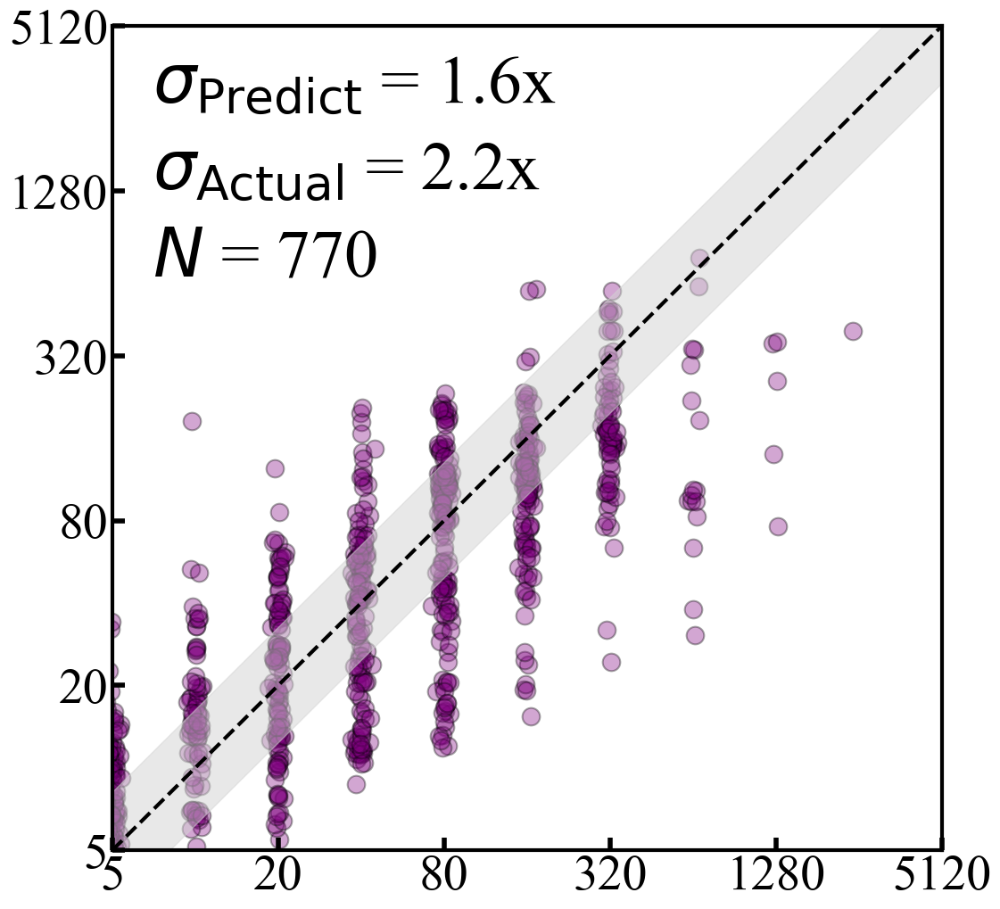

Figure saved to Figures\2024 Einav\train_all_datasets_test_2024 Einav.png


In [ ]:
parser  = DataSetNameParser()
builder = TrainTestIndexBuilder(parser)
index   = builder.build_train_test_index(
             "results/transferability",
             list(dataset_dict.keys())
         )

combiner = PredictionCombiner()

files_for_new = combiner.filter_files_for_test_and_train(
    index,
    test_dataset_name     = new_name,
    chosen_train_datasets = train_candidates   # or ALL existing train studies
)

combined_new = combiner.combine_subset_predictions(files_for_new, n_splits=1)

# ----- save digestible tables / excel -----
import pandas as pd, json, os
out_dir = f"results/combined/{new_name}"
os.makedirs(out_dir, exist_ok=True)
pd.DataFrame(combined_new).to_json(f"{out_dir}/combined_predictions.json", indent=2)

# ----- quick QC plot -----
plotter = PredictionPlotter(base_folder="Figures", dot_color=plum)
plotter.plot_combined_predictions(
    combined_results     = combined_new,
    dataset_name         = new_name,
    train_datasets_used  = train_candidates,
    all_train_datasets   = train_candidates
)


 Skipping '2016 Fox_HCW_2022 UGA_perf.json' (unparseable).
 Skipping '2019 UGA_2022 UGA_perf.json' (unparseable).
 Skipping '2020 UGA_2022 UGA_perf.json' (unparseable).
 Skipping '2021 UGA_2022 UGA_perf.json' (unparseable).
 Skipping '2023 Crotty_Afluria_2022 UGA_perf.json' (unparseable).
processed=61  negativeσ=1  skipped=0
processed=62  negativeσ=0  skipped=0
 61 viruses predicted by ALL 3 legs (train1, train2 → test):
{'H3N2 A/Townsville/4/2002', 'H3N2 A/Nanchang/933/1995', 'H3N2 A/Singapore/37/2004', 'H3N2 A/Christchurch/68/1999', 'H3N2 A/Wuhan/359/1995', 'H3N2 A/Netherlands/301/1999', 'H3N2 A/Victoria/110/2004', 'H3N2 A/Wisconsin/67/2005', 'H3N2 A/Victoria/208/2009', 'H3N2 A/Netherlands/213/2003', 'H3N2 A/South Australia/53/2001', 'H3N2 A/Victoria/577/1999', 'H3N2 A/Victoria/8/2010', 'H3N2 A/Perth/5/1997', 'H3N2 A/New York/55/2004', 'H3N2 A/Philippines/472/2002', 'H3N2 A/Brisbane/10/2007', 'H3N2 A/California/7/2004', 'H3N2 A/Auckland/5/1996', 'H3N2 A/Townsville/2/1999', 'H3N2 A/Fu

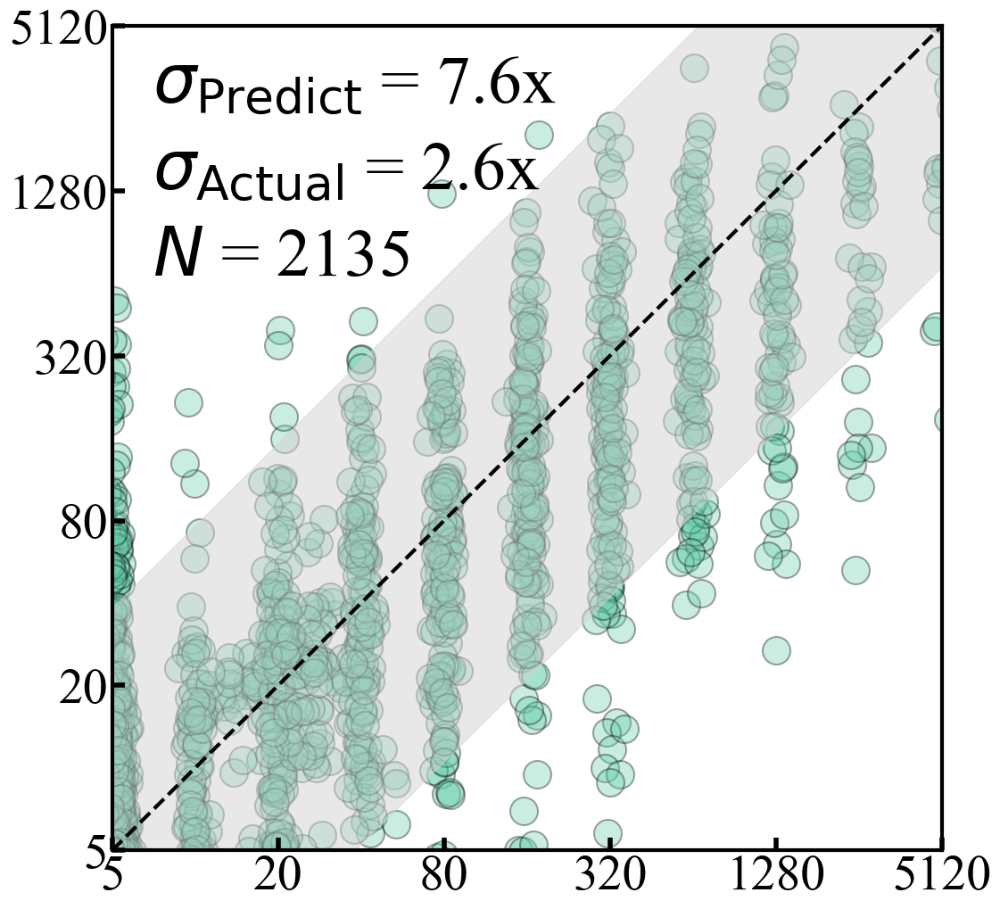

Figure saved to Figures\Panels\Fonv Ferret\train_1998 Fonv_test_Fonv Ferret.png
processed=62  negativeσ=0  skipped=0
Number of dataset entries for 'Fonv Ferret': 61
sigma_pred_logged (mean) = 2.916; => ~7.549× in raw domain.


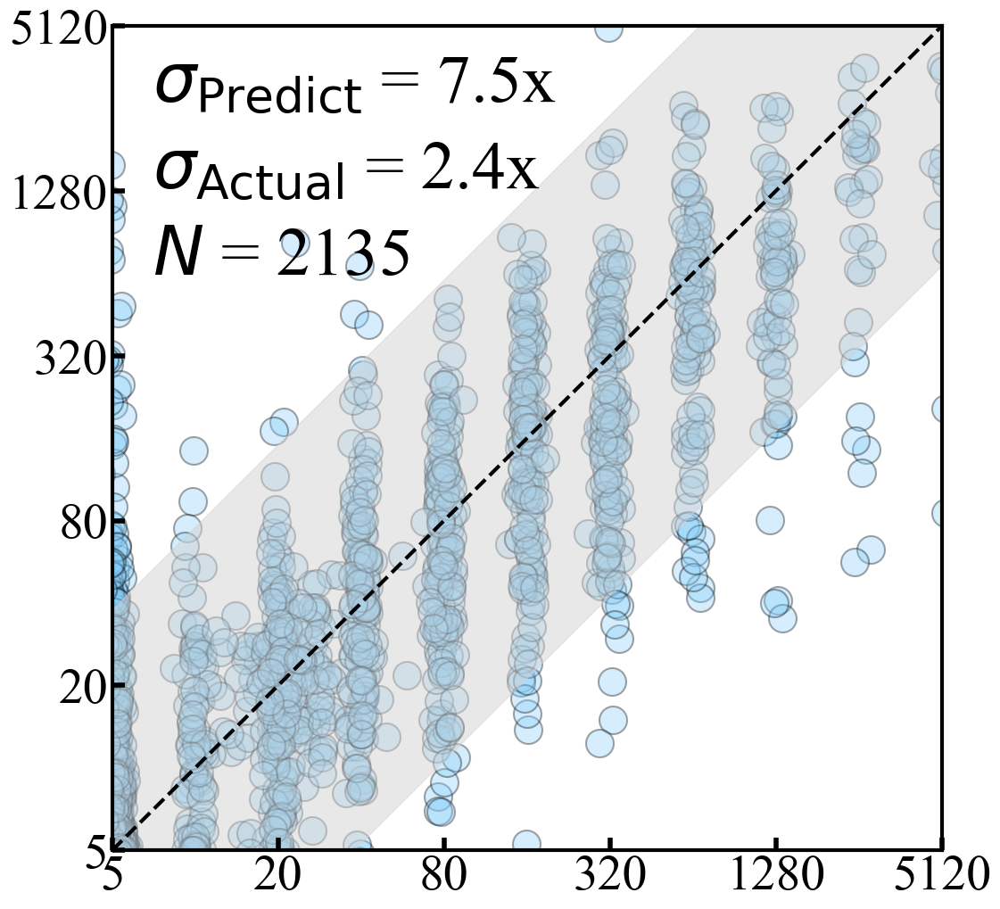

Figure saved to Figures\Panels\Fonv Ferret\train_1997 Fonv_test_Fonv Ferret.png
processed=123  negativeσ=1  skipped=0
Number of dataset entries for 'Fonv Ferret': 61
sigma_pred_logged (mean) = 1.971; => ~3.921× in raw domain.


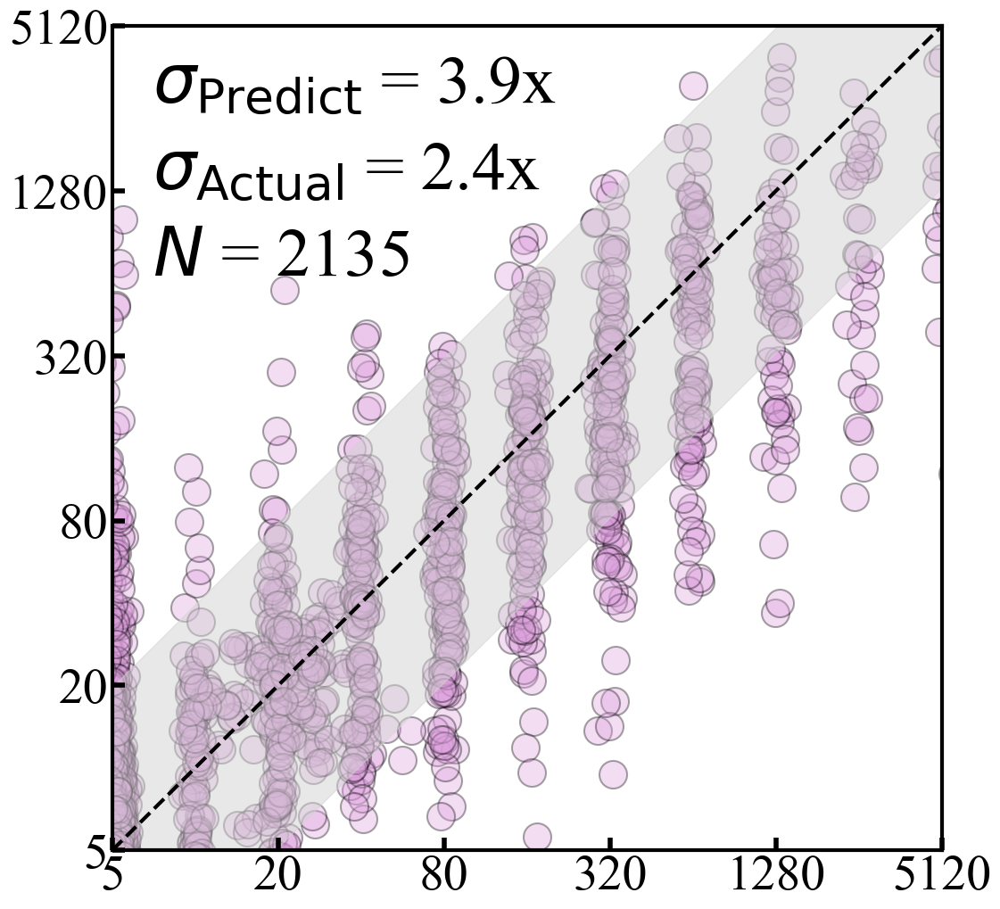

Figure saved to Figures\Panels\Fonv Ferret\train_1997 Fonv_1998 Fonv_test_Fonv Ferret.png


In [ ]:
# ──  0)  Imports / singletons  
from pathlib import Path
from Capybara.combining_predictions import (
    DataSetNameParser, TrainTestIndexBuilder,
    PredictionCombiner, PredictionPlotter, load_perf          # ← the universal reader
)

parser   = DataSetNameParser()
builder  = TrainTestIndexBuilder(parser)
combiner = PredictionCombiner()
plotter  = PredictionPlotter(jitter_strength=0.05,
                             dot_size=500,
                             annotation_font_size=55)

# 1) Choose which trainind and test datasets 
performance_folder = Path("results/transferability")       
test_ds = "Dataset Name"
train_ds_1 = "1998 Fonv"
train_ds_2 = "1997 Fonv"
chosen_trains = [train_ds_1, train_ds_2]
available_train_datasets = set([train for (train, test) in index.keys() if test == test_ds])
#  2)  Build the (train,test) → files index  
index = builder.build_train_test_index(performance_folder, list(dataset_dict.keys()))

# 3)  Helper: viruses predicted by each (train→test) 
def viruses_predicted(train_ds):
    files = combiner.filter_files_for_test_and_train(index, test_ds, [train_ds])
    if not files:
        return set(), []                      # no files on disk
    combined = combiner.combine_subset_predictions(files, n_splits=1)
    return {rec["Virus"] for rec in combined}, combined

# gather per-train virus sets + combined records
virus_sets   = {}
combined_map = {}
for tr in chosen_trains:
    vset, cmb = viruses_predicted(tr)
    virus_sets[tr]   = vset
    combined_map[tr] = cmb

# 4)  Triple-overlap
triple_overlap = set.intersection(*virus_sets.values())
print(f" {len(triple_overlap)} viruses predicted by ALL 3 legs (train1, train2 → test):")
print(triple_overlap)

# 5)  Plot per-train  
def plot_subset(subset_trains, color):
    files = combiner.filter_files_for_test_and_train(index, test_ds, subset_trains)
    combined = combiner.combine_subset_predictions(files, n_splits=1)
    combined = [r for r in combined if r["Virus"] in triple_overlap]
    if not combined:
        print(f" No overlap predictions for {subset_trains}")
        return
    plotter.dot_color = color
    plotter.plot_combined_predictions(
        combined,
        dataset_name=test_ds,
        train_datasets_used=subset_trains,
        all_train_datasets=available_train_datasets#set(chosen_trains),
    )

plot_subset([train_ds_1], "mediumaquamarine")
plot_subset([train_ds_2], "lightskyblue")

# ──  6)  Plot BOTH trains pooled  ───────────────────────────
plot_subset(chosen_trains, "plum")


## Run Recursive Feature Machine on each dataset separately to get selected viruses for each virus and dataset

In [3]:
analyzer = LaplaceRFMAnalyzer(dataset_dict)
virus_groups_all_datasets, importance_virus_groups = analyzer.run_analysis()


Laplace RFM on 1997 Fonv
Round 0, Test MSE: 0.7452
Using batch size of 1578880
Round 1, Test MSE: 0.7642
Using batch size of 1578880
Round 2, Test MSE: 0.7285
Using batch size of 1578880
Round 3, Test MSE: 0.7013
Using batch size of 1578880
Round 4, Test MSE: 0.6819
Using batch size of 1578880
Final MSE: 0.6736
Round 0, Test MSE: 0.6285
Using batch size of 1578880
Round 1, Test MSE: 0.6486
Using batch size of 1578880
Round 2, Test MSE: 0.6655
Using batch size of 1578880
Round 3, Test MSE: 0.6673
Using batch size of 1578880
Round 4, Test MSE: 0.6701
Using batch size of 1578880
Final MSE: 0.6716
Round 0, Test MSE: 0.5068
Using batch size of 1578880
Round 1, Test MSE: 0.4831
Using batch size of 1578880
Round 2, Test MSE: 0.4907
Using batch size of 1578880
Round 3, Test MSE: 0.4940
Using batch size of 1578880
Round 4, Test MSE: 0.4960
Using batch size of 1578880
Final MSE: 0.4968
Round 0, Test MSE: 0.4529
Using batch size of 1578880
Round 1, Test MSE: 0.3636
Using batch size of 1578880
Rou

In [6]:
# Set output folder
output_folder = Path("results")
output_folder.mkdir(parents=True, exist_ok=True)

from Capybara.utils import dump_json

dump_json(output_folder / "virus_groups_all_datasets.json", virus_groups_all_datasets)
dump_json(output_folder / "importance_virus_groups.json", importance_virus_groups)


In [7]:
from Capybara.utils import load_json

combined_groups_dict = load_json("results/virus_groups_all_datasets.json")
importance_dict = load_json("results/importance_virus_groups.json")


In [7]:
ridge_trainer = RidgeTrainer(
    groups_dict=groups_dict,
    importance_dict=importance_dict,
    dataset_dict=dataset_dict
)
prediction_results = ridge_trainer.run()


## Run RFM on all overlapping viruses other than target virus to get selected viruses

In [ ]:
from Capybara.pipeline import RFMGroupAnalysis

# Instantiate the analysis object
rfm_loo = RFMGroupAnalysis(results_dir="results/leave_one_out_RFM")  
# Run it
rfm_loo.run(dataset_dict, overwrite=False)


1997 Fonv → 1998 Fonv already done
Round 0, Test MSE: 0.4747
Using batch size of 1579008
Round 1, Test MSE: 0.3424
Using batch size of 1579008
Round 2, Test MSE: 0.3470
Using batch size of 1579008
Round 3, Test MSE: 0.3486
Using batch size of 1579008
Round 4, Test MSE: 0.3488
Using batch size of 1579008
Final MSE: 0.3488
Round 0, Test MSE: 0.5681
Using batch size of 1579008
Round 1, Test MSE: 0.4701
Using batch size of 1579008
Round 2, Test MSE: 0.4913
Using batch size of 1579008
Round 3, Test MSE: 0.4962
Using batch size of 1579008
Round 4, Test MSE: 0.4967
Using batch size of 1579008
Final MSE: 0.4967
Round 0, Test MSE: 0.8586
Using batch size of 1579008
Round 1, Test MSE: 0.8649
Using batch size of 1579008
Round 2, Test MSE: 0.8636
Using batch size of 1579008
Round 3, Test MSE: 0.8631
Using batch size of 1579008
Round 4, Test MSE: 0.8630
Using batch size of 1579008
Final MSE: 0.8630
Round 0, Test MSE: 0.1773
Using batch size of 1579008
Round 1, Test MSE: 0.1843
Using batch size of 1

## Run Transferability Part of CAPYBARA
Get pairwise predictions and sigma predict for each dataset pair, each overlapping virus

In [ ]:
# Now run TransferabilityAnalysis
transferability = TransferabilityAnalysis()
transferability.run_transferability_analysis(
    dataset_dict=dataset_dict,
    combined_virus_groups_dict_path="results/virus_groups_all_datasets.json",
    loo_folder="results/leave_one_out_RFM/groups",
    performance_folder="results/transferability",
    n_splits=5
)

[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Beijing/32/1992
[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Brisbane/342/2003
[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Sydney/5/1997
[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Victoria/47/1997
[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Victoria/9/1994
[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Auckland/5/1996
[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Brisbane/22/1994
[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Brisbane/5/2002
[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Wellington/1/2004
[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Nanchang/933/1995
[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Tasmania/1/1997
[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Wellington/48/1996
[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Auckland/20/2003
[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Victoria/208/2009
[LOO] 1997 Fonv → 1998 Fonv   left-out = H3N2 A/Canberra/9/1997
[LOO] 1997 Fonv → 1998 Fonv 

## Get Combined Predictions and Plots for all Datasets

processed=290  negativeσ=6  skipped=0
Number of dataset entries for '1997 Fonv': 69
sigma_pred_logged (mean) = 0.635; => ~1.553× in raw domain.


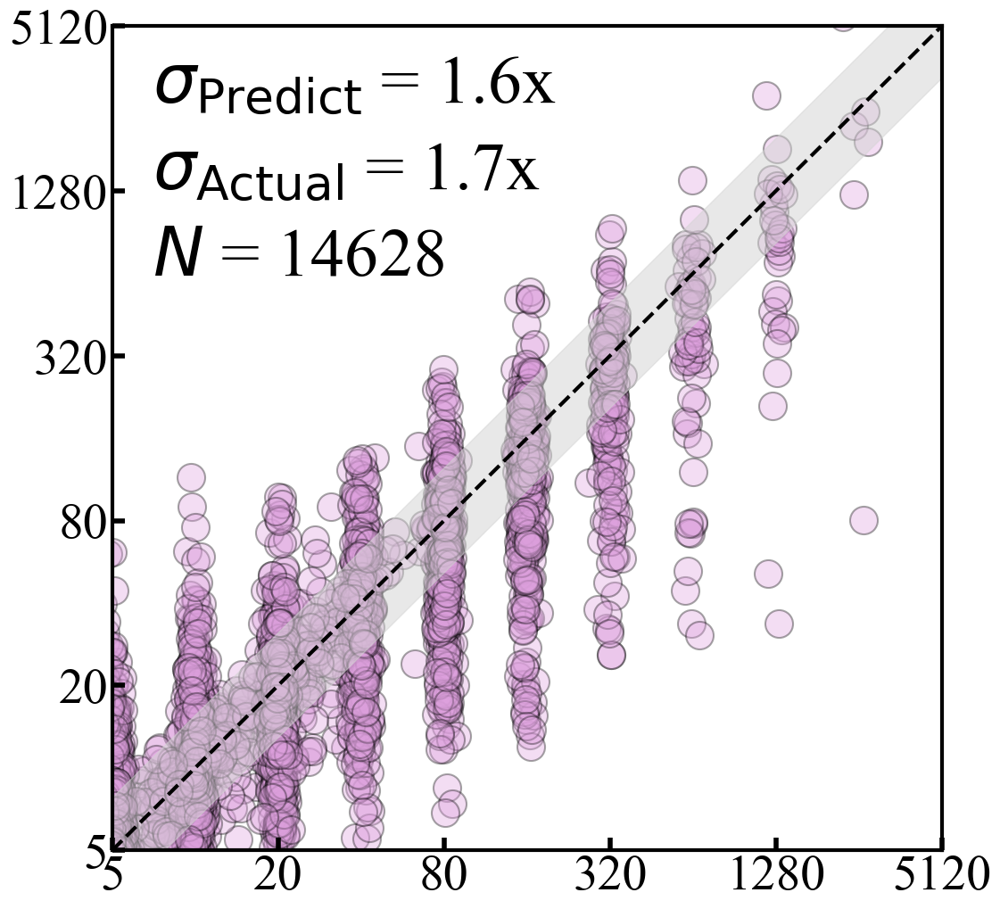

Figure saved to Figures\Panels\1997 Fonv\train_all_datasets_test_1997 Fonv.png
processed=289  negativeσ=7  skipped=0
Number of dataset entries for '1998 Fonv': 69
sigma_pred_logged (mean) = 0.652; => ~1.571× in raw domain.


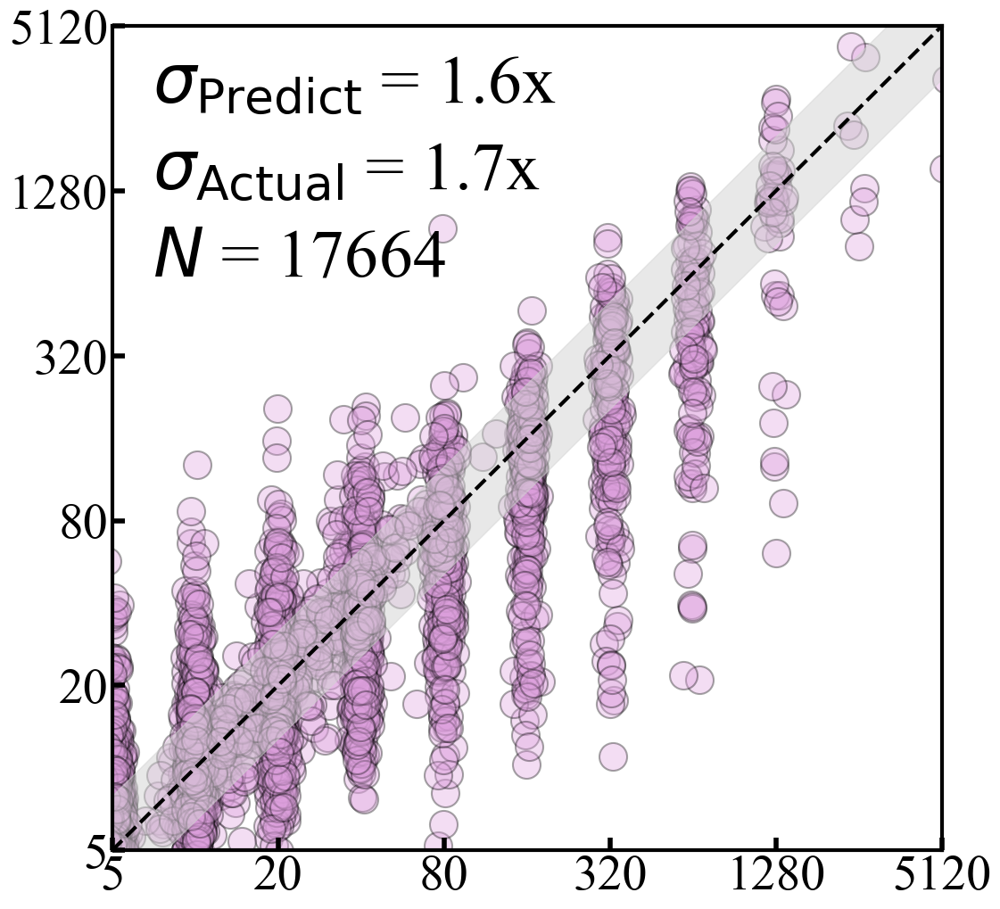

Figure saved to Figures\Panels\1998 Fonv\train_all_datasets_test_1998 Fonv.png
processed=167  negativeσ=7  skipped=0
Number of dataset entries for '2007-2011 Fonv Infect': 32
sigma_pred_logged (mean) = 0.878; => ~1.838× in raw domain.


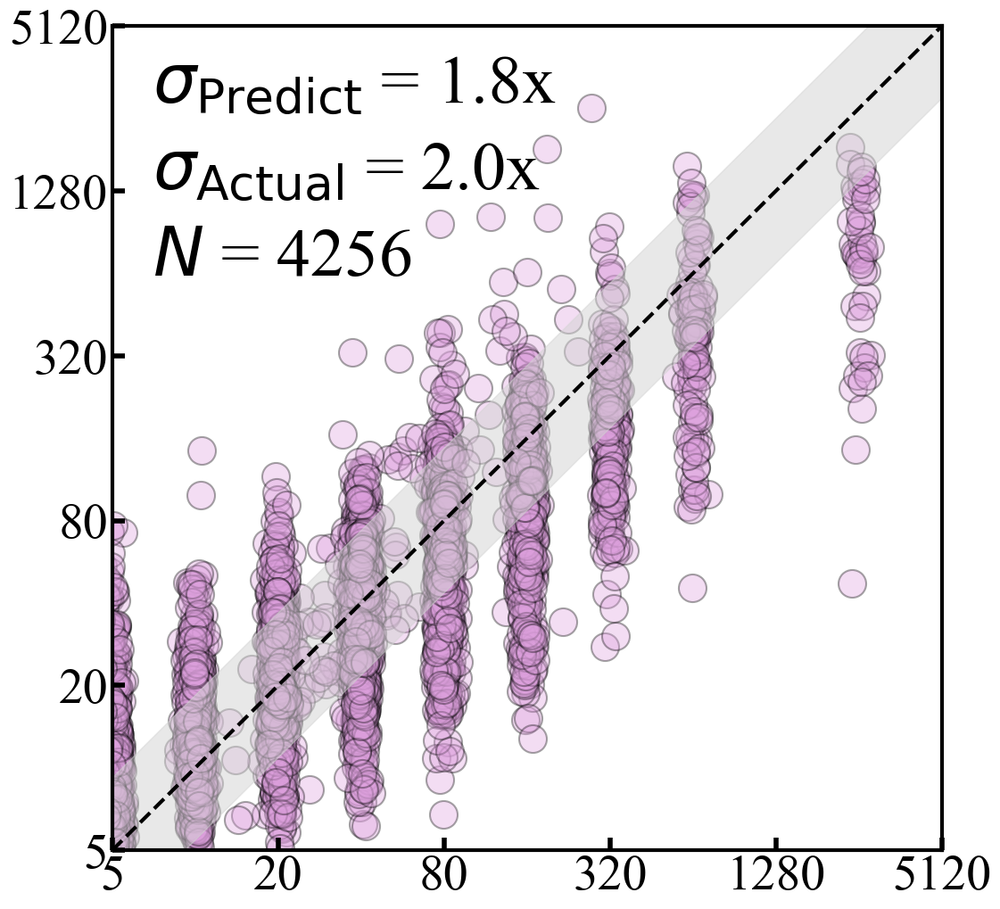

Figure saved to Figures\Panels\2007-2011 Fonv Infect\train_all_datasets_test_2007-2011 Fonv Infect.png
processed=183  negativeσ=2  skipped=0
Number of dataset entries for '2007-2012 Fonv Infect': 37
sigma_pred_logged (mean) = 0.724; => ~1.652× in raw domain.


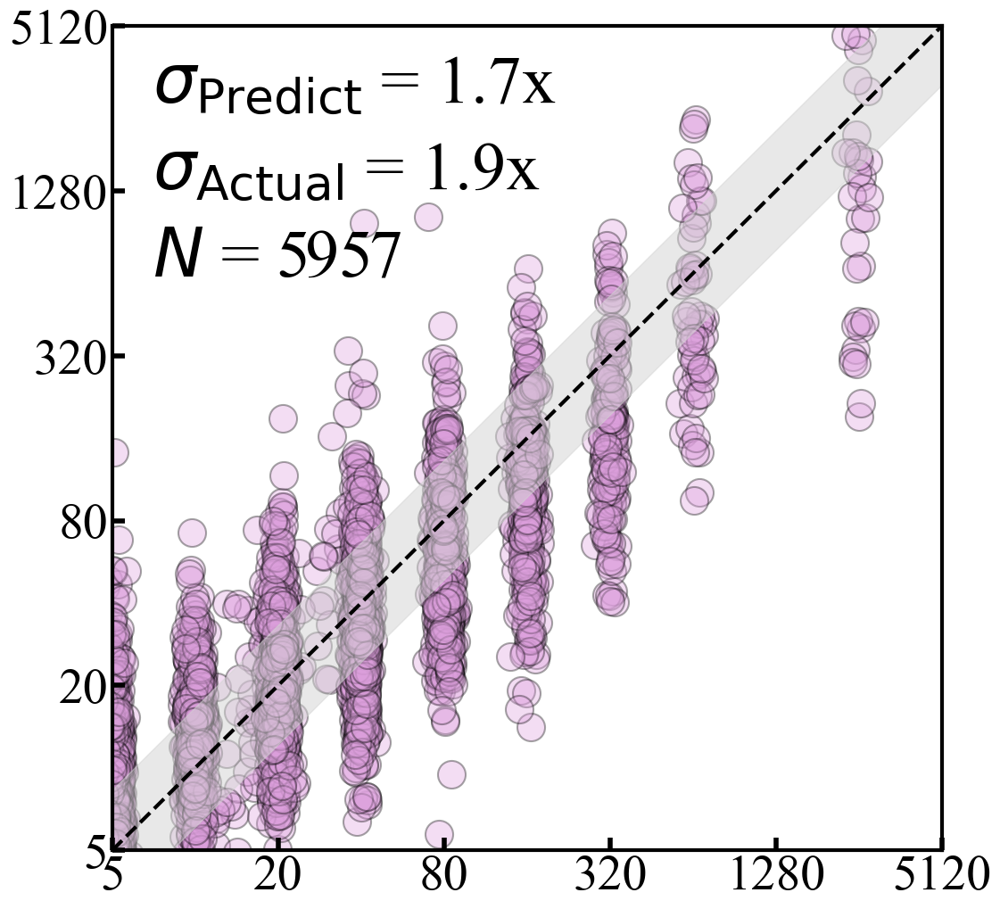

Figure saved to Figures\Panels\2007-2012 Fonv Infect\train_all_datasets_test_2007-2012 Fonv Infect.png
processed=91  negativeσ=2  skipped=0
Number of dataset entries for '2009 Fonv': 20
sigma_pred_logged (mean) = 0.600; => ~1.516× in raw domain.


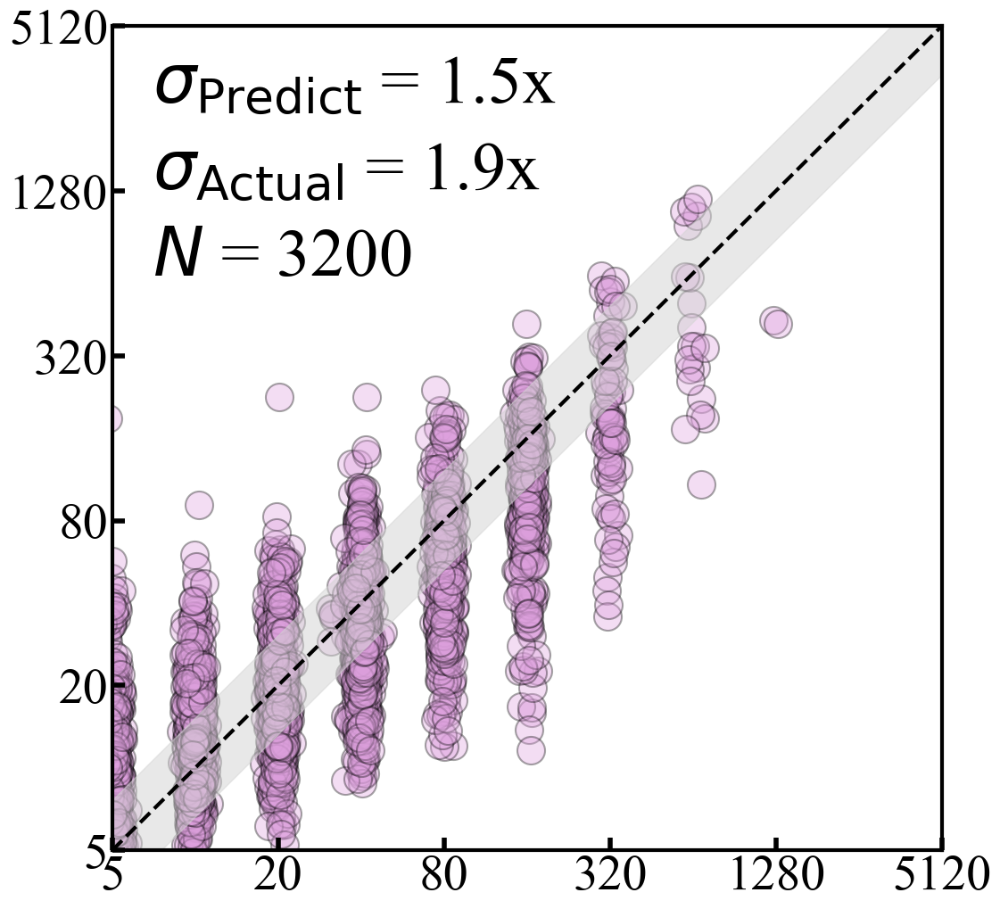

Figure saved to Figures\Panels\2009 Fonv\train_all_datasets_test_2009 Fonv.png
processed=127  negativeσ=5  skipped=0
Number of dataset entries for '2009-2011 Hay Infect': 20
sigma_pred_logged (mean) = 0.474; => ~1.389× in raw domain.


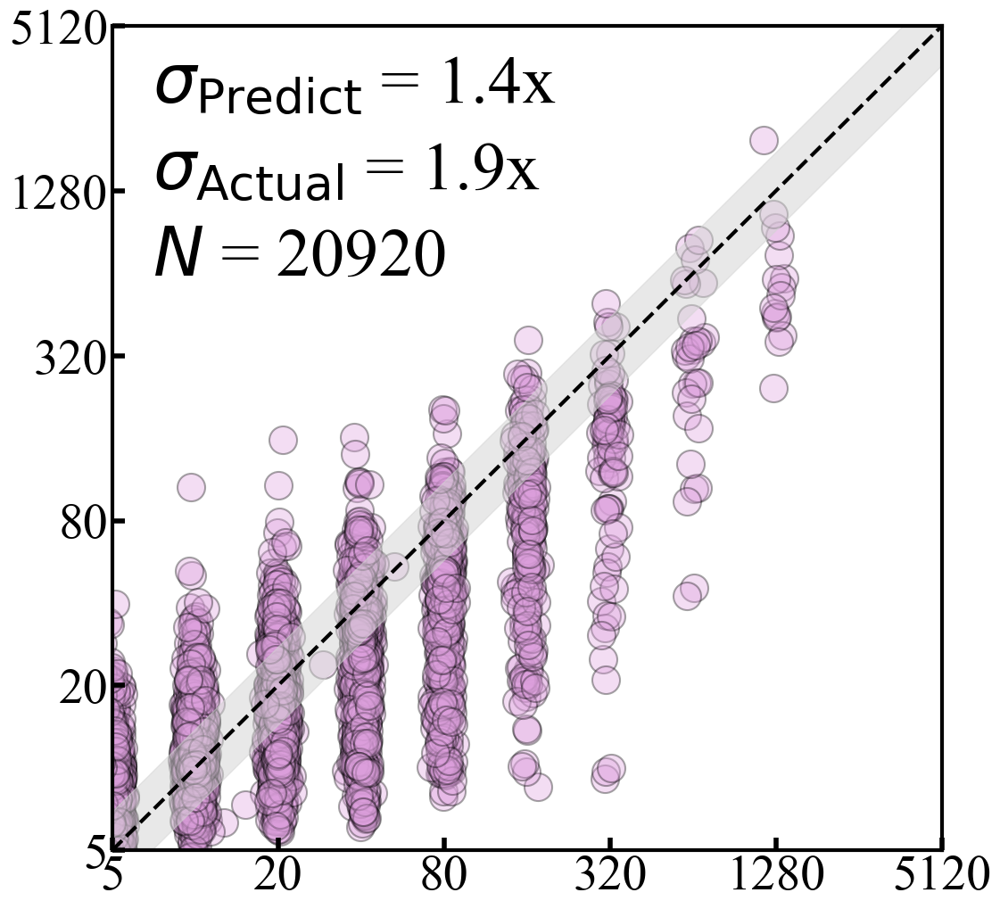

Figure saved to Figures\Panels\2009-2011 Hay Infect\train_all_datasets_test_2009-2011 Hay Infect.png
processed=109  negativeσ=4  skipped=0
Number of dataset entries for '2010 Ertesvag_IIV': 14
sigma_pred_logged (mean) = 0.580; => ~1.495× in raw domain.


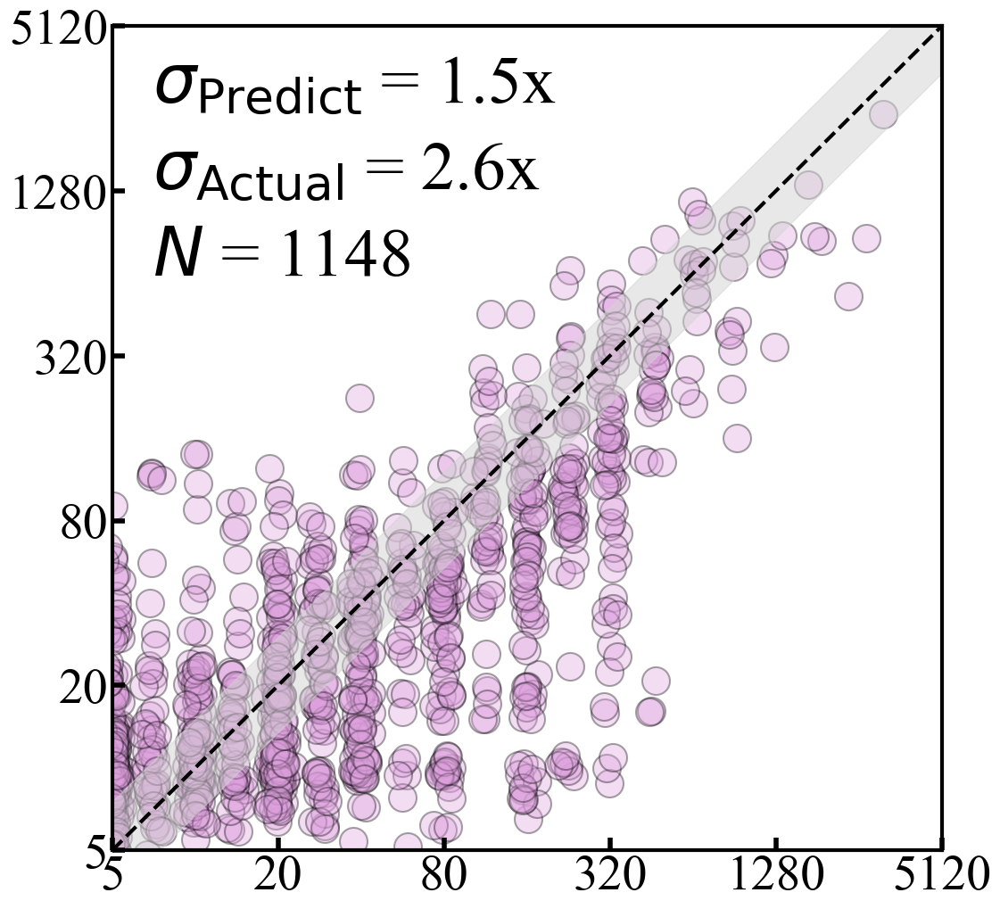

Figure saved to Figures\Panels\2010 Ertesvag_IIV\train_all_datasets_test_2010 Ertesvag_IIV.png
processed=91  negativeσ=2  skipped=0
Number of dataset entries for '2010 Fonv': 20
sigma_pred_logged (mean) = 0.614; => ~1.530× in raw domain.


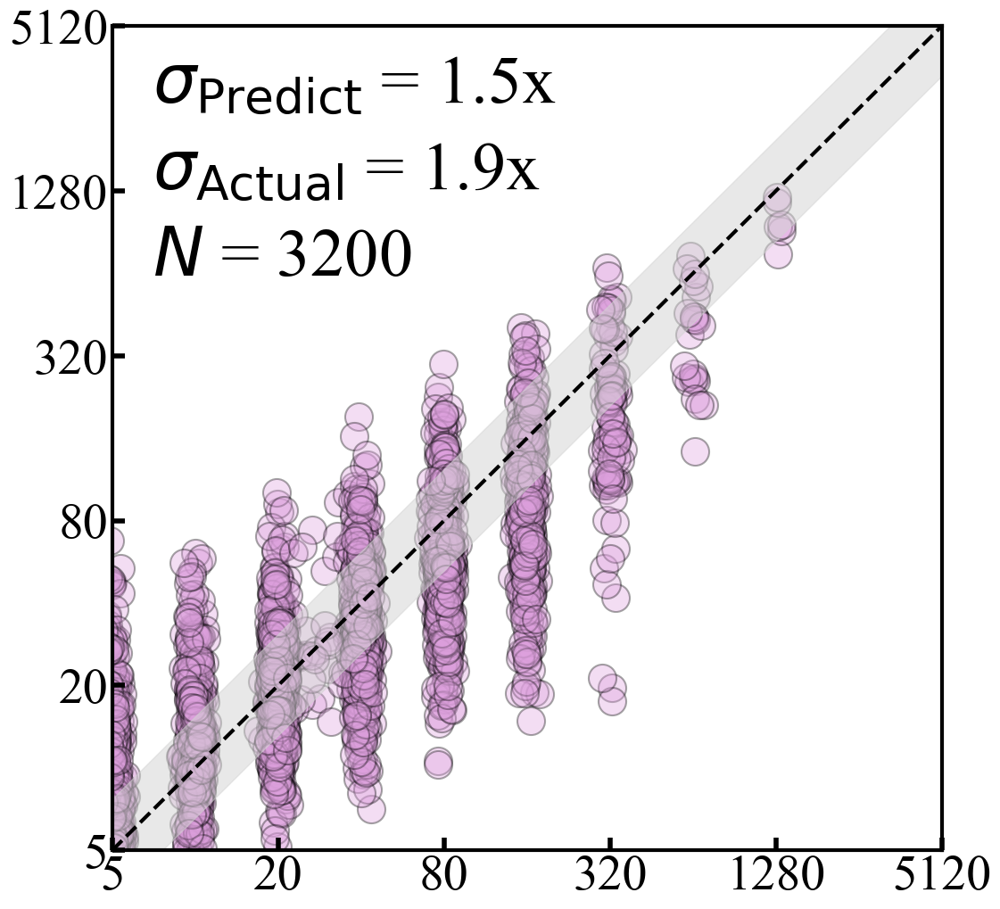

Figure saved to Figures\Panels\2010 Fonv\train_all_datasets_test_2010 Fonv.png
processed=110  negativeσ=3  skipped=0
Number of dataset entries for '2012 Ertesvag_LAIV': 14
sigma_pred_logged (mean) = 0.394; => ~1.314× in raw domain.


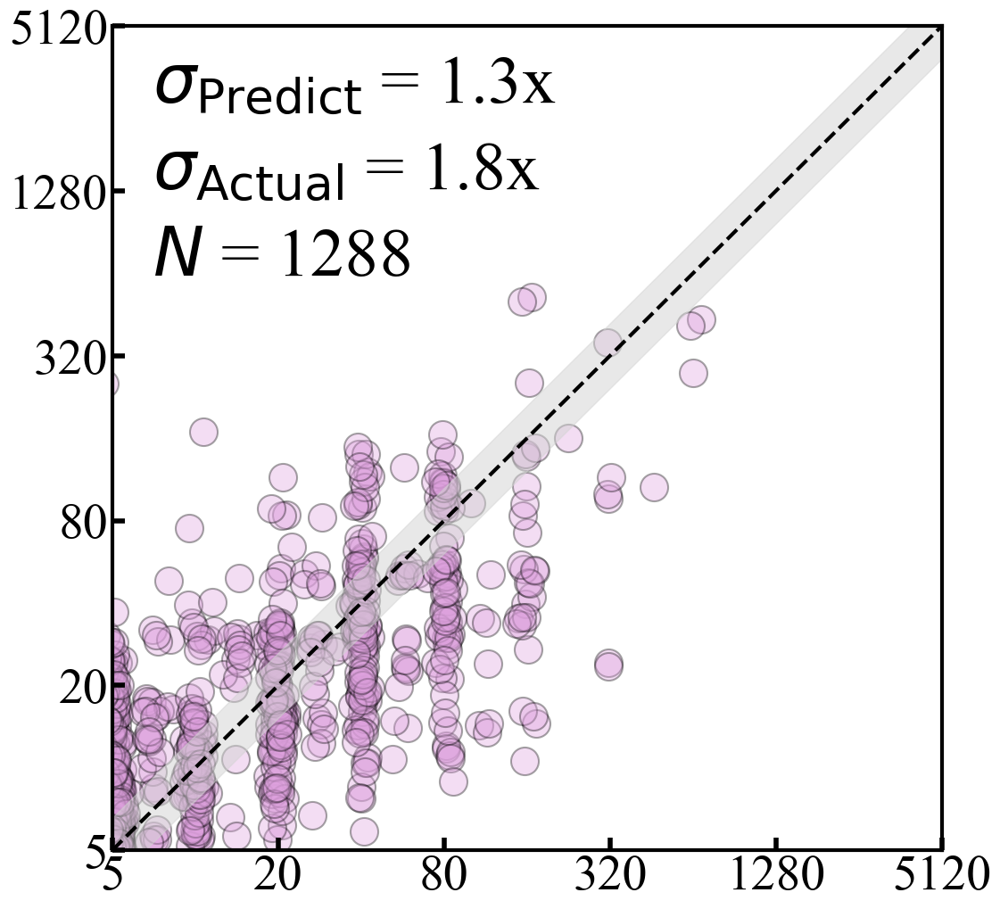

Figure saved to Figures\Panels\2012 Ertesvag_LAIV\train_all_datasets_test_2012 Ertesvag_LAIV.png
processed=128  negativeσ=4  skipped=0
Number of dataset entries for '2012-2015 Hay Infect': 20
sigma_pred_logged (mean) = 0.462; => ~1.378× in raw domain.


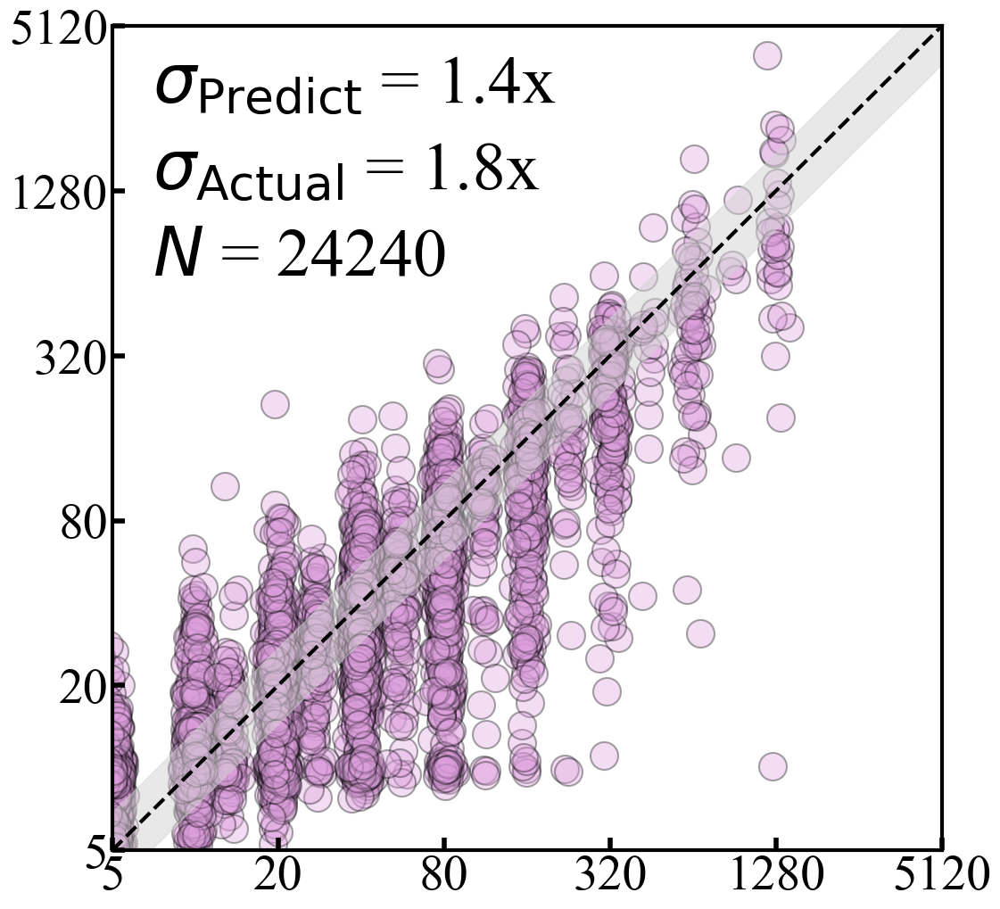

Figure saved to Figures\Panels\2012-2015 Hay Infect\train_all_datasets_test_2012-2015 Hay Infect.png
processed=110  negativeσ=3  skipped=0
Number of dataset entries for '2013 Ertesvag_IIV': 14
sigma_pred_logged (mean) = 0.484; => ~1.399× in raw domain.


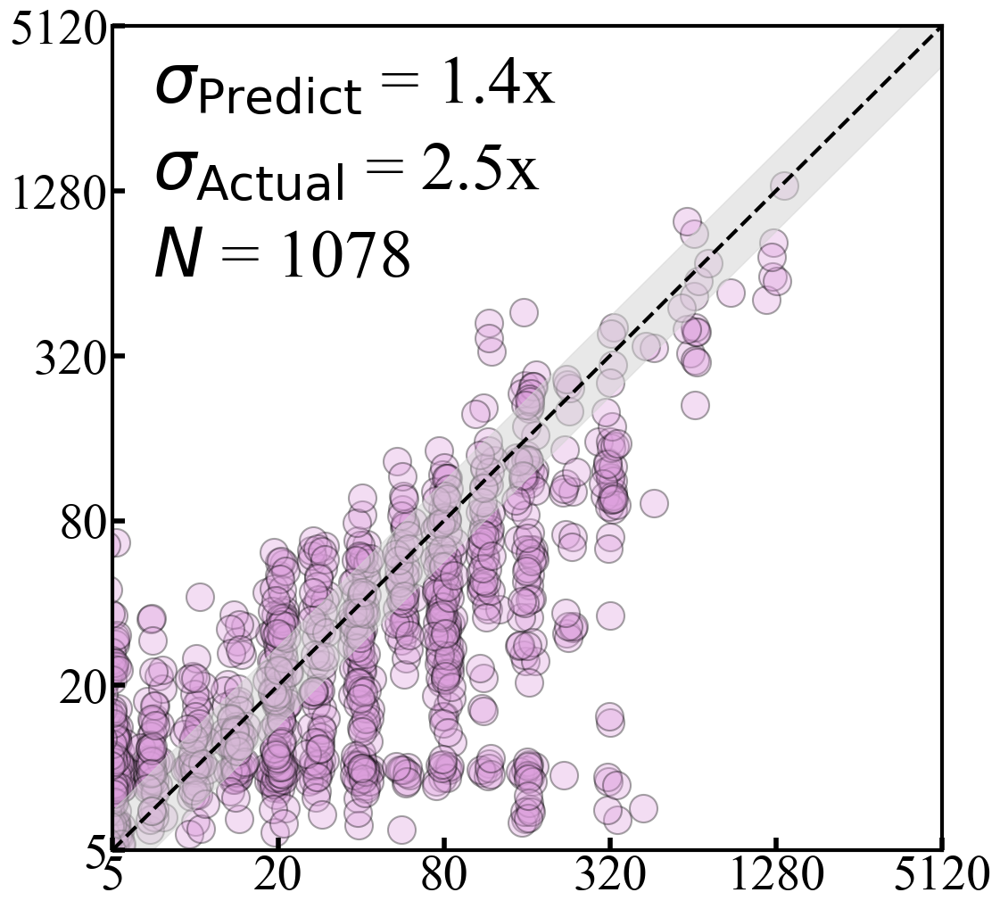

Figure saved to Figures\Panels\2013 Ertesvag_IIV\train_all_datasets_test_2013 Ertesvag_IIV.png
processed=107  negativeσ=6  skipped=0
Number of dataset entries for '2013 Ertesvag_LAIV': 14
sigma_pred_logged (mean) = 0.416; => ~1.334× in raw domain.


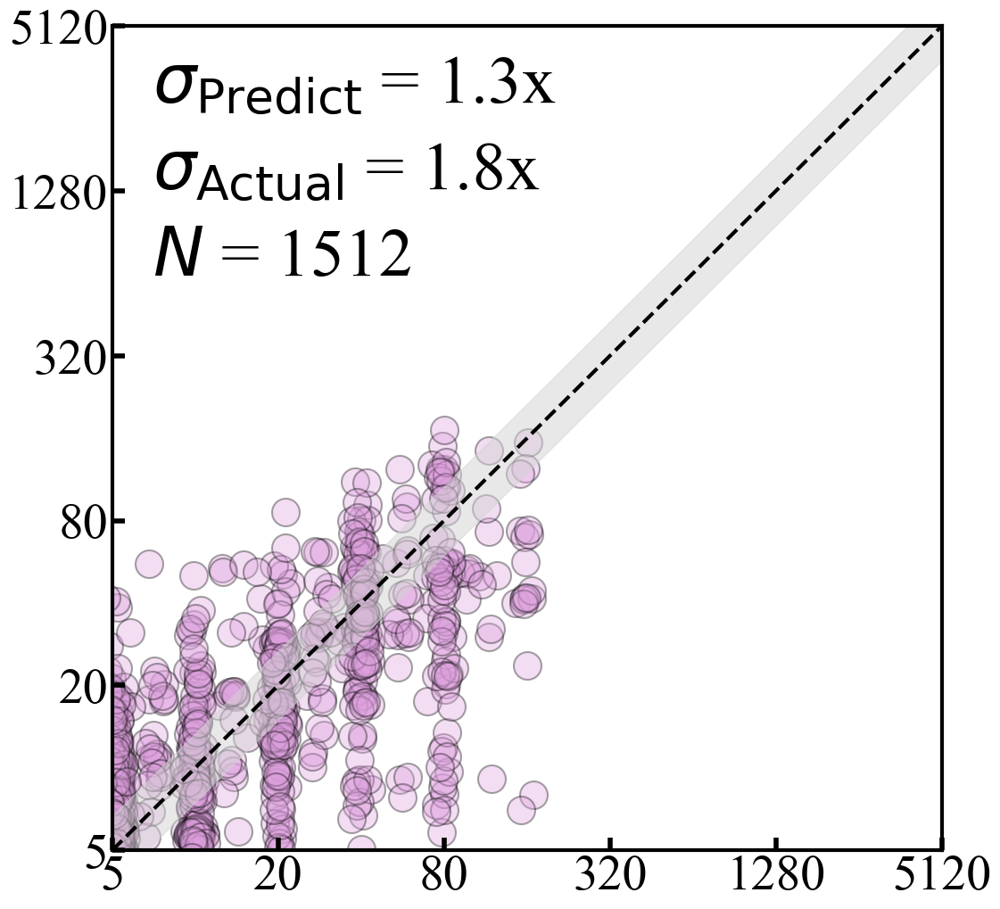

Figure saved to Figures\Panels\2013 Ertesvag_LAIV\train_all_datasets_test_2013 Ertesvag_LAIV.png
processed=120  negativeσ=4  skipped=0
Number of dataset entries for '2014 Hin_V': 16
sigma_pred_logged (mean) = 0.486; => ~1.400× in raw domain.


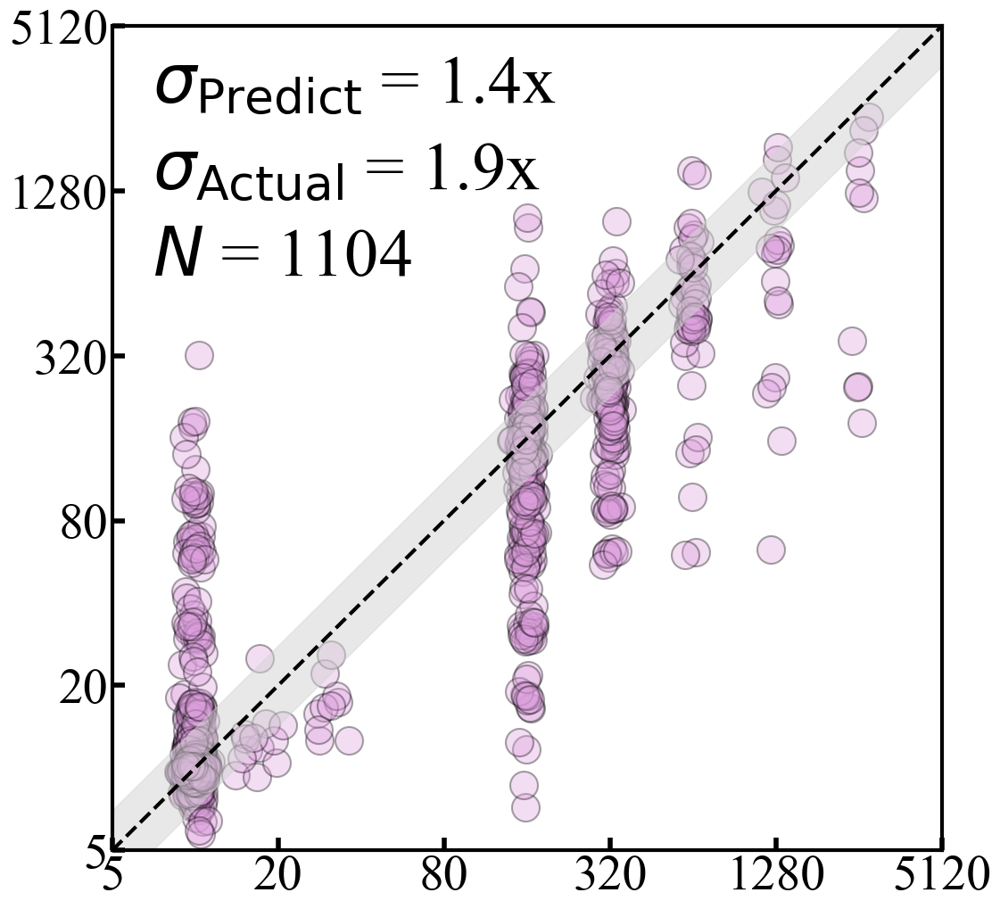

Figure saved to Figures\Panels\2014 Hin_V\train_all_datasets_test_2014 Hin_V.png
processed=123  negativeσ=1  skipped=0
Number of dataset entries for '2015 Hin_U': 16
sigma_pred_logged (mean) = 0.486; => ~1.401× in raw domain.


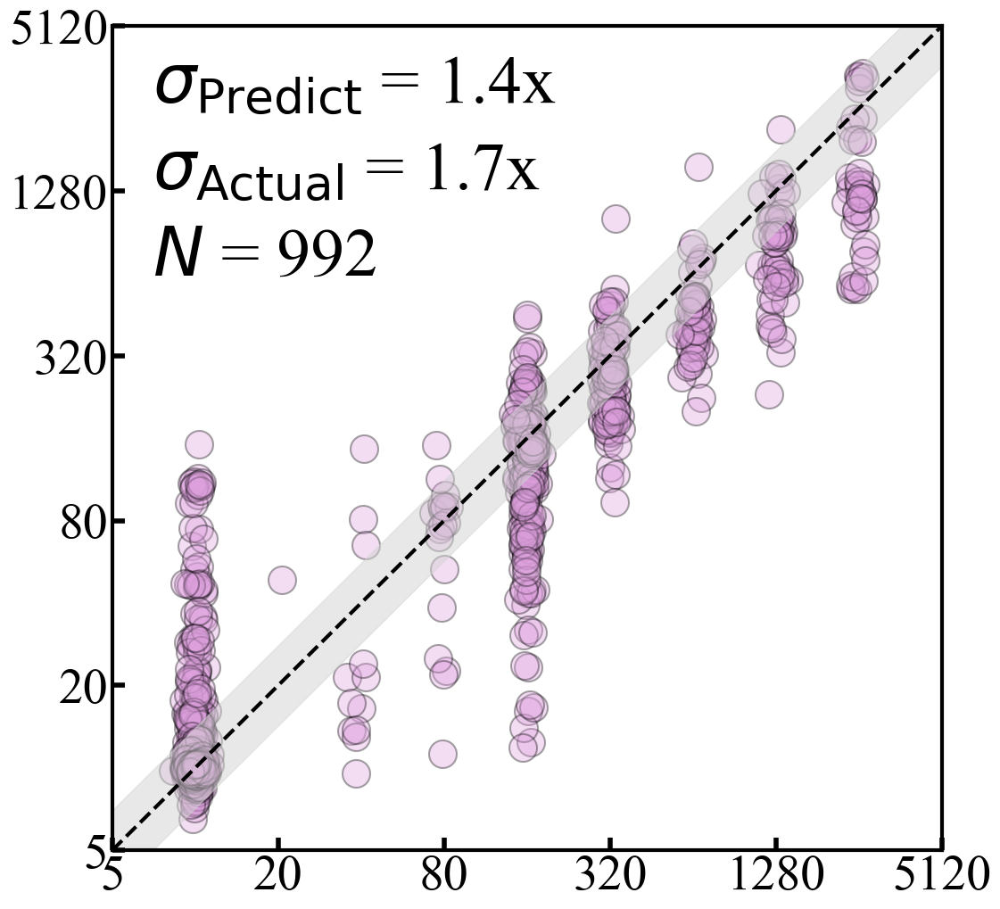

Figure saved to Figures\Panels\2015 Hin_U\train_all_datasets_test_2015 Hin_U.png
processed=121  negativeσ=3  skipped=0
Number of dataset entries for '2015 Hin_V': 16
sigma_pred_logged (mean) = 0.502; => ~1.416× in raw domain.


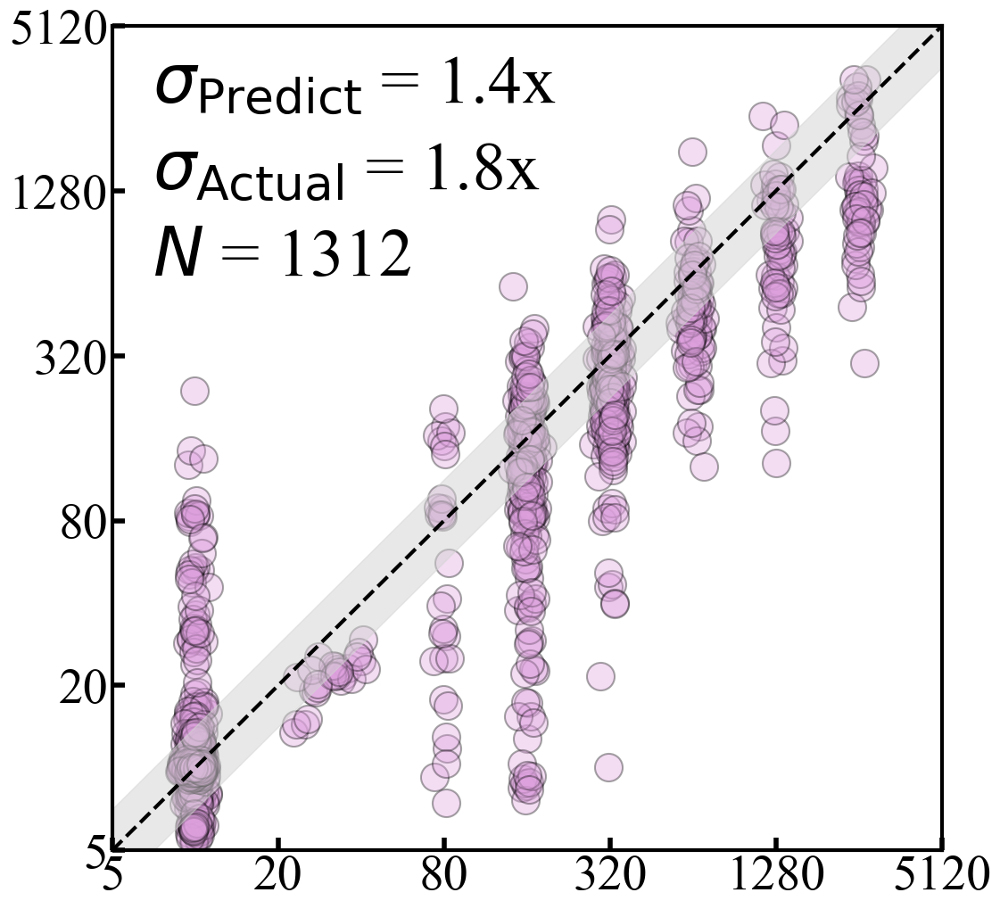

Figure saved to Figures\Panels\2015 Hin_V\train_all_datasets_test_2015 Hin_V.png
processed=188  negativeσ=8  skipped=0
Number of dataset entries for '2016 Fox_HCW': 32
sigma_pred_logged (mean) = 0.738; => ~1.667× in raw domain.


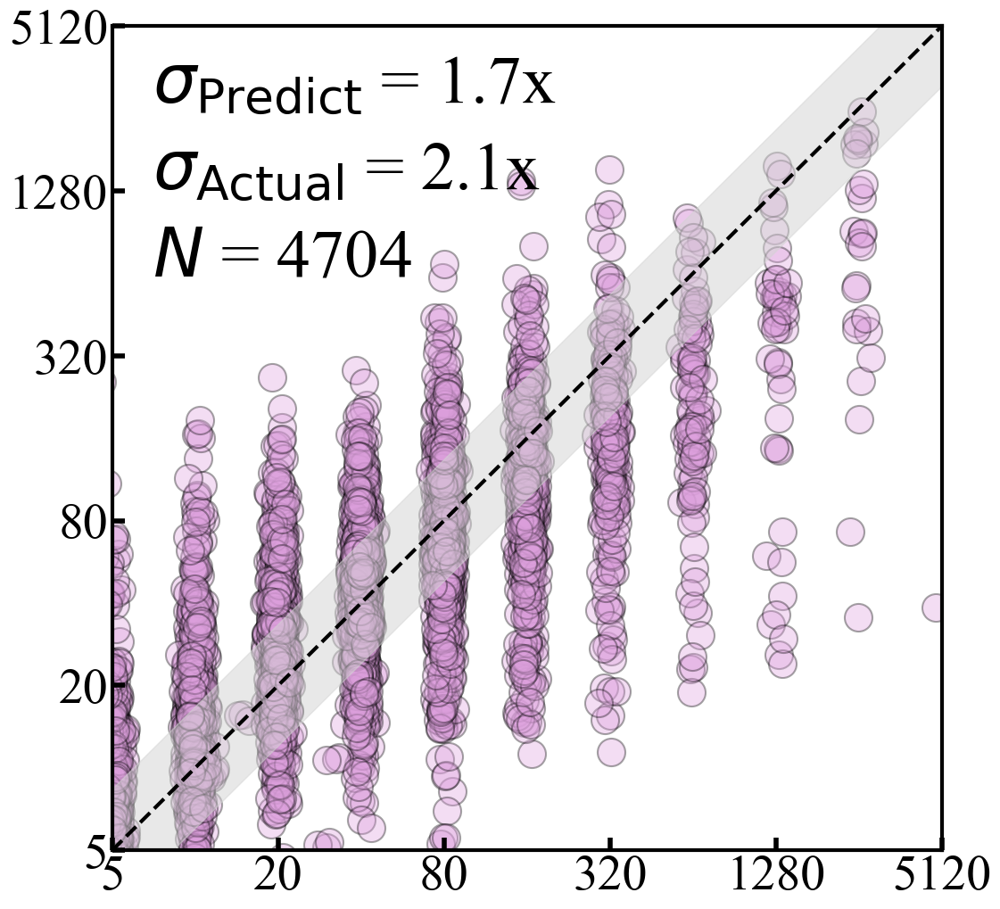

Figure saved to Figures\Panels\2016 Fox_HCW\train_all_datasets_test_2016 Fox_HCW.png
processed=183  negativeσ=6  skipped=0
Number of dataset entries for '2016 Fox_Nam': 34
sigma_pred_logged (mean) = 0.912; => ~1.882× in raw domain.


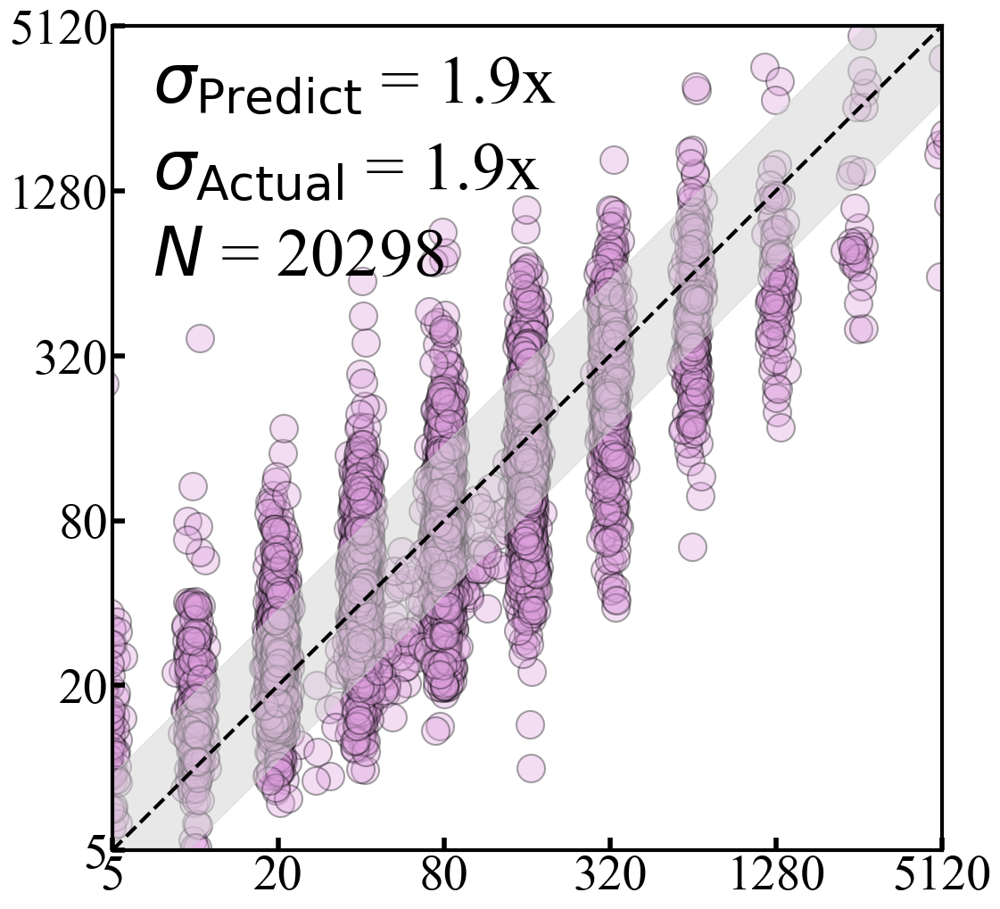

Figure saved to Figures\Panels\2016 Fox_Nam\train_all_datasets_test_2016 Fox_Nam.png
processed=125  negativeσ=8  skipped=0
Number of dataset entries for '2016 UGA': 17
sigma_pred_logged (mean) = 0.671; => ~1.592× in raw domain.


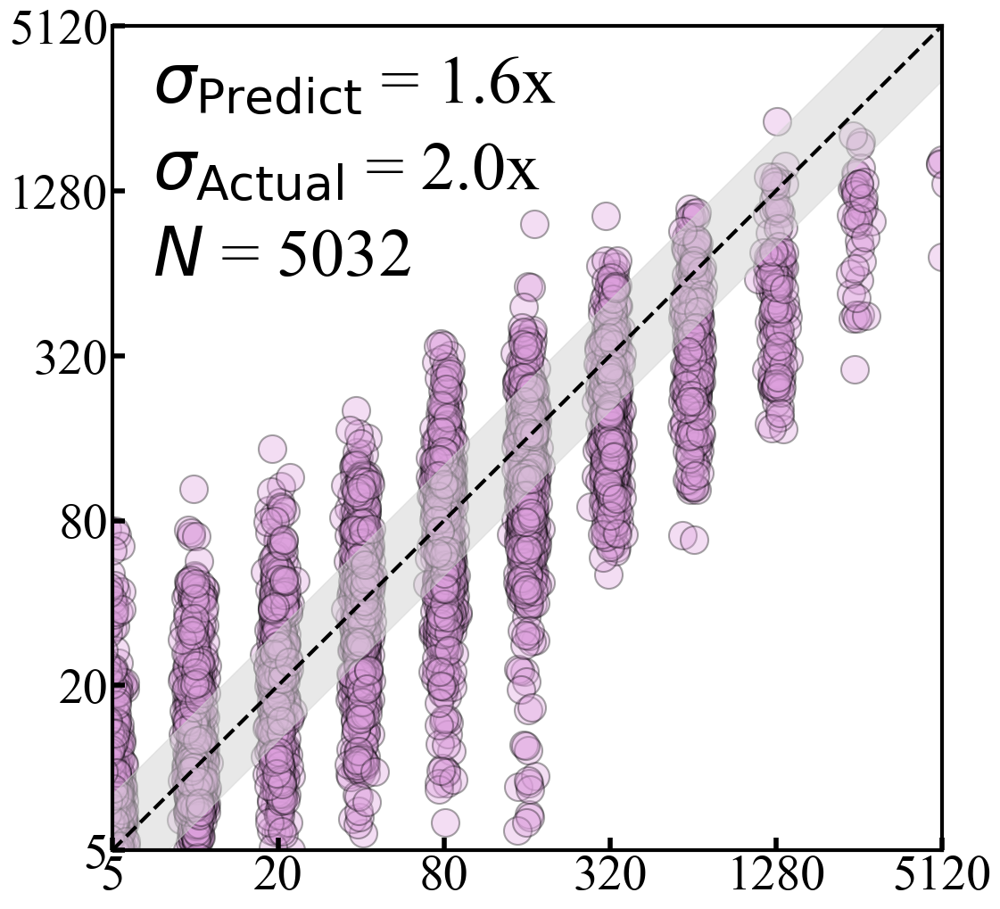

Figure saved to Figures\Panels\2016 UGA\train_all_datasets_test_2016 UGA.png
processed=132  negativeσ=5  skipped=0
Number of dataset entries for '2017 UGA': 18
sigma_pred_logged (mean) = 0.655; => ~1.575× in raw domain.


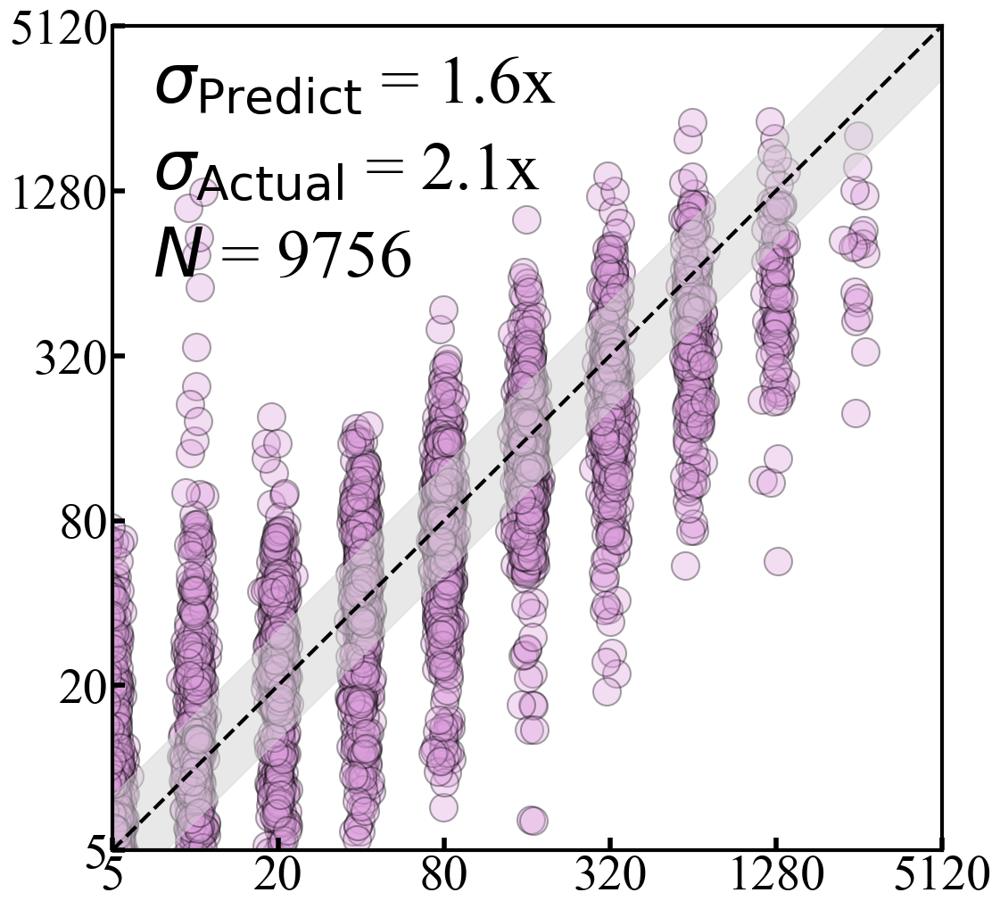

Figure saved to Figures\Panels\2017 UGA\train_all_datasets_test_2017 UGA.png
processed=97  negativeσ=3  skipped=0
Number of dataset entries for '2018 UGA': 10
sigma_pred_logged (mean) = 0.536; => ~1.450× in raw domain.


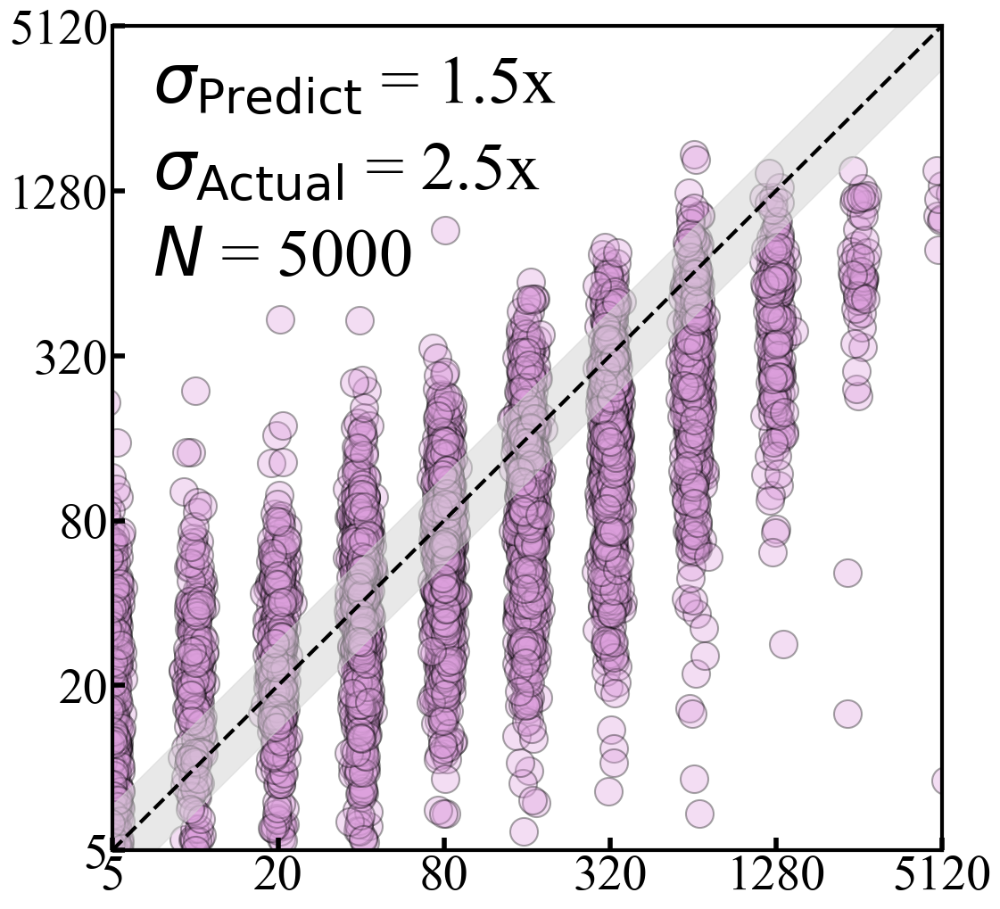

Figure saved to Figures\Panels\2018 UGA\train_all_datasets_test_2018 UGA.png
processed=37  negativeσ=4  skipped=0
Number of dataset entries for '2019 UGA': 7
sigma_pred_logged (mean) = 0.827; => ~1.774× in raw domain.


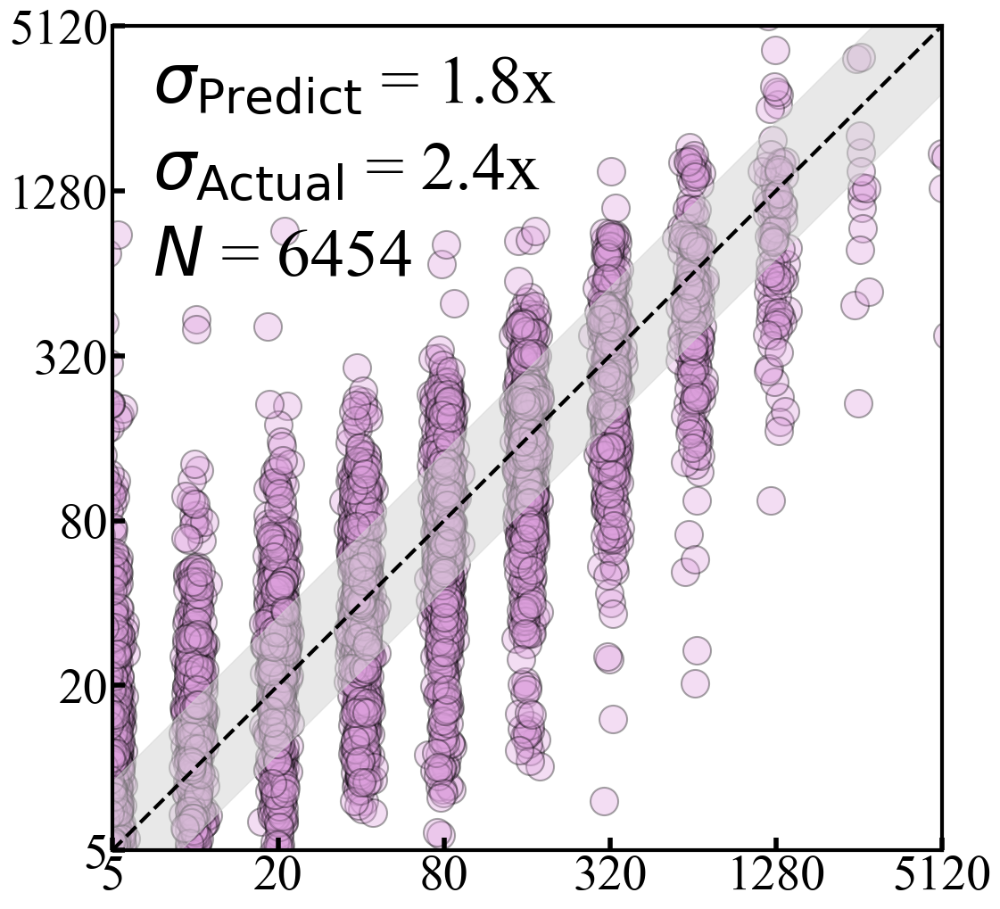

Figure saved to Figures\Panels\2019 UGA\train_all_datasets_test_2019 UGA.png
processed=21  negativeσ=1  skipped=0
Number of dataset entries for '2020 UGA': 7
sigma_pred_logged (mean) = 1.118; => ~2.170× in raw domain.


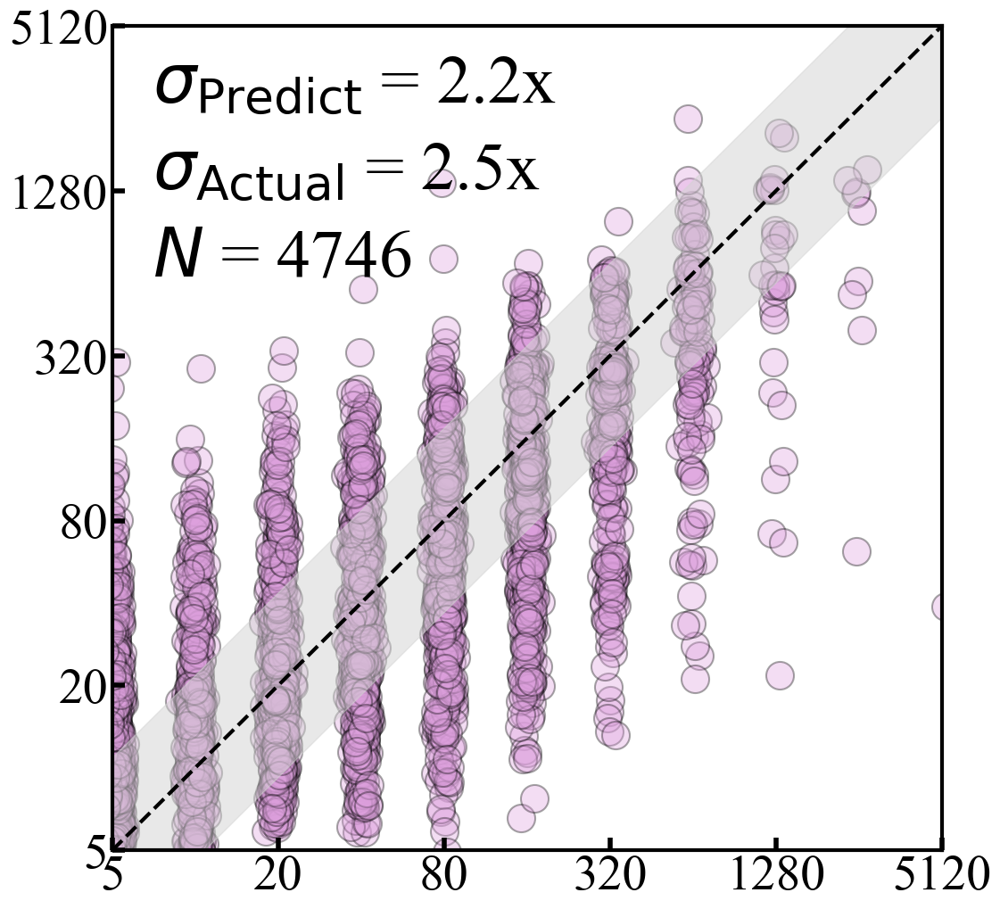

Figure saved to Figures\Panels\2020 UGA\train_all_datasets_test_2020 UGA.png
processed=20  negativeσ=2  skipped=0
Number of dataset entries for '2021 UGA': 7
sigma_pred_logged (mean) = 0.971; => ~1.960× in raw domain.


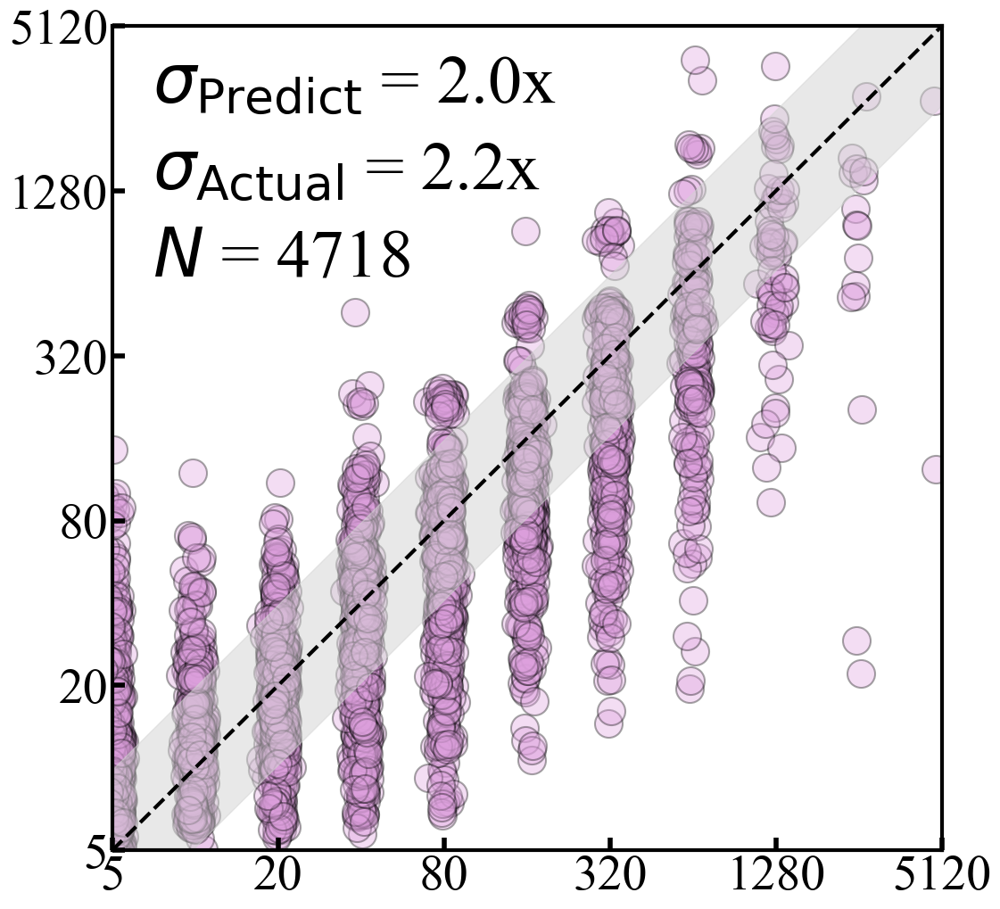

Figure saved to Figures\Panels\2021 UGA\train_all_datasets_test_2021 UGA.png
processed=20  negativeσ=2  skipped=0
Number of dataset entries for '2023 Crotty_Afluria': 7
sigma_pred_logged (mean) = 0.680; => ~1.602× in raw domain.


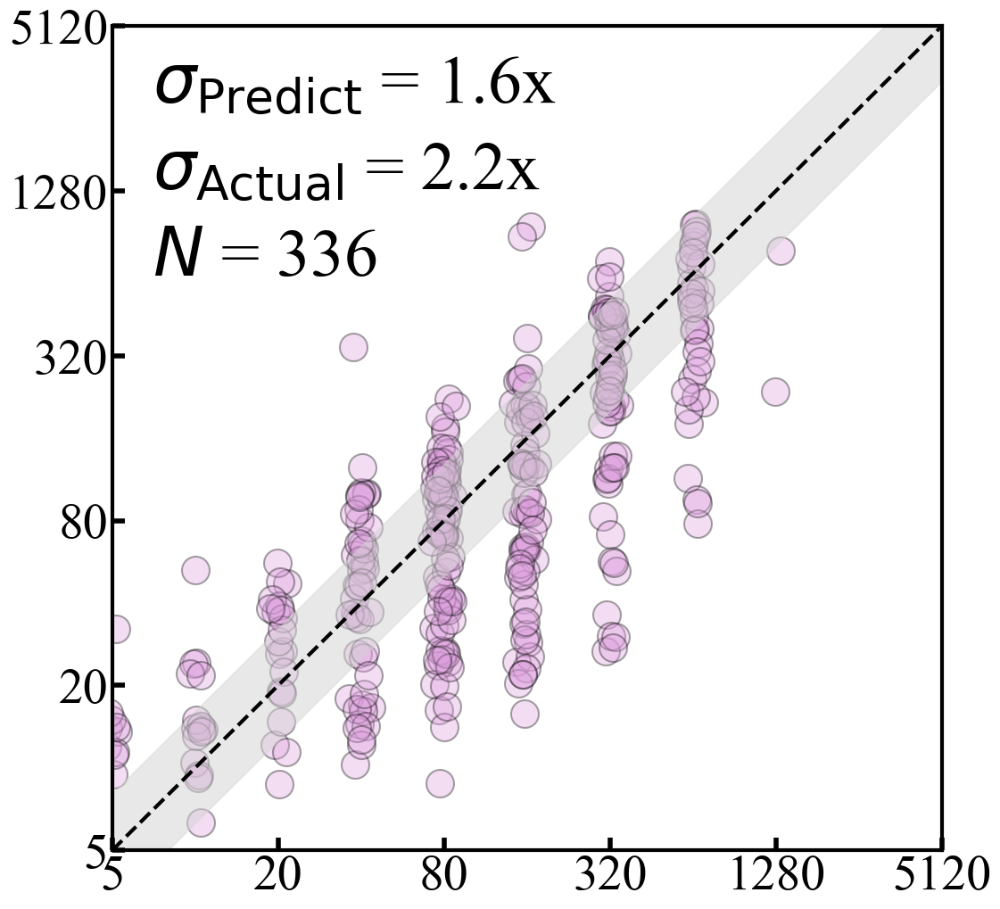

Figure saved to Figures\Panels\2023 Crotty_Afluria\train_all_datasets_test_2023 Crotty_Afluria.png
processed=110  negativeσ=3  skipped=0
Number of dataset entries for 'Ertesvag Infect': 14
sigma_pred_logged (mean) = 0.552; => ~1.466× in raw domain.


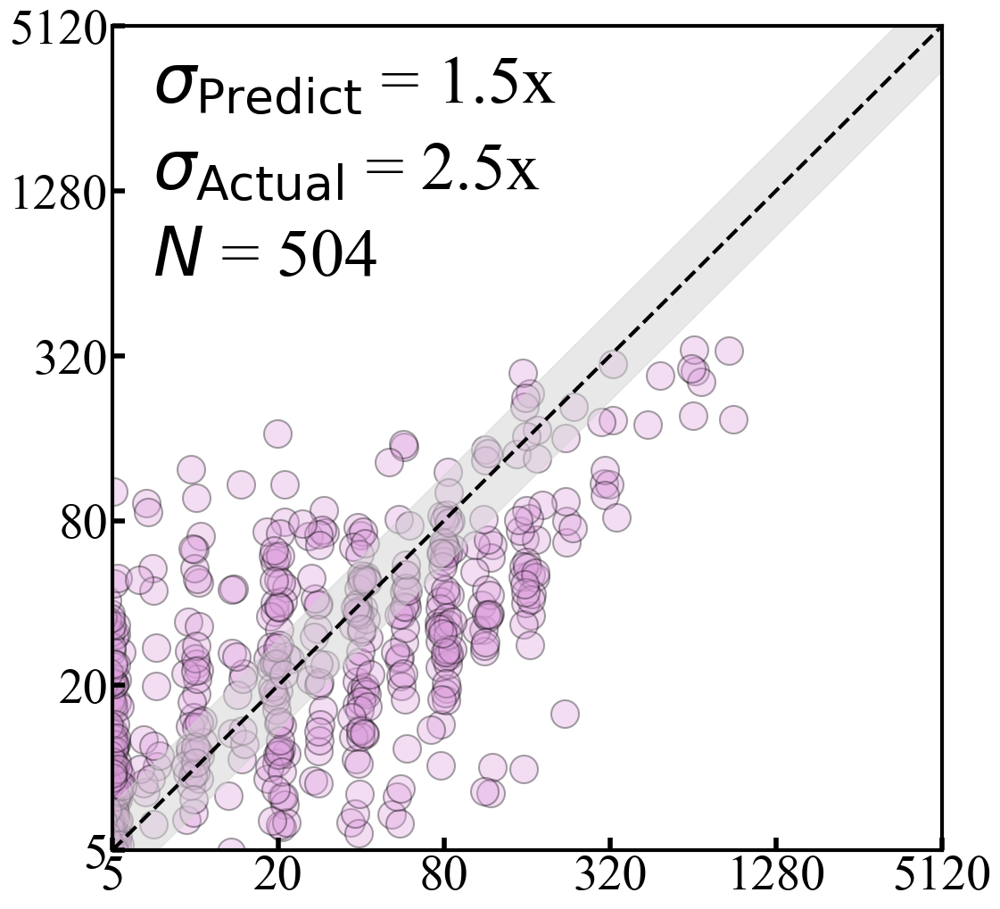

Figure saved to Figures\Panels\Ertesvag Infect\train_all_datasets_test_Ertesvag Infect.png


In [ ]:
import json, gzip, pandas as pd, datetime

parser          = DataSetNameParser()
builder         = TrainTestIndexBuilder(parser)
combiner        = PredictionCombiner()
plotter         = PredictionPlotter(jitter_strength=0.04, dot_size=500)   # tweak to taste
overlap_finder  = OverlapFinder()

# -------------------------------------------------------------
# 1)  Point to your inputs
# -------------------------------------------------------------
#dataset_dict       # ← already in memory
performance_folder = "results/transferability"   # JSONs from transferability
min_overlap        = 3                         

# -------------------------------------------------------------
# 2)  Build the   (train, test) → [perf-file paths]   index
# -------------------------------------------------------------
dataset_names = list(dataset_dict.keys())
index = builder.build_train_test_index(performance_folder, dataset_names)

# -------------------------------------------------------------
# 3)  Loop over *each* test dataset
# -------------------------------------------------------------
combined_all_tests = []          # <- one big list of combined records
sigma_actual_pool  = {}          # <- quick sigma_actual lookup

for test_ds in dataset_names:

    # ---------------------------------------------------------
    # 3a)  Which *train* datasets overlap sufficiently with it?
    # ---------------------------------------------------------
    overlapping_trains = [
        train_ds
        for train_ds in dataset_names
        if test_ds in overlap_finder.find_test_datasets_with_overlap(
                train_ds, dataset_dict, min_overlap=min_overlap)
    ]
    if not overlapping_trains:
        print(f"No overlaps found for {test_ds}; skipping.")
        continue

    # ---------------------------------------------------------
    # 3b)  Locate all perf-files  (train ∈ overlapping, test = this test_ds)
    # ---------------------------------------------------------
    files = combiner.filter_files_for_test_and_train(
        index,
        test_dataset_name=test_ds,
        chosen_train_datasets=overlapping_trains,
    )
    if not files:
        print(f"No perf-files on disk for {test_ds}; skipping.")
        continue

    # ---------------------------------------------------------
    # 3c)  Combine them  (inverse-variance weighting)
    # ---------------------------------------------------------
    combined = combiner.combine_subset_predictions(files, n_splits=1)
    combined_all_tests.extend(combined)

    # pooled σ_actual per dataset – handy for annotations later
    sigma_actual_pool[test_ds] = PredictionCombiner.pool_sigma_actual(combined)[test_ds]
    plotter.dot_color = "plum"
    # ---------------------------------------------------------
    # 3d)  Make the scatter
    # ---------------------------------------------------------
    plotter.plot_combined_predictions(
        combined,
        dataset_name=test_ds,
        train_datasets_used=overlapping_trains,
        all_train_datasets=set(overlapping_trains),
    )


def convert_ndarrays(obj):
    if isinstance(obj, np.ndarray):
        return obj.tolist()
    elif isinstance(obj, dict):
        return {k: convert_ndarrays(v) for k, v in obj.items()}
    elif isinstance(obj, list):
        return [convert_ndarrays(i) for i in obj]
    else:
        return obj

# Apply conversion before saving
json_ready = convert_ndarrays(combined_all_tests)

json_path = f"results/combined_predictions_all.json.gz"
with gzip.open(json_path, "wt", encoding="utf-8") as fh:
    json.dump(json_ready, fh, indent=2)


In [6]:
# -------------------------------------------
# 1)  Point to the file you saved
# -------------------------------------------
import gzip, json, pathlib

gz_path = pathlib.Path("results/combined_predictions_all.json.gz")  # <-- change

# -------------------------------------------
# 2)  Load it
# -------------------------------------------
with gzip.open(gz_path, "rt", encoding="utf-8") as fh:
    combined_results = json.load(fh)

print(f"loaded {len(combined_results):,} prediction records")


loaded 544 prediction records


## Figure 2

### Fig 2A - 2016 UGA and 2007-2011 Fonv Infect predictions on 2017 UGA

processed=8  negativeσ=0  skipped=0
processed=17  negativeσ=0  skipped=0
8 viruses predicted by ALL 3 legs (train1, train2 → test):
{'H3N2 A/New York/55/2004', 'H3N2 A/Nanchang/933/1995', 'H3N2 A/Wisconsin/67/2005', 'H3N2 A/Sydney/5/1997', 'H3N2 A/Perth/16/2009', 'H3N2 A/Panama/2007/1999', 'H3N2 A/Uruguay/716/2007', 'H3N2 A/Victoria/361/2011'}
processed=8  negativeσ=0  skipped=0
Number of dataset entries for '2017 UGA': 8
sigma_pred_logged (mean) = 2.940; => ~7.675× in raw domain.


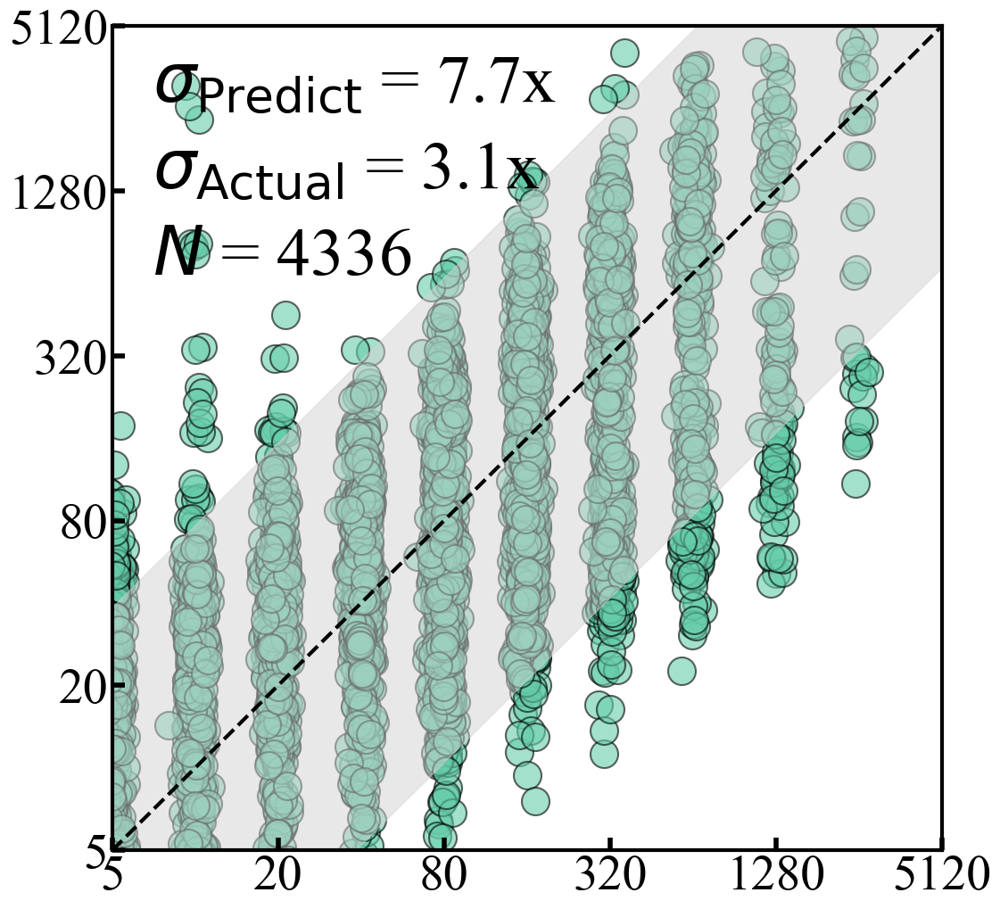

Figure saved to Figures\Panels\2017 UGA\train_2007-2011 Fonv Infect_test_2017 UGA.png
processed=17  negativeσ=0  skipped=0
Number of dataset entries for '2017 UGA': 8
sigma_pred_logged (mean) = 1.194; => ~2.288× in raw domain.


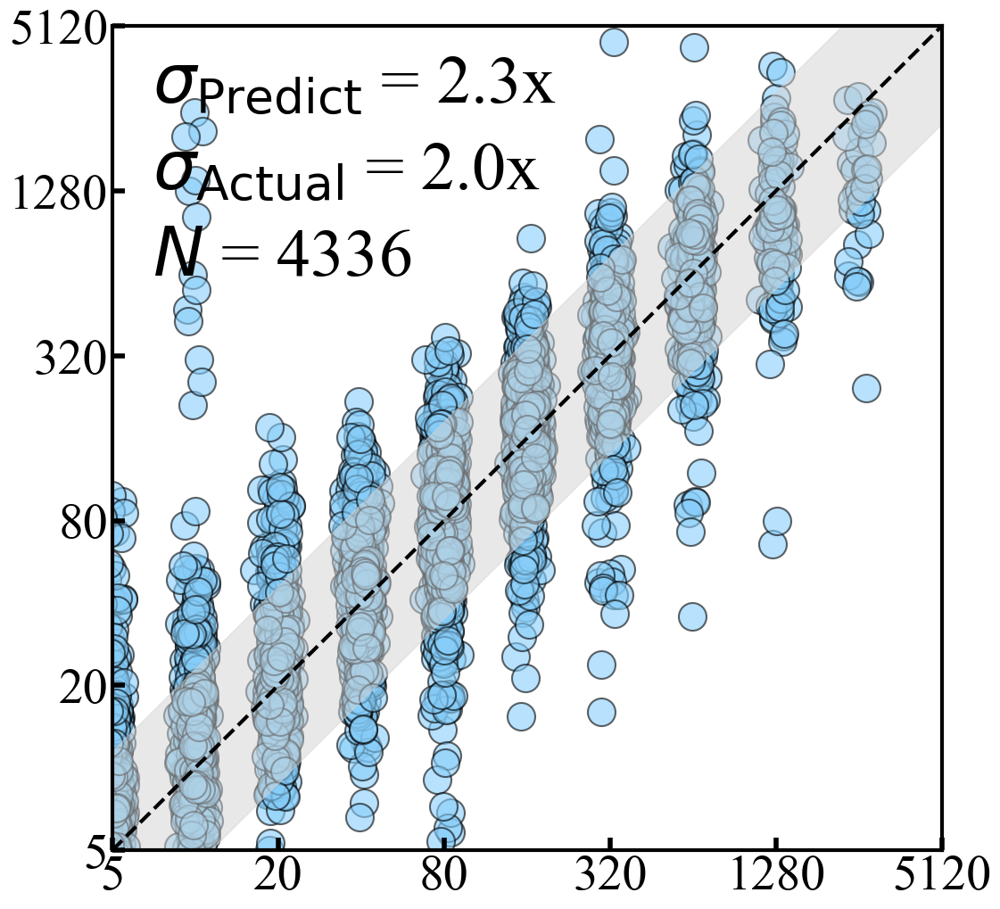

Figure saved to Figures\Panels\2017 UGA\train_2016 UGA_test_2017 UGA.png
processed=25  negativeσ=0  skipped=0
Number of dataset entries for '2017 UGA': 8
sigma_pred_logged (mean) = 1.081; => ~2.116× in raw domain.


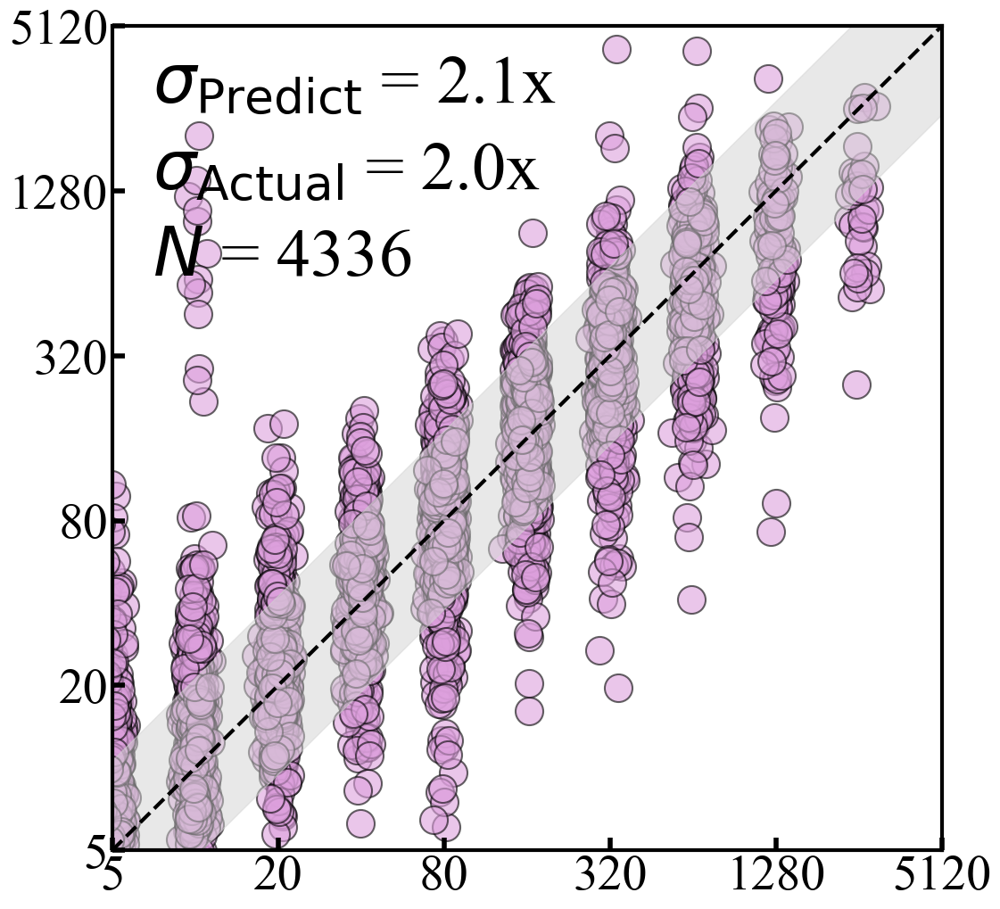

Figure saved to Figures\Panels\2017 UGA\train_2007-2011 Fonv Infect_2016 UGA_test_2017 UGA.png


In [65]:
from pathlib import Path

parser   = DataSetNameParser()
builder  = TrainTestIndexBuilder(parser)
combiner = PredictionCombiner()
plotter  = PredictionPlotter(jitter_strength=0.05,
                             dot_size=500, dot_alpha=0.6,
                             annotation_font_size=55)

# 1) Choose which trainind and test datasets 
performance_folder = Path("results/transferability")       
test_ds    = "2017 UGA"                                      
train_ds_1 = "2007-2011 Fonv Infect"
train_ds_2 = "2016 UGA"
# test_ds = "2007-2011 Fonv Infect"
# train_ds_1 = "Ertesvag Infect"
# train_ds_2 = "1997 Fonv"
chosen_trains = [train_ds_1, train_ds_2]
#  2)  Build the (train,test) → files index  
index = builder.build_train_test_index(performance_folder, list(dataset_dict.keys()))
available_train_datasets = set([train for (train, test) in index.keys() if test == test_ds])
# 3)  Helper: viruses predicted by each (train→test) 
def viruses_predicted(train_ds):
    files = combiner.filter_files_for_test_and_train(index, test_ds, [train_ds])
    if not files:
        return set(), []                      # no files on disk
    combined = combiner.combine_subset_predictions(files, n_splits=1)
    return {rec["Virus"] for rec in combined}, combined

# gather per-train virus sets + combined records
virus_sets   = {}
combined_map = {}
for tr in chosen_trains:
    vset, cmb = viruses_predicted(tr)
    virus_sets[tr]   = vset
    combined_map[tr] = cmb

# 4)  Triple-overlap
triple_overlap = set.intersection(*virus_sets.values())
print(f"{len(triple_overlap)} viruses predicted by ALL 3 legs (train1, train2 → test):")
print(triple_overlap)

# 5)  Plot per-train  
def plot_subset(subset_trains, color):
    files = combiner.filter_files_for_test_and_train(index, test_ds, subset_trains)
    combined = combiner.combine_subset_predictions(files, n_splits=1)
    combined = [r for r in combined if r["Virus"] in triple_overlap]
    if not combined:
        print(f" No overlap predictions for {subset_trains}")
        return
    plotter.dot_color = color
    plotter.plot_combined_predictions(
        combined,
        dataset_name=test_ds,
        train_datasets_used=subset_trains,
        all_train_datasets=available_train_datasets#set(chosen_trains),
    )

plot_subset([train_ds_1], "mediumaquamarine")
plot_subset([train_ds_2], "lightskyblue")

# ──  6)  Plot BOTH trains pooled  ───────────────────────────
plot_subset(chosen_trains, "plum")


### Fig 2B - Using 1997 Fonv and Ertesvag Infect for predictions for 2007-2011 Fonv Infect

processed=4  negativeσ=0  skipped=0
processed=26  negativeσ=0  skipped=0
 4 viruses predicted by ALL 3 legs (train1, train2 → test):
{'H3N2 A/Sydney/5/1997', 'H3N2 A/Wyoming/3/2003', 'H3N2 A/New York/55/2004', 'H3N2 A/Beijing/32/1992'}
processed=4  negativeσ=0  skipped=0
Number of dataset entries for '2007-2011 Fonv Infect': 4
sigma_pred_logged (mean) = 1.774; => ~3.420× in raw domain.


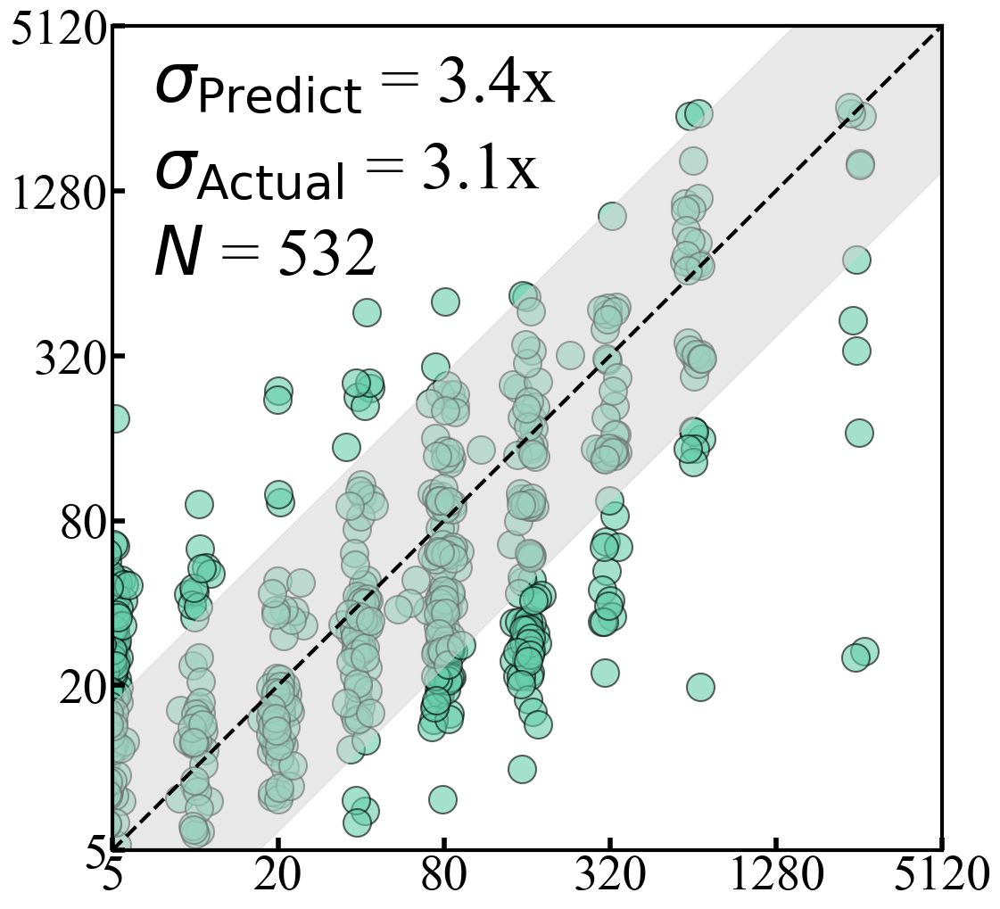

Figure saved to Figures\Panels\2007-2011 Fonv Infect\train_Ertesvag Infect_test_2007-2011 Fonv Infect.png
processed=26  negativeσ=0  skipped=0
Number of dataset entries for '2007-2011 Fonv Infect': 4
sigma_pred_logged (mean) = 1.977; => ~3.936× in raw domain.


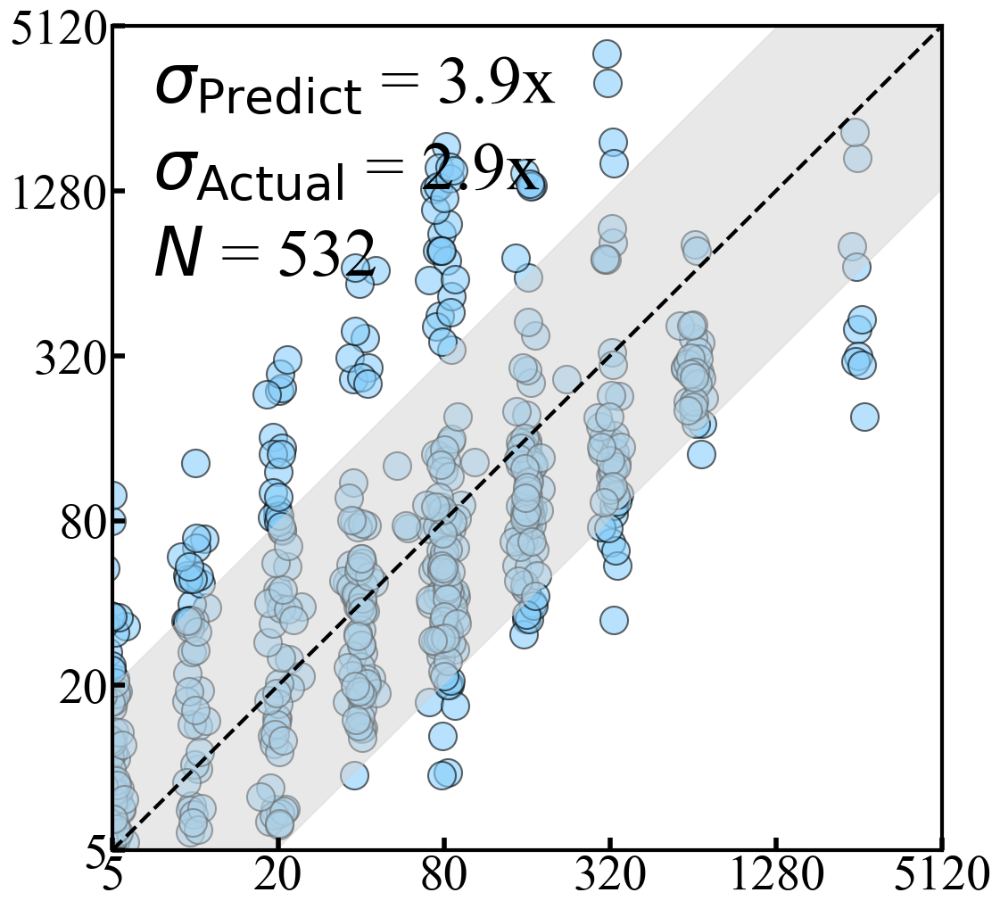

Figure saved to Figures\Panels\2007-2011 Fonv Infect\train_1997 Fonv_test_2007-2011 Fonv Infect.png
processed=30  negativeσ=0  skipped=0
Number of dataset entries for '2007-2011 Fonv Infect': 4
sigma_pred_logged (mean) = 1.303; => ~2.467× in raw domain.


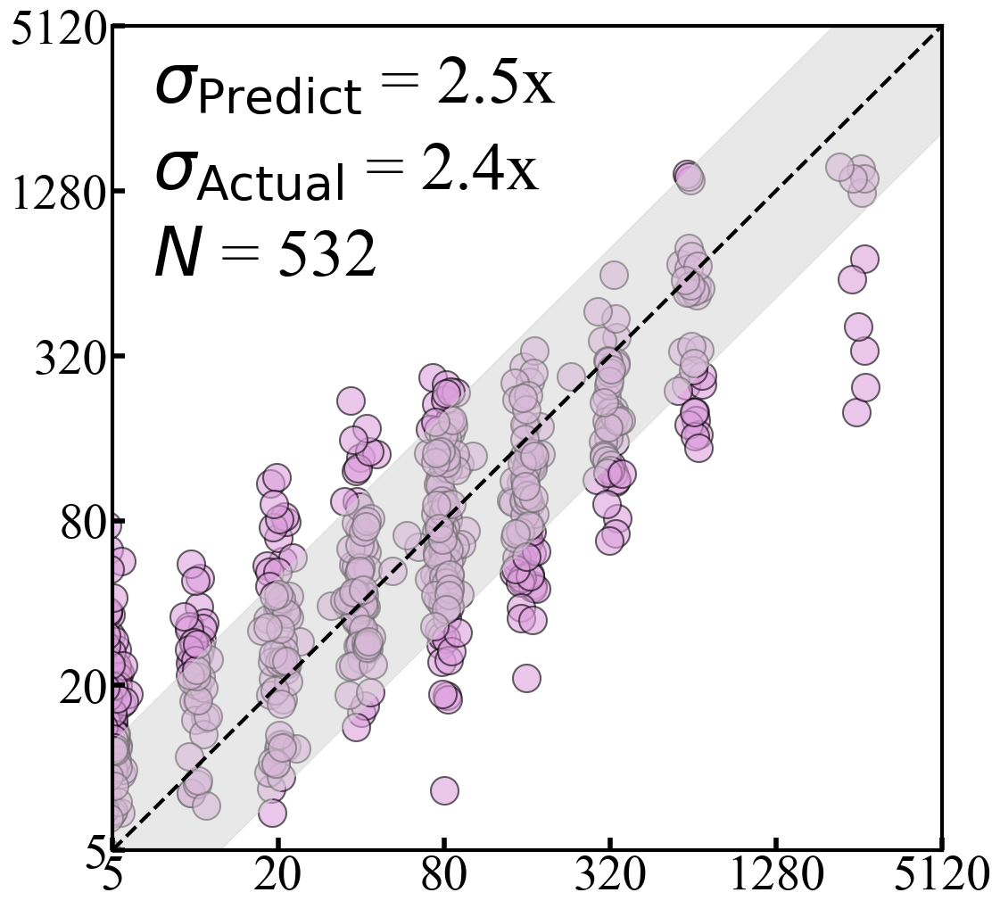

Figure saved to Figures\Panels\2007-2011 Fonv Infect\train_1997 Fonv_Ertesvag Infect_test_2007-2011 Fonv Infect.png


In [66]:
from pathlib import Path

parser   = DataSetNameParser()
builder  = TrainTestIndexBuilder(parser)
combiner = PredictionCombiner()
plotter  = PredictionPlotter(jitter_strength=0.05,
                             dot_size=500, dot_alpha=0.6,
                             annotation_font_size=55)

# 1) Choose which trainind and test datasets 
performance_folder = Path("results/transferability")       
# test_ds    = "2017 UGA"                                      
# train_ds_1 = "2007-2011 Fonv Infect"
# train_ds_2 = "2016 UGA"
test_ds = "2007-2011 Fonv Infect"
train_ds_1 = "Ertesvag Infect"
train_ds_2 = "1997 Fonv"
chosen_trains = [train_ds_1, train_ds_2]
#  2)  Build the (train,test) → files index  
index = builder.build_train_test_index(performance_folder, list(dataset_dict.keys()))
available_train_datasets = set([train for (train, test) in index.keys() if test == test_ds])
# 3)  Helper: viruses predicted by each (train→test) 
def viruses_predicted(train_ds):
    files = combiner.filter_files_for_test_and_train(index, test_ds, [train_ds])
    if not files:
        return set(), []                      # no files on disk
    combined = combiner.combine_subset_predictions(files, n_splits=1)
    return {rec["Virus"] for rec in combined}, combined

# gather per-train virus sets + combined records
virus_sets   = {}
combined_map = {}
for tr in chosen_trains:
    vset, cmb = viruses_predicted(tr)
    virus_sets[tr]   = vset
    combined_map[tr] = cmb

# 4)  Triple-overlap
triple_overlap = set.intersection(*virus_sets.values())
print(f" {len(triple_overlap)} viruses predicted by ALL 3 legs (train1, train2 → test):")
print(triple_overlap)

# 5)  Plot per-train  
def plot_subset(subset_trains, color):
    files = combiner.filter_files_for_test_and_train(index, test_ds, subset_trains)
    combined = combiner.combine_subset_predictions(files, n_splits=1)
    combined = [r for r in combined if r["Virus"] in triple_overlap]
    if not combined:
        print(f" No overlap predictions for {subset_trains}")
        return
    plotter.dot_color = color
    plotter.plot_combined_predictions(
        combined,
        dataset_name=test_ds,
        train_datasets_used=subset_trains,
        all_train_datasets=available_train_datasets#set(chosen_trains),
    )

plot_subset([train_ds_1], "mediumaquamarine")
plot_subset([train_ds_2], "lightskyblue")

# ──  6)  Plot BOTH trains pooled  ───────────────────────────
plot_subset(chosen_trains, "plum")


### Figure 2C, 2D, 2E

Available training datasets for this test dataset: {'Ertesvag Infect', '2012 Ertesvag_LAIV', '2023 Crotty_Afluria', '2015 Hin_V', '2007-2012 Fonv Infect', '2014 Hin_V', '2009-2011 Hay Infect', '2015 Hin_U', '2018 UGA', '2020 UGA', '1998 Fonv', '2010 Ertesvag_IIV', '2007-2011 Fonv Infect', '2021 UGA', '2013 Ertesvag_LAIV', '2012-2015 Hay Infect', '2016 Fox_Nam', '1997 Fonv', '2017 UGA', '2016 UGA', '2013 Ertesvag_IIV', '2019 UGA', '2010 Fonv', '2009 Fonv'}
processed=188  negativeσ=8  skipped=0
Number of combined results: 32
Number of dataset entries for '2016 Fox_HCW': 32
sigma_pred_logged (mean) = 0.738; => ~1.667× in raw domain.


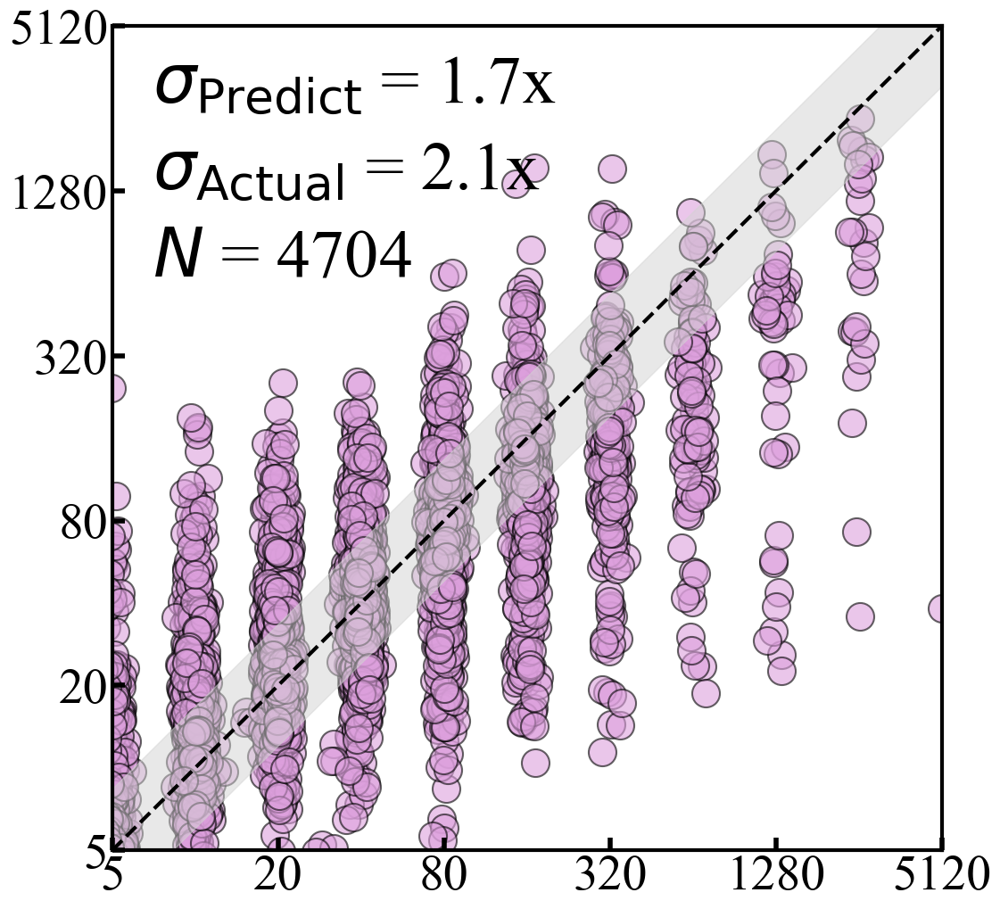

Figure saved to Figures\Panels\2016 Fox_HCW\train_all_datasets_test_2016 Fox_HCW.png


In [18]:
test_dataset_name = "2016 Fox_HCW"
available_train_datasets = set([train for (train, test) in index.keys() if test == test_dataset_name])
print("Available training datasets for this test dataset:", available_train_datasets)
# -------------------------------------------------------------
# 5) Filter & Combine (for 1 or multiple train datasets)
# -------------------------------------------------------------
subset_of_train = available_train_datasets
files_for_subset = combiner.filter_files_for_test_and_train(index, test_dataset_name, subset_of_train)

combined_results = combiner.combine_subset_predictions(files_for_subset)
print("Number of combined results:", len(combined_results))

# -------------------------------------------------------------
# 6) Plot the combined predictions
# -------------------------------------------------------------
plotter.dot_color = 'plum'
plotter.plot_combined_predictions(
    combined_results,
    dataset_name=test_dataset_name,
    train_datasets_used=subset_of_train,
    all_train_datasets=available_train_datasets
)


Available training datasets for this test dataset: {'Ertesvag Infect', '2012 Ertesvag_LAIV', '2015 Hin_V', '2007-2012 Fonv Infect', '2009-2011 Hay Infect', '2015 Hin_U', '2018 UGA', '1998 Fonv', '2010 Ertesvag_IIV', '2007-2011 Fonv Infect', '2013 Ertesvag_LAIV', '2012-2015 Hay Infect', '2016 Fox_HCW', '2016 Fox_Nam', '1997 Fonv', '2017 UGA', '2016 UGA', '2013 Ertesvag_IIV', '2019 UGA'}
processed=120  negativeσ=4  skipped=0
Number of combined results: 16
Number of dataset entries for '2014 Hin_V': 16
sigma_pred_logged (mean) = 0.486; => ~1.400× in raw domain.


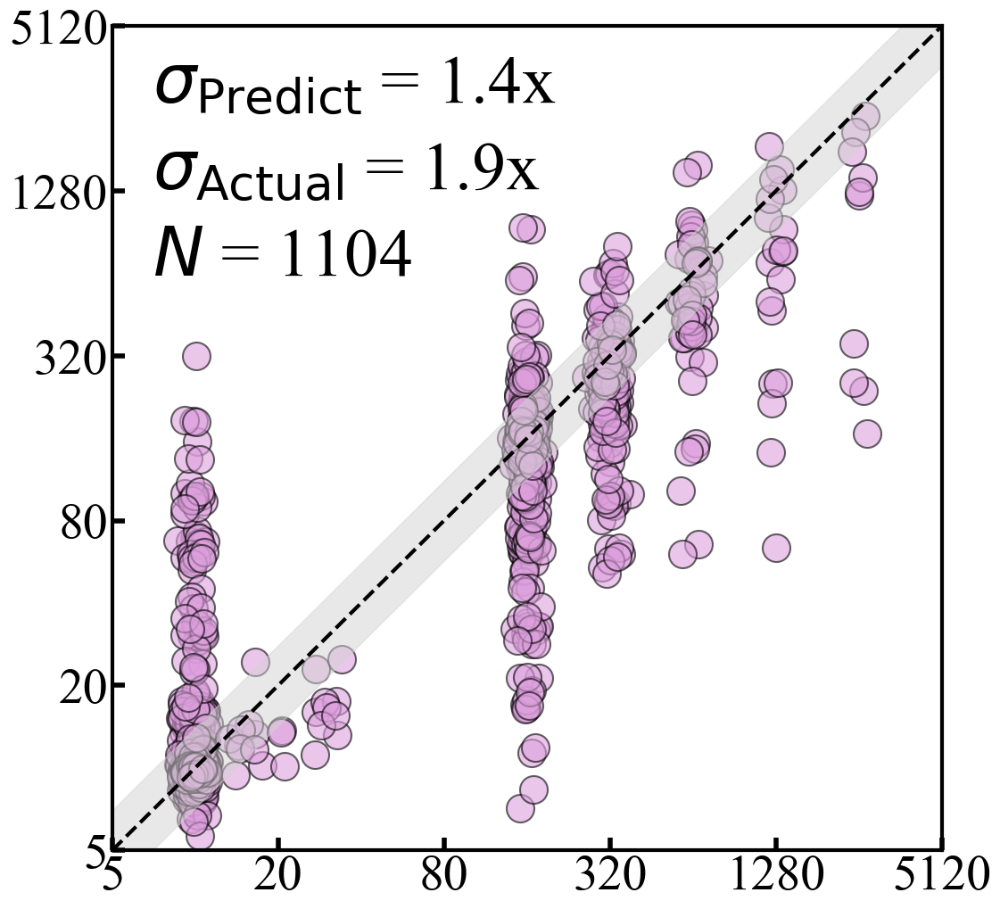

Figure saved to Figures\Panels\2014 Hin_V\train_all_datasets_test_2014 Hin_V.png


In [19]:
test_dataset_name = "2014 Hin_V"
available_train_datasets = set([train for (train, test) in index.keys() if test == test_dataset_name])
print("Available training datasets for this test dataset:", available_train_datasets)
# -------------------------------------------------------------
# 5) Filter & Combine (for 1 or multiple train datasets)
# -------------------------------------------------------------
subset_of_train = available_train_datasets
files_for_subset = combiner.filter_files_for_test_and_train(index, test_dataset_name, subset_of_train)

combined_results = combiner.combine_subset_predictions(files_for_subset)
print("Number of combined results:", len(combined_results))

# -------------------------------------------------------------
# 6) Plot the combined predictions
# -------------------------------------------------------------
plotter.dot_color = 'plum'
plotter.plot_combined_predictions(
    combined_results,
    dataset_name=test_dataset_name,
    train_datasets_used=subset_of_train,
    all_train_datasets=available_train_datasets
)


Available training datasets for this test dataset: {'2015 Hin_V', '1997 Fonv', '2017 UGA', '2016 UGA', '2007-2012 Fonv Infect', 'Ertesvag Infect', '2014 Hin_V', '2012 Ertesvag_LAIV', '2007-2011 Fonv Infect', '2009-2011 Hay Infect', '2015 Hin_U', '2018 UGA', '2013 Ertesvag_IIV', '1998 Fonv', '2010 Ertesvag_IIV', '2013 Ertesvag_LAIV', '2016 Fox_HCW', '2016 Fox_Nam'}
processed=128  negativeσ=4  skipped=0
Number of combined results: 20
Number of dataset entries for '2012-2015 Hay Infect': 20
sigma_pred_logged (mean) = 0.462; => ~1.378× in raw domain.


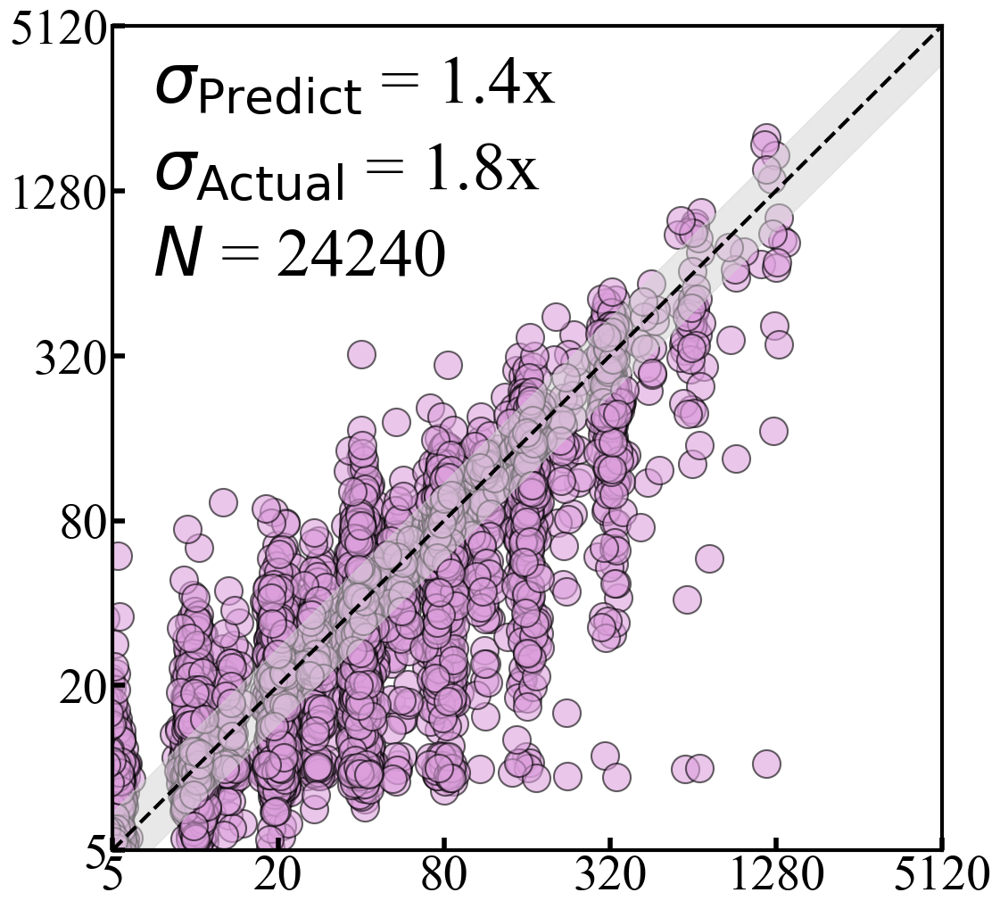

Figure saved to Figures\Panels\2012-2015 Hay Infect\train_all_datasets_test_2012-2015 Hay Infect.png


In [20]:
test_dataset_name = "2012-2015 Hay Infect"
available_train_datasets = set([train for (train, test) in index.keys() if test == test_dataset_name])
print("Available training datasets for this test dataset:", available_train_datasets)
# -------------------------------------------------------------
# 5) Filter & Combine (for 1 or multiple train datasets)
# -------------------------------------------------------------
subset_of_train = available_train_datasets
files_for_subset = combiner.filter_files_for_test_and_train(index, test_dataset_name, subset_of_train)

combined_results = combiner.combine_subset_predictions(files_for_subset)
print("Number of combined results:", len(combined_results))

# -------------------------------------------------------------
# 6) Plot the combined predictions
# -------------------------------------------------------------
plotter.dot_color = 'plum'
plotter.plot_combined_predictions(
    combined_results,
    dataset_name=test_dataset_name,
    train_datasets_used=subset_of_train,
    all_train_datasets=available_train_datasets
)


## Figure 3

In [ ]:
# ────────────────────────────────────────────────────────────────
# 1.  Pretty-print names and orders for axes
# ────────────────────────────────────────────────────────────────
row_order = [
    "All Datasets",
    "1997 Fonv", "1998 Fonv", "2009 Fonv", "2010 Fonv",
    "2007-2011 Fonv Infect", "2007-2012 Fonv Infect",
    "2009-2011 Hay Infect", "2012-2015 Hay Infect",
    "Ertesvag Infect", "2010 Ertesvag_IIV", "2013 Ertesvag_IIV",
    "2012 Ertesvag_LAIV", "2013 Ertesvag_LAIV",
    "2014 Hin_V", "2015 Hin_U", "2015 Hin_V",
    "2016 Fox_HCW", "2016 Fox_Nam",
    "2016 UGA", "2017 UGA", "2018 UGA", "2019 UGA",
    "2020 UGA", "2021 UGA",
    "2023 Crotty_Afluria"
]

col_order = [
    "1997 Fonv", "1998 Fonv", "2009 Fonv", "2010 Fonv",
    "2007-2011 Fonv Infect", "2007-2012 Fonv Infect",
    "2009-2011 Hay Infect", "2012-2015 Hay Infect",
    "Ertesvag Infect", "2010 Ertesvag_IIV", "2013 Ertesvag_IIV",
    "2012 Ertesvag_LAIV", "2013 Ertesvag_LAIV",
    "2014 Hin_V", "2015 Hin_U", "2015 Hin_V",
    "2016 Fox_HCW", "2016 Fox_Nam",
    "2016 UGA", "2017 UGA", "2018 UGA", "2019 UGA",
    "2020 UGA", "2021 UGA",
    "2023 Crotty_Afluria"
]
pretty = {
    "All Datasets": r"$\text{All Datasets}$",
    "1997 Fonv": r"$\text{1997 Fonv}_{\text{Vac}}$",
    "1998 Fonv": r"$\text{1998 Fonv}_{\text{Vac}}$",
    "2009 Fonv": r"$\text{2009 Fonv}_{\text{Vac}}$",
    "2010 Fonv": r"$\text{2010 Fonv}_{\text{Vac}}$",
    "2007-2011 Fonv Infect": r"$\text{2007-2011 Fonv}_{\text{Inf}}$",
    "2007-2012 Fonv Infect": r"$\text{2007-2012 Fonv}_{\text{Inf}}$",
    "2009-2011 Hay Infect": r"$\text{2009-2011 Hay}_{\text{Inf}}$",
    "2012-2015 Hay Infect": r"$\text{2012-2015 Hay}_{\text{Inf}}$",
    "Ertesvag Infect": r"$\text{2010-2014 Ert}_{\text{Inf}}$",
    "2010 Ertesvag_IIV": r"$\text{2010 Ert}_{\text{IIV,Vac}}$",
    "2013 Ertesvag_IIV": r"$\text{2013 Ert}_{\text{IIV,Vac}}$",
    "2012 Ertesvag_LAIV": r"$\text{2012 Ert}_{\text{LAIV,Vac}}$",
    "2013 Ertesvag_LAIV": r"$\text{2013 Ert}_{\text{LAIV,Vac}}$",
    "2014 Hin_V": r"$\text{2014 Hin}_{\text{V,Vac}}$",
    "2015 Hin_V": r"$\text{2015 Hin}_{\text{V,Vac}}$",
    "2015 Hin_U": r"$\text{2015 Hin}_{\text{U,Vac}}$",
    "2016 Fox_HCW": r"$\text{2016 Fox}_{\text{HCW,Vac}}$",
    "2016 Fox_Nam": r"$\text{2016 Fox}_{\text{Nam,Vac}}$",
    "2016 UGA": r"$\text{2016 UGA}_{\text{Vac}}$",
    "2017 UGA": r"$\text{2017 UGA}_{\text{Vac}}$",
    "2018 UGA": r"$\text{2018 UGA}_{\text{Vac}}$",
    "2019 UGA": r"$\text{2019 UGA}_{\text{Vac}}$",
    "2020 UGA": r"$\text{2020 UGA}_{\text{Vac}}$",
    "2021 UGA": r"$\text{2021 UGA}_{\text{Vac}}$",
    "2023 Crotty_Afluria": r"$\text{2023 Crotty}_{\text{Vac}}$"
}

In [ ]:
import seaborn as sns

# 25 XKCD colors
xkcd_colors = [
    'denim blue', 'ocean blue', 'windows blue', 'sky blue', 'light blue', 
    'lightish blue', 'violet', 'lilac', 'burnt red', 'scarlet', 'bright red',
    'light red', 'salmon', 'bright yellow', 'dull yellow',
    'marigold', 'burnt sienna', 'dark tan', 'deep green', 'olive',
    'kelly green', 'bright green', 'seafoam green', 'faded green', 'warm grey'
]

# Get color palette
palette = sns.xkcd_palette(xkcd_colors)

# Map colors to dataset names
ordered_datasets = [
    "1997 Fonv","1998 Fonv","2009 Fonv","2010 Fonv",
    "2007-2011 Fonv Infect","2007-2012 Fonv Infect",
    "2009-2011 Hay Infect","2012-2015 Hay Infect",
    "Ertesvag Infect","2010 Ertesvag_IIV","2013 Ertesvag_IIV",
    "2012 Ertesvag_LAIV","2013 Ertesvag_LAIV",
    "2014 Hin_V","2015 Hin_U","2015 Hin_V",
    "2016 Fox_HCW","2016 Fox_Nam",
    "2016 UGA","2017 UGA","2018 UGA","2019 UGA",
    "2020 UGA","2021 UGA","2023 Crotty_Afluria"
]

color_map = dict(zip(ordered_datasets, palette))

In [ ]:
from Capybara.performance_analyzer import PerformanceAnalyzer
an = PerformanceAnalyzer(
    performance_folder = "results/transferability",   # Path to json files
    dataset_dict=dataset_dict,         # {"DatasetA": dfA, "DatasetB": dfB, …}
    n_splits=1            # how many CV splits you stored in each json
)

### Fig 3B - Heatmap

 Skipping '1997 Fonv_Fonv Ferret_perf.json' (unparseable).
 Skipping '1998 Fonv_Fonv Ferret_perf.json' (unparseable).
 Skipping '2009 Fonv_Fonv Ferret_perf.json' (unparseable).
 Skipping '2009-2011 Hay Infect_Fonv Ferret_perf.json' (unparseable).
 Skipping '2010 Ertesvag_IIV_Fonv Ferret_perf.json' (unparseable).
 Skipping '2010 Fonv_Fonv Ferret_perf.json' (unparseable).
 Skipping '2012 Ertesvag_LAIV_Fonv Ferret_perf.json' (unparseable).
 Skipping '2012-2015 Hay Infect_Fonv Ferret_perf.json' (unparseable).
 Skipping '2013 Ertesvag_IIV_Fonv Ferret_perf.json' (unparseable).
 Skipping '2013 Ertesvag_LAIV_Fonv Ferret_perf.json' (unparseable).
 Skipping '2014 Hin_V_Fonv Ferret_perf.json' (unparseable).
 Skipping '2015 Hin_U_Fonv Ferret_perf.json' (unparseable).
 Skipping '2015 Hin_V_Fonv Ferret_perf.json' (unparseable).
 Skipping '2016 Fox_HCW_2022 UGA_perf.json' (unparseable).
 Skipping '2016 Fox_HCW_2024 Einav_perf.json' (unparseable).
 Skipping '2016 Fox_HCW_Fonv Ferret_perf.json' (unpars

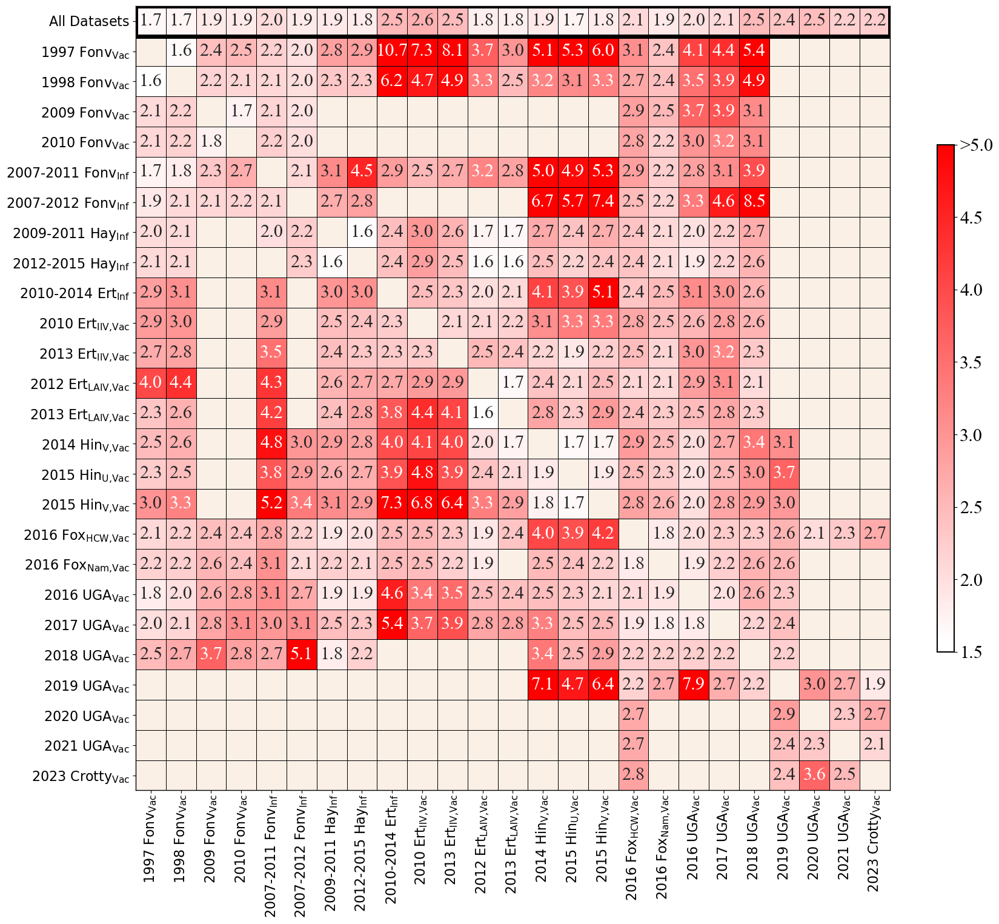

In [14]:
an.plot_heatmap(
    row_order=row_order,
    col_order=col_order,
    pretty_names=pretty,
    save_path="Figures/Panels/Fig3A.pdf",
    max_color="red"
)

### Fig 3B -Pairwise All

3200 records
σActual = 2.63-fold  (log2 RMSE = 1.397)


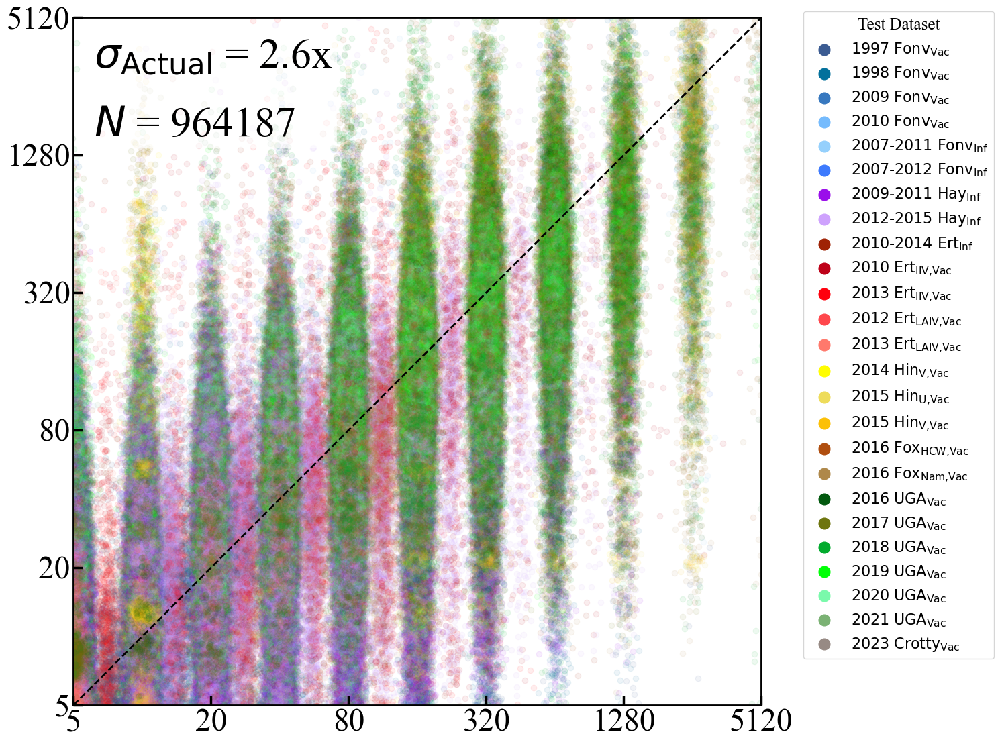

In [15]:
# ---------------------------------------------------------------------------
# 0) Imports (run once)
# ---------------------------------------------------------------------------
import os
import json
import pickle
import numpy as np
from pathlib import Path
from collections import defaultdict
from sklearn.metrics import mean_squared_error

# ---------------------------------------------------------------------------
# 1) Helper: parse   "<train>_<test>_perf.json"  →  (train, test)
# ---------------------------------------------------------------------------
def parse_train_test_from_fname(fname, dataset_names):
    if not fname.endswith(("_perf.json", "_perf.pkl")):
        return None, None
    base = fname.rsplit("_perf.", 1)[0]        # drop suffix
    # Match the *longest* dataset name at the end for 'test'
    sorted_ds = sorted(dataset_names, key=len, reverse=True)
    for test in sorted_ds:
        if base.endswith(test):
            train = base[:-len(test)].rstrip("_")
            if train in dataset_names:
                return train, test
    return None, None

# ---------------------------------------------------------------------------
# 2) Helper: load JSON *or* PKL transparently
# ---------------------------------------------------------------------------
def load_perf_file(path):
    if path.suffix == ".json":
        with open(path, "r") as f:
            return json.load(f)
    # legacy .pkl
    with open(path, "rb") as f:
        return pickle.load(f)

# ---------------------------------------------------------------------------
# 3) The converter
# ---------------------------------------------------------------------------
def convert_loo_to_pairwise(
    loo_dict, *, n_splits=1, assume_log2=True
):
    pair_dict = defaultdict(lambda: defaultdict(list))
    for train_ds, by_leftout in loo_dict.items():
        for left_out, rec_list in by_leftout.items():
            for rec in rec_list:
                test_ds = rec["Test Dataset"]
                a = np.asarray(rec["Actual Left-Out"])
                p = np.asarray(rec["Predicted Left-Out"])

                # collapse CV splits → one value per subject
                a = a[::n_splits]
                p = p.reshape(-1, n_splits).mean(1)

                if not assume_log2:
                    a = np.log2(a / 5.0)
                    p = np.log2(p / 5.0)

                pair_dict[train_ds][test_ds].append(
                    {"Actual": a, "Predicted": p}
                )
    return pair_dict

# ---------------------------------------------------------------------------
# 4) Collect EVERY pair in results/transferability
# ---------------------------------------------------------------------------
transfer_dir   = Path("results/transferability")
dataset_names  = list(dataset_dict.keys())   # your global dataset_dict already exists
all_pairwise   = defaultdict(lambda: defaultdict(list))

for fpath in transfer_dir.glob("*_perf.*"):
    tr, te = parse_train_test_from_fname(fpath.name, dataset_names)
    if tr is None:
        print(f"skipped {fpath.name}")
        continue

    loo_result = load_perf_file(fpath)
    pairwise   = convert_loo_to_pairwise(
        loo_result,
        n_splits=1,          #  ← adjust if you saved a different CV count
        assume_log2=True     #  ← set False if values are raw HAI
    )

    # merge into master dict
    for train_ds, test_dict in pairwise.items():
        for test_ds, lst in test_dict.items():
            all_pairwise[train_ds][test_ds].extend(lst)

print(f"{sum(len(v) for t in all_pairwise.values() for v in t.values())} records")

# ---------------------------------------------------------------------------
# 5) Global RMSE for the σ-box
# ---------------------------------------------------------------------------
all_actual = np.concatenate([d["Actual"]    for tr in all_pairwise.values()
                                               for te in tr.values()
                                               for d  in te])
all_pred   = np.concatenate([d["Predicted"] for tr in all_pairwise.values()
                                               for te in tr.values()
                                               for d  in te])
avg_rmse_log2 = np.sqrt(mean_squared_error(all_actual, all_pred))
print(f"σActual = {2**avg_rmse_log2:.2f}-fold  (log2 RMSE = {avg_rmse_log2:.3f})")

# ---------------------------------------------------------------------------
# 6) Plot with your existing PerformanceAnalyzer helper
# ---------------------------------------------------------------------------
an.plot_pairwise_pred_vs_meas(
    prediction_performance_dict=all_pairwise,
    avg_rmse_log2=avg_rmse_log2,
    ordered_datasets=ordered_datasets,
    color_map=color_map,
    pretty_names=pretty,
    jitter_amount=0.1,
    alpha_points=0.07,
    figsize=(15, 15),
    tick_fontsize=34,
    title_fontsize=45,
    max_points=1_000_000,          # cap if too dense
    save_path="Figures/Panels/Fig3B.png",
)


### Fig 3C - All Combined Predictions

processed=290  negativeσ=6  skipped=0
processed=289  negativeσ=7  skipped=0
processed=167  negativeσ=7  skipped=0
processed=183  negativeσ=2  skipped=0
processed=91  negativeσ=2  skipped=0
processed=127  negativeσ=5  skipped=0
processed=109  negativeσ=4  skipped=0
processed=91  negativeσ=2  skipped=0
processed=110  negativeσ=3  skipped=0
processed=128  negativeσ=4  skipped=0
processed=110  negativeσ=3  skipped=0
processed=107  negativeσ=6  skipped=0
processed=120  negativeσ=4  skipped=0
processed=123  negativeσ=1  skipped=0
processed=121  negativeσ=3  skipped=0
processed=188  negativeσ=8  skipped=0
processed=183  negativeσ=6  skipped=0
processed=125  negativeσ=8  skipped=0
processed=132  negativeσ=5  skipped=0
processed=97  negativeσ=3  skipped=0
processed=37  negativeσ=4  skipped=0
processed=21  negativeσ=1  skipped=0
processed=20  negativeσ=2  skipped=0
processed=20  negativeσ=2  skipped=0
processed=110  negativeσ=3  skipped=0


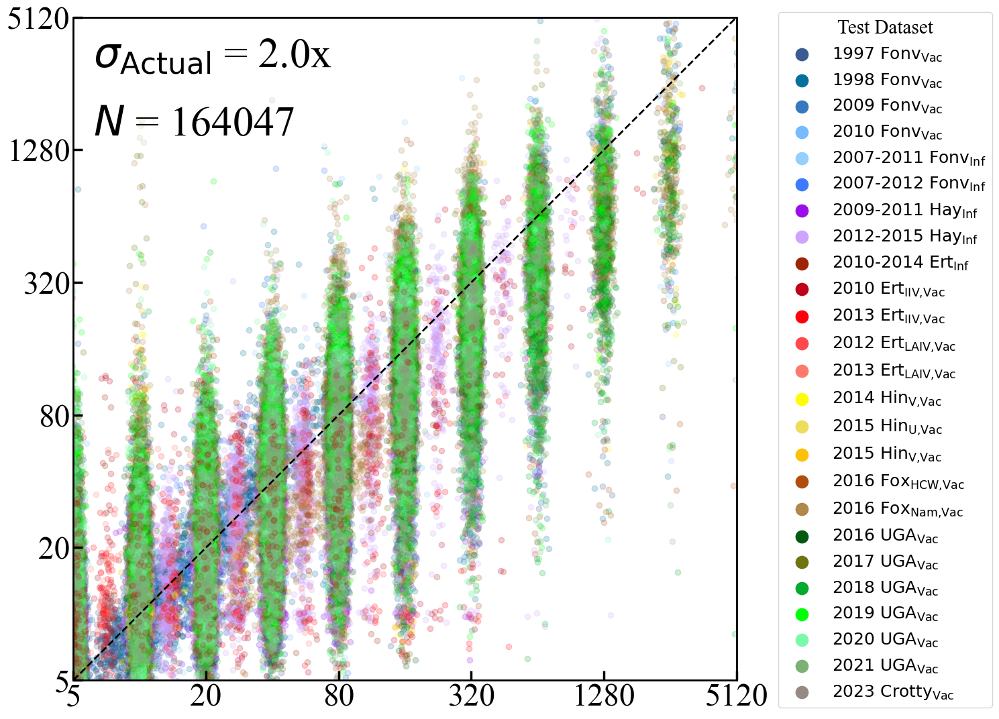

In [16]:
an.plot_pred_vs_meas(
    ordered_datasets=ordered_datasets,
    color_map=color_map,
    pretty_names=pretty,
    figsize=(15, 15),
    jitter_amount=0.05,
    alpha_points=0.2,
    font_family="Times New Roman",
    tick_fontsize=34,
    label_fontsize=30,
    legend_fontsize=18,
    legend_title_fontsize=21,
    sigma_box_fontsize=45,
    markerscale=2.2,
    save_path="Figures/Panels/Fig3C.png"
)


## Figure 4

### Fig 4A - Adult vs Child vs Mixed Comparison

In [ ]:
from itertools import combinations
from statsmodels.stats.multitest import multipletests

# Define known children and adult sets

child_datasets = [
    "2015 Hin_U",
    "2015 Hin_V",
    "2014 Hin_V",
    "2012 Ertesvag_LAIV",
    "2013 Ertesvag_LAIV"
]
adult_datasets = [
    "1998 Fonv",
    "2023 Crotty_Afluria",
    "2016 Fox_HCW",
    "2016 Fox_Nam",
    "2016 UGA",
    "1997 Fonv",
    "2010 Ertesvag_IIV",
    "2013 Ertesvag_IIV",
    "2016 UGA",
    "Ertesvag Infect"
]
child_and_adult_dataset = [
    '2009 Fonv', 
    '2009-2011 Hay Infect', 
    '2010 Fonv', 
    '2012-2015 Hay Infect', 
    '2017 UGA', 
    '2018 UGA', 
    '2019 UGA', 
    '2020 UGA', 
    '2021 UGA', 
    '2007-2011 Fonv Infect',
    '2007-2012 Fonv Infect'
]
performance_folder = "results/transferability"

# Gather all dataset names
all_datasets = child_datasets + adult_datasets + child_and_adult_dataset

# Build the index
parser = DataSetNameParser()
index_builder = TrainTestIndexBuilder(parser)
index_ = index_builder.build_train_test_index(performance_folder, all_datasets)
type_to_datasets = {
    "Child": child_datasets,
    "Adult": adult_datasets,
    "Child+Adult": child_and_adult_dataset
}

# All 3 × 3 = 9 combos
type_combinations = [
    ("Child", "Child"),
    ("Child", "Adult"),
    ("Child", "Child+Adult"),
    ("Adult", "Child"),
    ("Adult", "Adult"),
    ("Adult", "Child+Adult"),
    ("Child+Adult", "Child"),
    ("Child+Adult", "Adult"),
    ("Child+Adult", "Child+Adult"),
]
combiner = PredictionCombiner()


In [ ]:
# ── 0)  Setup ────────────────────────────────────────────────────────────────
from Capybara.combining_predictions import (
    DataSetNameParser,
    TrainTestIndexBuilder,
    PredictionCombiner,
    PredictionPlotter,
    load_perf
)
df_rows = []

for (train_type_str, test_type_str) in type_combinations:
    train_list = type_to_datasets[train_type_str]
    test_list  = type_to_datasets[test_type_str]
    
    for test_ds in test_list:
        # Ensure we do not include the test dataset in the training datasets
        filtered_train_list = [ds for ds in train_list if ds != test_ds]

        relevant_files = combiner.filter_files_for_test_and_train(
            index_, 
            test_dataset_name=test_ds, 
            chosen_train_datasets=filtered_train_list
        )
        
        if not relevant_files:
            # No matching files for this scenario
            continue
        
        # 2) Combine predictions across these relevant files
        combined_results = combiner.combine_subset_predictions(relevant_files, n_splits=1)
        
        # 3) Each item in `combined_results` is a dict with keys:
        #   {
        #       'Test Dataset',
        #       'Virus',
        #       'Actual Values',
        #       'Predicted Values',
        #       'Sigma Combined',
        #       'Sigma Actual',   # e.g. RMSE
        #   }
        
        # We append these to our master table, labeling them by train/test type
        for item in combined_results:
            df_rows.append({
                "Test Dataset": item["Test Dataset"],
                "Virus": item["Virus"],
                "Actual Values": item["Actual Values"],
                "Predicted Values": item["Predicted Values"],
                "Sigma Combined": item["Sigma Combined"],
                "Sigma Actual": item["Sigma Actual"],  # This is e.g. RMSE for the combined predictions
                "Train Type": train_type_str,
                "Test Type": test_type_str
            })

# Convert to a DataFrame
df_combined = pd.DataFrame(df_rows)

processed=42  negativeσ=0  skipped=0
processed=42  negativeσ=0  skipped=0
processed=42  negativeσ=0  skipped=0
processed=29  negativeσ=1  skipped=0
processed=29  negativeσ=1  skipped=0
processed=32  negativeσ=4  skipped=0
processed=19  negativeσ=0  skipped=0
processed=19  negativeσ=0  skipped=0
processed=28  negativeσ=1  skipped=0
processed=32  negativeσ=4  skipped=0
processed=41  negativeσ=3  skipped=0
processed=42  negativeσ=2  skipped=0
processed=28  negativeσ=1  skipped=0
processed=42  negativeσ=2  skipped=0
processed=45  negativeσ=0  skipped=0
processed=45  negativeσ=0  skipped=0
processed=27  negativeσ=2  skipped=0
processed=17  negativeσ=0  skipped=0
processed=4  negativeσ=2  skipped=0
processed=22  negativeσ=3  skipped=0
processed=9  negativeσ=0  skipped=0
processed=43  negativeσ=0  skipped=0
processed=43  negativeσ=0  skipped=0
processed=42  negativeσ=1  skipped=0
processed=58  negativeσ=1  skipped=0
processed=55  negativeσ=4  skipped=0
processed=129  negativeσ=3  skipped=0
pr

Permutation test p-values (two-sided, Holm-corrected):
Adult: Adult vs Child+Adult --> raw p = 0.00000, corrected p = 0.00000
Adult: Adult vs Child --> raw p = 0.00000, corrected p = 0.00000
Adult: Child+Adult vs Child --> raw p = 0.00000, corrected p = 0.00000
Child+Adult: Adult vs Child+Adult --> raw p = 0.00320, corrected p = 0.00640
Child+Adult: Adult vs Child --> raw p = 0.00000, corrected p = 0.00000
Child+Adult: Child+Adult vs Child --> raw p = 0.00000, corrected p = 0.00000
Child: Adult vs Child+Adult --> raw p = 0.82880, corrected p = 0.82880
Child: Adult vs Child --> raw p = 0.00000, corrected p = 0.00000
Child: Child+Adult vs Child --> raw p = 0.00000, corrected p = 0.00000
Test Type    Train Type 
Adult        Adult          1.777028
             Child          2.402444
             Child+Adult    1.944650
Child        Adult          2.327120
             Child          1.708262
             Child+Adult    2.268199
Child+Adult  Adult          2.018006
             Child    

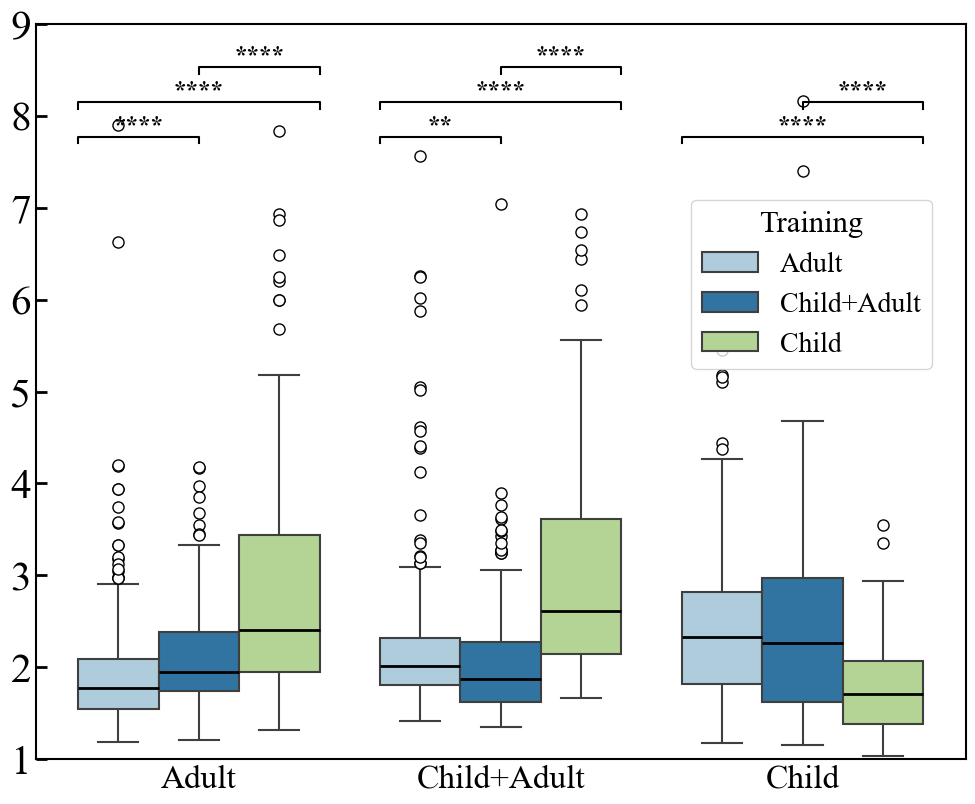

In [34]:
# Create an unlogged RMSE column
df_combined["rmse_actual_unlog"] = 2 ** df_combined["Sigma Actual"]

# Set the global font to Times New Roman
plt.rcParams["font.family"] = "serif"
plt.rcParams["font.serif"] = ["Times New Roman"]

def permutation_pvalue(x1, x2, n_permutations=10000, seed=42):
    """Two-sided permutation test"""
    np.random.seed(seed)
    observed_diff = np.abs(np.median(x1) - np.median(x2))
    combined = np.concatenate([x1, x2])
    n1 = len(x1)

    count = 0
    for _ in range(n_permutations):
        np.random.shuffle(combined)
        new_x1, new_x2 = combined[:n1], combined[n1:]
        new_diff = np.abs(np.median(new_x1) - np.median(new_x2))
        if new_diff >= observed_diff:
            count += 1
    return count / n_permutations

# ------------------------------------------
# Run permutation tests across all pairs
# ------------------------------------------
test_type_order = ["Adult", "Child+Adult", "Child"]
hue_order = ["Adult", "Child+Adult", "Child"]

comparisons = []
perm_pvals = []

for tt in test_type_order:
    subset = df_combined[df_combined["Test Type"] == tt]
    for g1, g2 in combinations(hue_order, 2):
        x1 = subset[subset["Train Type"] == g1]["rmse_actual_unlog"].values
        x2 = subset[subset["Train Type"] == g2]["rmse_actual_unlog"].values
        if len(x1) == 0 or len(x2) == 0:
            continue
        pval = permutation_pvalue(x1, x2, n_permutations=10000)
        comparisons.append((tt, g1, g2))
        perm_pvals.append(pval)

# ------------------------------------------
# Multiple test correction (Holm)
# ------------------------------------------
_, adj_pvals, _, _ = multipletests(perm_pvals, method="holm")

# ------------------------------------------
# Print results
# ------------------------------------------
print("Permutation test p-values (two-sided, Holm-corrected):")
for (tt, g1, g2), raw, adj in zip(comparisons, perm_pvals, adj_pvals):
    print(f"{tt}: {g1} vs {g2} --> raw p = {raw:.5f}, corrected p = {adj:.5f}")

grouped_medians = df_combined.groupby(["Test Type", "Train Type"])["rmse_actual_unlog"].median()
print(grouped_medians)

# Helper: Convert p-values to star labels
def star_label(p):
    if   p < 0.0001: return "****"
    elif p < 0.001:  return "***"
    elif p < 0.01:   return "**"
    elif p < 0.05:   return "*"
    else:            return "ns"

# ❶ Create the boxplot
plt.figure(figsize=(10, 8))
ax = sns.boxplot(
    data=df_combined,
    x="Test Type",
    y="rmse_actual_unlog",
    hue="Train Type",
    order=["Adult", "Child+Adult", "Child"],
    hue_order=["Adult", "Child+Adult", "Child"],
    linewidth=1.5,
    flierprops=dict(marker='o', markerfacecolor='white',
                    markeredgecolor='black', markersize=8),
    medianprops=dict(linewidth=2, color='black'),
    palette="Paired"
)

# Get x-positions dynamically per Test Type group
box_width = 0.8
xpos = {}
test_type_order = ["Adult", "Child+Adult", "Child"]
hue_order = ["Adult", "Child+Adult", "Child"]

for i_tt, tt in enumerate(test_type_order):
    present_hues = sorted(
        df_combined[df_combined["Test Type"] == tt]["Train Type"].unique(),
        key=hue_order.index
    )
    offsets = np.linspace(-box_width/2, box_width/2, len(present_hues))
    for j_h, h in enumerate(present_hues):
        xpos[(tt, h)] = i_tt + offsets[j_h]

# Use computed permutation p-values
# Already computed:
# - comparisons = [(tt, g1, g2), ...]
# - adj_pvals = corrected p-values (Holm)

# Add significance bars
y_base_per_testtype = {
    "Adult": 7.7,
    "Child+Adult": 7.7,
    "Child": 7.7
}
bar_height = 0.07
spacing = 0.38

for (tt, g1, g2), p_corr in zip(comparisons, adj_pvals):
    label = star_label(p_corr)
    if label == "ns":
        continue
    x1, x2 = xpos[(tt, g1)], xpos[(tt, g2)]

    y_base = y_base_per_testtype[tt]  # fixed start for this Test Type
    y = y_base
    y_base_per_testtype[tt] += spacing  # move up a little for next bar in SAME Test Type

    ax.plot([x1, x1, x2, x2],
            [y,  y+bar_height, y+bar_height, y],
            lw=1.5, c='black')
    ax.text((x1+x2)/2, y + bar_height*1.05, label,
            ha='center', va='bottom', fontsize=18, fontweight='bold')

plt.xlabel("")
plt.ylabel("")
# Final touch-ups
ax.set(ylim=(1, 9))
# Remove bottom x-axis ticks
ax.tick_params(axis='x', which='both', top=False, labelsize=24, bottom=False, direction='in', length=8, width=2)

# Keep y-axis ticks unchanged or styled
ax.tick_params(axis='y', which='both', direction='in', length=8, width=2, labelsize=30)

# Move legend outside
ax.legend(
    title="Training",
    fontsize=20,
    title_fontsize=22,
    loc='upper left',
    bbox_to_anchor=(0.69, 0.78)
)

# Darken all four spines (axes borders)
for spine in ax.spines.values():
    spine.set_color("black")
    spine.set_linewidth(1.5)   

plt.tight_layout()
plt.savefig("Figures/Panels/Fig4A.pdf", format="pdf", bbox_inches="tight")
plt.show()

### Fig 4B - Vaccine vs Infection Comparison

In [35]:
vaccine_datasets = [
    "2015 Hin_V",
    "2015 Hin_U",
    "2014 Hin_V",
    "2013 Ertesvag_IIV",
    "2010 Ertesvag_IIV",
    "2013 Ertesvag_LAIV",
    "2012 Ertesvag_LAIV",
    "2023 Crotty_Afluria",
    "2016 Fox_HCW",
    "2016 Fox_Nam",
    "2016 UGA",
    "2017 UGA",
    "2018 UGA",
    "2019 UGA",
    "2020 UGA",
    "2021 UGA",
    "1997 Fonv",
    "1998 Fonv",
    "2009 Fonv",
    "2010 Fonv"
]

infection_datasets = [
    "2007-2012 Fonv Infect",
    "2007-2011 Fonv Infect",
    "2009-2011 Hay Infect",
    "Ertesvag Infect",
    "2012-2015 Hay Infect"
]

def dataset_category(dataset_name: str) -> str:
    """
    Return 'Vaccine' if the dataset is in vaccine_datasets,
    'Infection' if in infection_datasets, else 'Unknown'.
    """
    if dataset_name in vaccine_datasets:
        return "Vaccine"
    elif dataset_name in infection_datasets:
        return "Infection"
    else:
        return "Unknown"
# Define Combinations of Train and Test Scenarios
type_to_datasets = {
    "Vaccine": vaccine_datasets,
    "Infection": infection_datasets
}

combinations = [
    ("Vaccine", "Vaccine"),
    ("Vaccine", "Infection"),
    ("Infection", "Vaccine"),
    ("Infection", "Infection"),
]
combiner = PredictionCombiner()
df_rows = []

for (train_type_str, test_type_str) in combinations:
    train_list = type_to_datasets[train_type_str]
    test_list  = type_to_datasets[test_type_str]
    
    for test_ds in test_list:
        # Ensure we do not include the test dataset in the training datasets
        filtered_train_list = [ds for ds in train_list if ds != test_ds]

        relevant_files = combiner.filter_files_for_test_and_train(
            index_, 
            test_dataset_name=test_ds, 
            chosen_train_datasets=filtered_train_list
        )

        if not relevant_files:
            continue
        
        # Combine predictions across these relevant files
        combined_results = combiner.combine_subset_predictions(relevant_files, n_splits=1)
        
        # Store results in a dataframe
        for item in combined_results:
            df_rows.append({
                "Test Dataset": item["Test Dataset"],
                "Virus": item["Virus"],
                "Actual Values": item["Actual Values"],
                "Predicted Values": item["Predicted Values"],
                "Sigma Combined": item["Sigma Combined"],
                "Sigma Actual": item["Sigma Actual"],  # RMSE for combined predictions
                "Train Type": train_type_str,
                "Test Type": test_type_str
            })

# Convert to DataFrame
df_combined = pd.DataFrame(df_rows)



processed=88  negativeσ=3  skipped=0
processed=90  negativeσ=1  skipped=0
processed=87  negativeσ=4  skipped=0
processed=77  negativeσ=3  skipped=0
processed=76  negativeσ=4  skipped=0
processed=74  negativeσ=6  skipped=0
processed=77  negativeσ=3  skipped=0
processed=20  negativeσ=2  skipped=0
processed=145  negativeσ=7  skipped=0
processed=134  negativeσ=5  skipped=0
processed=97  negativeσ=7  skipped=0
processed=104  negativeσ=4  skipped=0
processed=80  negativeσ=1  skipped=0
processed=37  negativeσ=4  skipped=0
processed=21  negativeσ=1  skipped=0
processed=20  negativeσ=2  skipped=0
processed=208  negativeσ=6  skipped=0
processed=207  negativeσ=7  skipped=0
processed=74  negativeσ=2  skipped=0
processed=75  negativeσ=1  skipped=0
processed=155  negativeσ=2  skipped=0
processed=144  negativeσ=4  skipped=0
processed=93  negativeσ=4  skipped=0
processed=91  negativeσ=3  skipped=0
processed=95  negativeσ=2  skipped=0
processed=33  negativeσ=0  skipped=0
processed=33  negativeσ=0  skip

Permutation test p-values (two-sided, Holm-corrected):
Vaccine: Vaccine vs Infection --> raw p = 0.0000000, corrected p = 0.0000000
Infection: Vaccine vs Infection --> raw p = 0.0112000, corrected p = 0.0112000


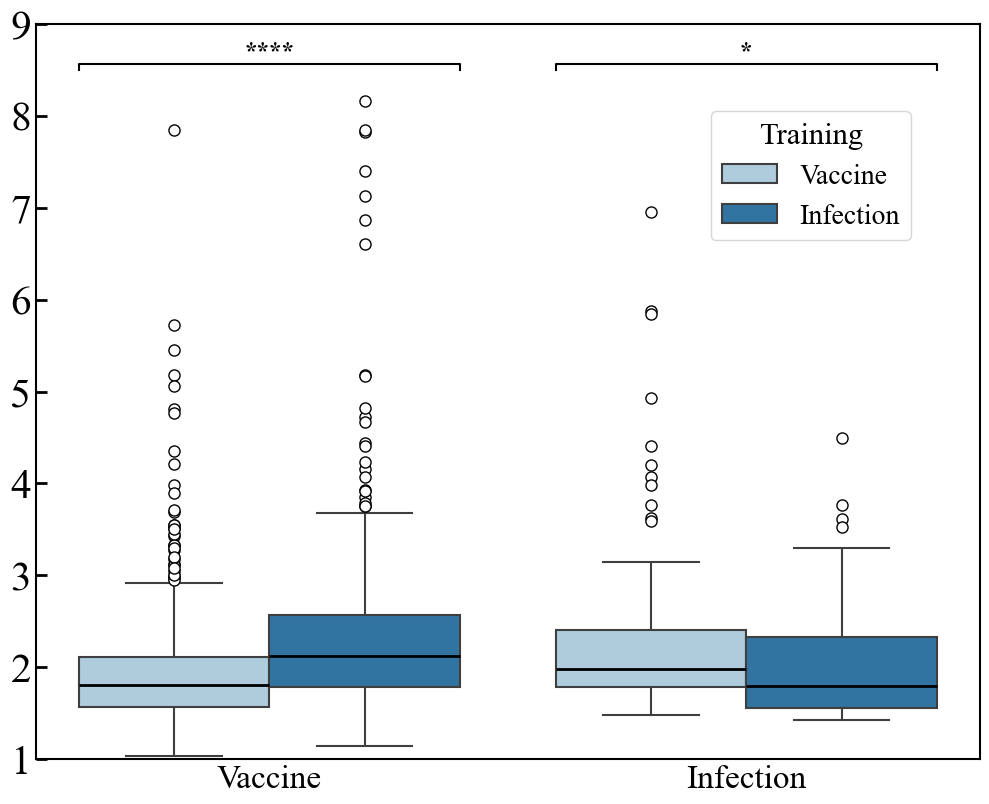

Test Type  Train Type
Infection  Infection     1.797533
           Vaccine       1.982097
Vaccine    Infection     2.119331
           Vaccine       1.808199
Name: rmse_actual_unlog, dtype: float64


In [36]:
from itertools import combinations
from statsmodels.stats.multitest import multipletests
import numpy as np
# Convert Log RMSE to Unlogged RMSE
df_combined["rmse_actual_unlog"] = 2 ** df_combined["Sigma Actual"]
def permutation_pvalue(x1, x2, n_permutations=10000, seed=42):
    """Two-sided permutation test"""
    np.random.seed(seed)
    observed_diff = np.abs(np.median(x1) - np.median(x2))
    combined = np.concatenate([x1, x2])
    n1 = len(x1)

    count = 0
    for _ in range(n_permutations):
        np.random.shuffle(combined)
        new_x1, new_x2 = combined[:n1], combined[n1:]
        new_diff = np.abs(np.median(new_x1) - np.median(new_x2))
        if new_diff >= observed_diff:
            count += 1
    return count / n_permutations

# ------------------------------------------
# Run permutation tests across all pairs
# ------------------------------------------
test_type_order = ["Vaccine", "Infection"]
hue_order = ["Vaccine", "Infection"]

comparisons = []
perm_pvals = []

for tt in test_type_order:
    subset = df_combined[df_combined["Test Type"] == tt]
    for g1, g2 in combinations(hue_order, 2):
        x1 = subset[subset["Train Type"] == g1]["rmse_actual_unlog"].values
        x2 = subset[subset["Train Type"] == g2]["rmse_actual_unlog"].values
        if len(x1) == 0 or len(x2) == 0:
            continue
        pval = permutation_pvalue(x1, x2, n_permutations=10000)
        comparisons.append((tt, g1, g2))
        perm_pvals.append(pval)

# ------------------------------------------
# Multiple test correction (Holm)
# ------------------------------------------
_, adj_pvals, _, _ = multipletests(perm_pvals, method="holm")

# ------------------------------------------
# Print results
# ------------------------------------------
print("Permutation test p-values (two-sided, Holm-corrected):")
for (tt, g1, g2), raw, adj in zip(comparisons, perm_pvals, adj_pvals):
    print(f"{tt}: {g1} vs {g2} --> raw p = {raw:.7f}, corrected p = {adj:.7f}")
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Helper function again if needed
def star_label(p):
    if   p < 0.0001: return "****"
    elif p < 0.001:  return "***"
    elif p < 0.01:   return "**"
    elif p < 0.05:   return "*"
    else:            return "ns"

# 1. Set font
plt.rcParams["font.family"] = "serif"
plt.rcParams["font.serif"] = ["Times New Roman"]

# 2. Start fresh figure
plt.figure(figsize=(10, 8))

# 3. Correct: assign sns.boxplot to ax
ax = sns.boxplot(
    data=df_combined,
    x="Test Type",            # Vaccine vs Infection (test)
    y="rmse_actual_unlog",    # RMSE
    hue="Train Type",         # Vaccine vs Infection (train)
    order=["Vaccine", "Infection"],
    hue_order=["Vaccine", "Infection"],
    linewidth=1.5,
    flierprops=dict(marker='o', markerfacecolor='white',
                    markeredgecolor='black', markersize=8),
    medianprops=dict(linewidth=2, color='black'),
    palette="Paired"
)

# 4. Map box x-positions dynamically
box_width = 0.8
xpos = {}
test_type_order = ["Vaccine", "Infection"]
hue_order = ["Vaccine", "Infection"]

for i_tt, tt in enumerate(test_type_order):
    present_hues = sorted(
        df_combined[df_combined["Test Type"] == tt]["Train Type"].unique(),
        key=hue_order.index
    )
    offsets = np.linspace(-box_width/2, box_width/2, len(present_hues))
    for j_h, h in enumerate(present_hues):
        xpos[(tt, h)] = i_tt + offsets[j_h]

# 5. Add significance bars
y_base_per_testtype = {
    "Vaccine": 8.5,
    "Infection": 8.5
}
bar_height = 0.07
spacing = 0.38

for (tt, g1, g2), p_corr in zip(comparisons, adj_pvals):
    label = star_label(p_corr)
    if label == "ns":
        continue
    x1, x2 = xpos[(tt, g1)], xpos[(tt, g2)]

    y_base = y_base_per_testtype[tt]
    y = y_base
    y_base_per_testtype[tt] += spacing

    ax.plot([x1, x1, x2, x2],
            [y, y + bar_height, y + bar_height, y],
            lw=1.5, c='black')
    ax.text((x1 + x2) / 2, y + bar_height * 1.05, label,
            ha='center', va='bottom', fontsize=18, fontweight='bold')

# 6. Final clean-up (matching Children vs Adult style)
ax.set_ylim(1, 9)
# Remove bottom x-axis ticks
ax.tick_params(axis='x', which='both', top=False, labelsize=24, bottom=False, direction='in', length=8, width=2)
# Keep y-axis ticks unchanged or styled
ax.tick_params(axis='y', which='both', direction='in', length=8, width=2, labelsize=30)


# Legend outside top-left like before
ax.legend(
    title="Training",
    fontsize=20,
    title_fontsize=22,
    loc='upper left',
    bbox_to_anchor=(0.7, 0.9)
)

# Darken all four spines (axes borders)
for spine in ax.spines.values():
    spine.set_color("black")   # or a hex code, e.g. "#222222"
    spine.set_linewidth(1.5)   # thicker line
plt.xlabel("")
plt.ylabel("")
plt.tight_layout()

# 7. Save
plt.savefig("Figures/Panels/Fig4B.pdf", format="pdf", bbox_inches="tight")
plt.show()
grouped_medians = df_combined.groupby(["Test Type", "Train Type"])["rmse_actual_unlog"].median()
print(grouped_medians)

### Fig 4C Year Groups

In [37]:
dataset_year_map = {
    "2010 Ertesvag_IIV": 2010, "2012 Ertesvag_LAIV": 2012,
    "2013 Ertesvag_IIV": 2013, "2013 Ertesvag_LAIV": 2013,
    "2014 Hin_V": 2014, "2015 Hin_V": 2015, "2015 Hin_U": 2015,
    "2016 Fox_HCW": 2016, "2016 Fox_Nam": 2016, "2016 UGA": 2016,
    "2023 Crotty_Afluria": 2023, "2017 UGA": 2017, "2018 UGA": 2018,
    "2019 UGA": 2019, "2020 UGA": 2020, "2021 UGA": 2021,
    "1997 Fonv": 1997, "1998 Fonv": 1998, "2009 Fonv": 2009, "2010 Fonv": 2010,
    "2007-2012 Fonv Infect": 2010, "2007-2011 Fonv Infect": 2009, "2009-2011 Hay Infect": 2010,
    "Ertesvag Infect": 2012, "2012-2015 Hay Infect": 2013
}

# Define year bins
bins = [1990, 2000, 2010, 2015, 2020, 2025]
labels = ["1996-2000", "2006-2010", "2011–2015", "2016–2020", "2021-2025"]


In [38]:
combiner = PredictionCombiner()
df_rows = []

# Create mappings from bins to datasets
train_bin_to_datasets = {label: [] for label in labels}
test_bin_to_datasets  = {label: [] for label in labels}

for dataset, year in dataset_year_map.items():
    bin_label = pd.cut([year], bins=bins, labels=labels)[0]
    if bin_label in train_bin_to_datasets:
        train_bin_to_datasets[bin_label].append(dataset)
        test_bin_to_datasets[bin_label].append(dataset)

# Iterate over all train-test year group bins
for train_bin in labels:
    for test_bin in labels:
        train_list = train_bin_to_datasets[train_bin]
        test_list  = test_bin_to_datasets[test_bin]

        if not train_list or not test_list:
            continue  # Skip empty bins

        for test_ds in test_list:
            # Ensure we do not include the test dataset in the training datasets
            filtered_train_list = [ds for ds in train_list if ds != test_ds]

            relevant_files = combiner.filter_files_for_test_and_train(
                index_, 
                test_dataset_name=test_ds, 
                chosen_train_datasets=filtered_train_list
            )

            if not relevant_files:
                continue

            # Combine predictions across these relevant files within the same (train_bin, test_bin)
            combined_results = combiner.combine_subset_predictions(relevant_files, n_splits=1)

            # Store results in a dataframe
            for item in combined_results:
                df_rows.append({
                    "Test Dataset": item["Test Dataset"],
                    "Virus": item["Virus"],
                    "Actual Values": item["Actual Values"],
                    "Predicted Values": item["Predicted Values"],
                    "Sigma Combined": item["Sigma Combined"],
                    "Sigma Actual": item["Sigma Actual"],  # RMSE for combined predictions
                    "Train Year Group": train_bin,
                    "Test Year Group": test_bin
                })

# Convert to DataFrame
df_combined = pd.DataFrame(df_rows)


processed=69  negativeσ=0  skipped=0
processed=69  negativeσ=0  skipped=0
processed=8  negativeσ=0  skipped=0
processed=35  negativeσ=0  skipped=0
processed=35  negativeσ=0  skipped=0
processed=65  negativeσ=1  skipped=0
processed=52  negativeσ=0  skipped=0
processed=12  negativeσ=2  skipped=0
processed=8  negativeσ=0  skipped=0
processed=8  negativeσ=0  skipped=0
processed=8  negativeσ=0  skipped=0
processed=13  negativeσ=0  skipped=0
processed=13  negativeσ=0  skipped=0
processed=13  negativeσ=0  skipped=0
processed=8  negativeσ=0  skipped=0
processed=12  negativeσ=2  skipped=0
processed=39  negativeσ=1  skipped=0
processed=38  negativeσ=2  skipped=0
processed=13  negativeσ=0  skipped=0
processed=13  negativeσ=0  skipped=0
processed=11  negativeσ=0  skipped=0
processed=109  negativeσ=0  skipped=0
processed=109  negativeσ=0  skipped=0
processed=11  negativeσ=0  skipped=0
processed=37  negativeσ=0  skipped=0
processed=36  negativeσ=1  skipped=0
processed=49  negativeσ=0  skipped=0
proc

Permutation test p-values (only for groups with data, Holm-corrected):
1996-2000: 1996-2000 vs 2006-2010 --> raw p = 0.00000, corrected p = 0.00000
1996-2000: 1996-2000 vs 2011–2015 --> raw p = 0.00000, corrected p = 0.00000
1996-2000: 1996-2000 vs 2016–2020 --> raw p = 0.00000, corrected p = 0.00000
1996-2000: 2006-2010 vs 2011–2015 --> raw p = 0.07970, corrected p = 1.00000
1996-2000: 2006-2010 vs 2016–2020 --> raw p = 0.00750, corrected p = 0.12000
1996-2000: 2011–2015 vs 2016–2020 --> raw p = 0.78010, corrected p = 1.00000
2006-2010: 1996-2000 vs 2006-2010 --> raw p = 0.72390, corrected p = 1.00000
2006-2010: 1996-2000 vs 2011–2015 --> raw p = 0.09410, corrected p = 1.00000
2006-2010: 1996-2000 vs 2016–2020 --> raw p = 0.00080, corrected p = 0.01520
2006-2010: 2006-2010 vs 2011–2015 --> raw p = 0.20500, corrected p = 1.00000
2006-2010: 2006-2010 vs 2016–2020 --> raw p = 0.00570, corrected p = 0.09690
2006-2010: 2011–2015 vs 2016–2020 --> raw p = 0.38020, corrected p = 1.00000
2011–

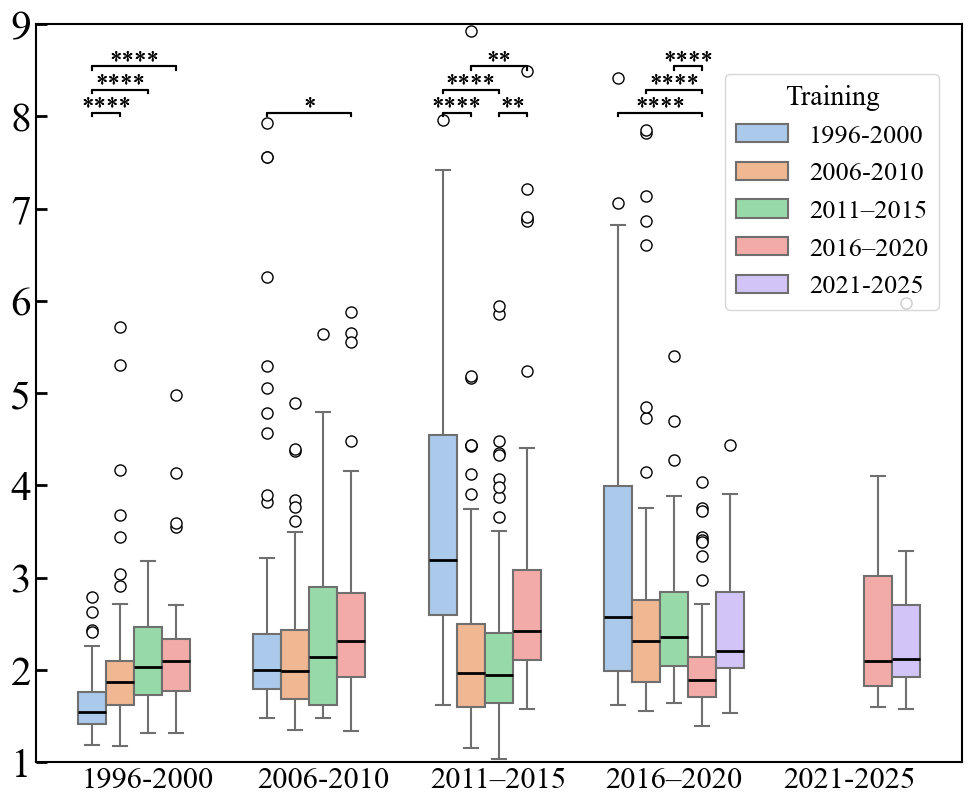

Test Year Group  Train Year Group
1996-2000        1996-2000           1.544815
                 2006-2010           1.871426
                 2011–2015           2.035194
                 2016–2020           2.098777
2006-2010        1996-2000           1.997871
                 2006-2010           1.987796
                 2011–2015           2.143431
                 2016–2020           2.313957
2011–2015        1996-2000           3.192976
                 2006-2010           1.971108
                 2011–2015           1.945591
                 2016–2020           2.425165
2016–2020        1996-2000           2.574592
                 2006-2010           2.308564
                 2011–2015           2.356883
                 2016–2020           1.885058
                 2021-2025           2.199813
2021-2025        2016–2020           2.099912
                 2021-2025           2.116628
Name: rmse_actual_unlog, dtype: float64


In [39]:
from itertools import combinations
from statsmodels.stats.multitest import multipletests
import numpy as np

# Unlog RMSE
df_combined["rmse_actual_unlog"] = 2 ** df_combined["Sigma Actual"]

def permutation_pvalue(x1, x2, n_permutations=10000, seed=42):
    np.random.seed(seed)
    observed_diff = np.abs(np.median(x1) - np.median(x2))
    combined = np.concatenate([x1, x2])
    n1 = len(x1)

    count = 0
    for _ in range(n_permutations):
        np.random.shuffle(combined)
        new_x1, new_x2 = combined[:n1], combined[n1:]
        new_diff = np.abs(np.median(new_x1) - np.median(new_x2))
        if new_diff >= observed_diff:
            count += 1
    return count / n_permutations

# ------------------------------------------
# Run permutation tests across groups actually shown
# ------------------------------------------


test_type_order = ["1996-2000", "2006-2010", "2011–2015", "2016–2020", "2021-2025"]
hue_order = ["1996-2000", "2006-2010", "2011–2015", "2016–2020", "2021-2025"]

comparisons = []
perm_pvals = []

MIN_COUNT = 3  # whatever threshold makes sense for your boxplots

for tt in test_type_order:
    subset = df_combined[df_combined["Test Year Group"] == tt]
    present_train_groups = sorted(
        subset["Train Year Group"].unique(),
        key=lambda x: hue_order.index(x)
    )

    for g1, g2 in combinations(present_train_groups, 2):
        x1 = subset[subset["Train Year Group"] == g1]["rmse_actual_unlog"].values
        x2 = subset[subset["Train Year Group"] == g2]["rmse_actual_unlog"].values

        # SKIP if either group has too few points for a real box
        if len(x1) < MIN_COUNT or len(x2) < MIN_COUNT:
            # you could print this to debug:
            print(f"Skipping {tt}: {g1} ({len(x1)}) vs {g2} ({len(x2)}) — not enough data")
            continue

        pval = permutation_pvalue(x1, x2, n_permutations=10000)
        comparisons.append((tt, g1, g2))
        perm_pvals.append(pval)


# ------------------------------------------
# Multiple test correction
# ------------------------------------------
_, adj_pvals, _, _ = multipletests(perm_pvals, method="holm")

# ------------------------------------------
# Print results
# ------------------------------------------
print("Permutation test p-values (only for groups with data, Holm-corrected):")
for (tt, g1, g2), raw, adj in zip(comparisons, perm_pvals, adj_pvals):
    print(f"{tt}: {g1} vs {g2} --> raw p = {raw:.5f}, corrected p = {adj:.5f}")
import matplotlib.pyplot as plt
import seaborn as sns

def star_label(p):
    if   p < 0.0001: return "****"
    elif p < 0.001:  return "***"
    elif p < 0.01:   return "**"
    elif p < 0.05:   return "*"
    else:            return "ns"

# Create the boxplot
plt.figure(figsize=(10,8))
ax = sns.boxplot(
    data=df_combined,
    x="Test Year Group",
    y="rmse_actual_unlog",
    hue="Train Year Group",
    palette="pastel",
    order=test_type_order,   # <— Force this exact x-order
    hue_order=hue_order,
    flierprops=dict(marker='o', markerfacecolor='white', markeredgecolor='black', markersize=8),
    medianprops=dict(linewidth=2, color='black'),
    linewidth=1.5
)

# -------------------------------------------------
# Build the exact x‐position map Seaborn is using
# -------------------------------------------------
box_width   = 0.8
hue_order   = ["1996-2000", "2006-2010", "2011–2015", "2016–2020", "2021-2025"]
test_type_order = ["1996-2000", "2006-2010", "2011–2015", "2016–2020", "2021-2025"]

n_hues    = len(hue_order)
step      = box_width / n_hues
half_step = step / 2

xpos = {}
for i_tt, tt in enumerate(test_type_order):
    for j_h, h in enumerate(hue_order):
        xpos[(tt, h)] = i_tt - box_width/2 + half_step + j_h*step
# Define manual y-levels for specific bars (tuples must match exactly)
manual_y_levels = {
    ("2011–2015", frozenset(["2011–2015", "2016–2020"])): 8.0,
    #("1996-2000", frozenset(["1996-2000", "2006-2010"])): 8.0,
    ("2011-2015", frozenset(["2006–2010", "2016-2020"])): 8.8  # example: pick any height you want
}


# Add significance bars
y_base_per_testtype = {tt: 8.0 for tt in test_type_order}
bar_height = 0.04
spacing = 0.25
star_gap = 0     # ← distance between the bar and its star(s)
for (tt, g1, g2), p_corr in zip(comparisons, adj_pvals):
    label = star_label(p_corr)
    if label == "ns":
        continue
    x1, x2 = xpos[(tt, g1)], xpos[(tt, g2)]

    key = (tt, frozenset([g1, g2]))
    if key in manual_y_levels:
        y = manual_y_levels[key]
    else:
        y = y_base_per_testtype[tt]
        y_base_per_testtype[tt] += spacing

    ax.plot([x1, x1, x2, x2],
            [y, y + bar_height, y + bar_height, y],
            lw=1.5, c='black')
    ax.text((x1 + x2) / 2, y - bar_height, label,
            ha='center', va='bottom', fontsize=18)

# for (tt, g1, g2), p_corr in zip(comparisons, adj_pvals):
#     label = star_label(p_corr)
#     if label == "ns":
#         continue
#     x1, x2 = xpos[(tt, g1)], xpos[(tt, g2)]

#     # y_base = y_base_per_testtype[tt]
#     # y = y_base
#     # y_base_per_testtype[tt] += spacing
#         # Manually force same height for selected bars
#     if ((tt == "2011–2015" and {g1, g2} == {"2011–2015", "2016–2020"}) or
#         (tt == "2011-2015" and {g1, g2} == {"1996-2000", "2006-2010"})):
#         y = 8.0  # or whatever shared height you want
#     else:
#         y = y_base_per_testtype[tt]
#         y_base_per_testtype[tt] += spacing

    ax.plot([x1, x1, x2, x2],
            [y, y + bar_height, y + bar_height, y],
            lw=1.5, c='black')
    ax.text((x1+x2)/2, y - bar_height, label,
            ha='center', va='bottom', fontsize=18)#, fontweight='bold')# + bar_height + star_gap
# Label and legend
plt.ylim(1, 9)
plt.xlabel("")
plt.ylabel("")
# Remove bottom x-axis ticks
ax.tick_params(axis='x', which='both', top=False, labelsize=22, bottom=False, direction='in', length=8, width=2)

# Keep y-axis ticks unchanged or styled
ax.tick_params(axis='y', which='both', direction='in', length=8, width=2, labelsize=30)

plt.legend(title="Training", fontsize=19, title_fontsize=20, loc='upper left', bbox_to_anchor=(0.73, 0.95))

# Darken all four spines (axes borders)
for spine in ax.spines.values():
    spine.set_color("black")   # or a hex code, e.g. "#222222"
    spine.set_linewidth(1.5)   # thicker line
plt.tight_layout()

# Save
plt.savefig("Figures/Panels/Fig4C.pdf", format="pdf", bbox_inches="tight")
plt.show()
grouped_medians = df_combined.groupby(["Test Year Group", "Train Year Group"])["rmse_actual_unlog"].median()
print(grouped_medians)

## Figure 5 - Importance

### Fig 5A- Rainbow Plot

In [ ]:
from Capybara.utils import load_json

combined_virus_groups_dict = load_json("results/virus_groups_all_datasets.json")
importance_dict_combined = load_json("results/importance_virus_groups.json")


In [56]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
from collections import defaultdict
import matplotlib.colors as mcolors
import re, numpy as np, matplotlib.pyplot as plt, seaborn as sns

plt.rcParams["font.family"] = "Times New Roman"
# ------------------------------------------------------------
# 1.  Build virus_years  (last 4‑digit number in the name)
# ------------------------------------------------------------

def flatten_groups_and_importance(combined_groups_ds, importance_ds):
    """
    Merge all train-dataset dictionaries into one flat mapping:
        target_virus -> set(selected_viruses)
    and a matching flat importance dictionary:
        target_virus -> { selected_virus : importance }
    If a (target, selected) pair appears more than once, keep the max importance.
    """
    flat_groups = defaultdict(set)
    flat_import = defaultdict(dict)

    for ds_name, tgt_dict in combined_groups_ds.items():
        for target, sel_list in tgt_dict.items():
            flat_groups[target].update(sel_list)

    for ds_name, tgt_dict in importance_ds.items():
        for target, sel2imp in tgt_dict.items():
            for sel, imp in sel2imp.items():
                imp_val = imp.item() if hasattr(imp, "item") else imp
                cur_val = flat_import[target].get(sel)
                flat_import[target][sel] = imp_val if cur_val is None else max(cur_val, imp_val)

    return {t: list(vs) for t, vs in flat_groups.items()}, flat_import
flat_groups, flat_importance = flatten_groups_and_importance(
    combined_virus_groups_dict,
    importance_dict_combined
)

def extract_year(v):
    m = re.findall(r'\d{4}', v.replace('_Egg', ''))
    return int(m[-1]) if m else None

all_viruses = set(flat_groups.keys())
for vs in flat_groups.values():
    all_viruses.update(vs)

virus_years = {v: extract_year(v) for v in all_viruses}

# ------------------------------------------------------------
# 2.  Combine groups with flat_importance  →  dict[target][selected] = importance
# ------------------------------------------------------------
def join_groups_with_importance(flat_groups, flat_importance):
    out = {}
    for tgt, sel_list in flat_groups.items():
        out[tgt] = {}
        for sel in sel_list:
            out[tgt][sel] = flat_importance.get(tgt, {}).get(sel)
    return out

combined_groups_with_importance = join_groups_with_importance(flat_groups, flat_importance)

# ------------------------------------------------------------
# 3. Sort targets by year
# ------------------------------------------------------------
def sort_by_year(d, years):
    return dict(sorted(d.items(), key=lambda kv: years.get(kv[0], float('inf'))))

sorted_groups_with_importance = sort_by_year(combined_groups_with_importance, virus_years)
def adjust_positions_for_duplicates(pos_dict, jitter=0.6):
    grouped = defaultdict(list)
    for v, x in pos_dict.items():
        grouped[x].append(v)

    out = {}
    for x, viruses in grouped.items():
        if len(viruses) == 1:
            out[viruses[0]] = x
        else:
            offsets = np.linspace(-jitter, jitter, len(viruses))
            for v, off in zip(viruses, offsets):
                out[v] = x + off
    return out

def arc_plot_styled(groups_imp, virus_years, time_breaks):
    """
    Arc plot of virus relationships, with color and transparency showing importance.
    """
    # ---- map virus → x‑axis coordinate ---------------------------------------
    min_y, max_y  = min(virus_years.values()), max(virus_years.values())
    x_ticks       = time_breaks
    x_positions   = {v: np.interp(y, [min_y, max_y], [min_y, max_y])
                     for v, y in virus_years.items() if y is not None}
    x_positions   = adjust_positions_for_duplicates(x_positions)

    # ---- base figure ---------------------------------------------------------
    fig, ax = plt.subplots(figsize=(30, 12))

    # dots for every virus
    for v, x in x_positions.items():
        ax.plot(x, 0, 'o', color='black', markersize=6)

    ax.set_xticks(x_ticks)
    ax.set_xticklabels(x_ticks, fontsize=60)
    ax.set_yticks([])  # hide y-axis

    ax.set_xlim(1967, 2022)  # remove white space at edges

    # ---- color/alpha mapping -------------------------------------------------
    cmap = plt.cm.rainbow
    norm = plt.Normalize(vmin=0, vmax=1)

    connected = set()
    for tgt, sel2imp in groups_imp.items():
        if tgt not in x_positions:
            continue
        x_t = x_positions[tgt]

        for sel, imp in sel2imp.items():
            if sel not in x_positions or imp is None:
                continue
            pair = tuple(sorted((tgt, sel)))
            if pair in connected:
                continue
            connected.add(pair)

            x_s = x_positions[sel]
            colour = cmap(norm(imp))
            alpha  = norm(imp)

            mid = (x_t + x_s)/2
            height = abs(x_t - x_s) * 0.35

            arc = mpatches.Arc((mid, 0), abs(x_t - x_s), height, angle=0,
                               color=colour, lw=2, alpha=alpha)
            ax.add_patch(arc)


    ax.set_ylim(0, 8.2)  # tight y-axis based on actual arcs

    # ------------------------------------------------------------------
    # Custom "faded" rainbow – RGB stays the same, alpha goes 0→1
    # ------------------------------------------------------------------
    base = plt.cm.rainbow(np.linspace(0, 1, 256))       # RGBA array
    base[:, 3] = np.linspace(0, 1, 256)                 # replace alpha column
    faded_cmap = mcolors.ListedColormap(base)
    sm = plt.cm.ScalarMappable(cmap=faded_cmap, norm=norm)
    sm.set_array([])
    cbar = plt.colorbar(
            sm, ax=ax,
            orientation='vertical',
            fraction=0.02, pad=0.02,
            shrink=0.70, aspect=25
    )
    cbar.set_label("")#'Importance', fontsize=20)
    cbar.set_ticks([0.0, 0.25, 0.5, 0.75, 1])
    tick_values = [0.0, 0.25, 0.5, 0.75, 1.0]
    cbar.set_ticks(tick_values)
    cbar.set_ticklabels([f"{v:.2f}" for v in tick_values], fontsize=50)

    #Thicken plot border
    for spine in ax.spines.values():
            spine.set_linewidth(2)  # or any thickness you prefer
            spine.set_edgecolor("black")  # optional: make sure it’s black
    plt.title("")  # Optional title
    plt.tight_layout()
    plt.savefig("Figures/Panels/Fig5A.pdf")
    plt.show()


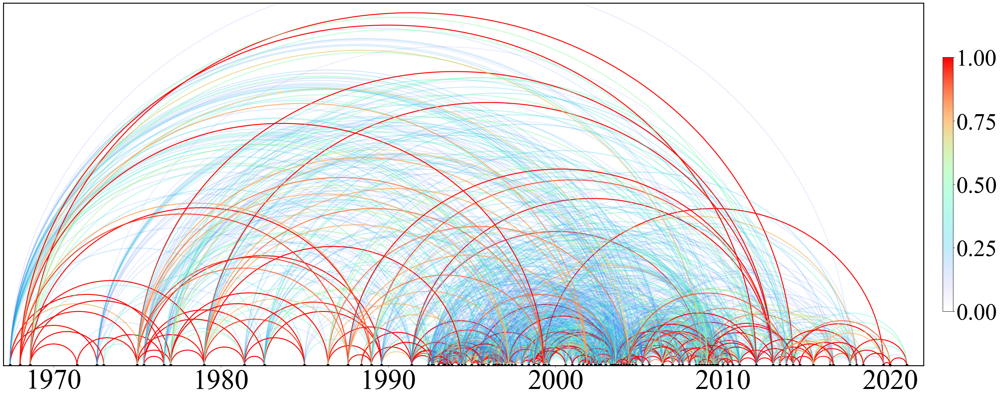

In [57]:
time_breaks = [1970, 1980, 1990, 2000, 2010, 2020]  # or any ticks you prefer
arc_plot_styled(combined_groups_with_importance, virus_years, time_breaks)


### Fig S5

In [62]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors

def plot_heatmap(importance_dict_combined, virus_years, transparency_factor=2.5, save_path=None):
    """
    Plots a heatmap of virus importance, with viruses sorted by year and less important ones more transparent.
    All axis labels, title, and legend are set to bold.
    """
    # Sort viruses by year
    all_viruses = sorted(virus_years, key=lambda v: virus_years[v])
    virus_idx = {v: i for i, v in enumerate(all_viruses)}

    importance_matrix = np.zeros((len(all_viruses), len(all_viruses)))

    for dataset in importance_dict_combined.values():
        for virus, relations in dataset.items():
            for related_virus, importance in relations.items():
                if virus in virus_idx and related_virus in virus_idx:
                    i, j = virus_idx[virus], virus_idx[related_virus]
                    importance_matrix[i, j] = importance

    # Normalize importance to 0–1 and scale for transparency
    norm_importance = (importance_matrix - importance_matrix.min()) / (importance_matrix.max() - importance_matrix.min())
    alpha_matrix = np.clip(norm_importance * transparency_factor, 0, 1)

    # Create a custom RGBA color map array
    cmap = plt.get_cmap("rainbow")
    rgba_matrix = np.empty((*importance_matrix.shape, 4))
    for i in range(importance_matrix.shape[0]):
        for j in range(importance_matrix.shape[1]):
            base_color = cmap(norm_importance[i, j])
            rgba_matrix[i, j] = (base_color[0], base_color[1], base_color[2], alpha_matrix[i, j])

    # Plot with imshow instead of sns.heatmap to allow alpha control
    fig, ax = plt.subplots(figsize=(50, 45))
    ax.imshow(rgba_matrix, aspect='auto', interpolation='none')

    # Set ticks and labels
    ax.set_xticks(np.arange(len(all_viruses)))
    ax.set_yticks(np.arange(len(all_viruses)))
    ax.set_xticklabels(all_viruses, rotation=90, fontsize=20)
    ax.set_yticklabels(all_viruses, fontsize=20)
    ax.set_xlabel('')#Selected Viruses (Sorted by Year)', fontsize=60)
    ax.set_ylabel('')#Target Viruses (Sorted by Year)', fontsize=60)

    # # Add colorbar manually
    # norm = mcolors.Normalize(vmin=0, vmax=1)
    # sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    # sm.set_array([])
    # cbar = plt.colorbar(sm, ax=ax, fraction=0.02, pad=0.01)
    # cbar.set_label('', fontsize=30)
    # cbar.ax.yaxis.set_tick_params(labelsize=40, labelcolor='black', width=2)
    # cbar.ax.yaxis.label.set_fontweight('bold')
    # Build custom colormap for colorbar with matching alpha effect
        # Set fading to start from 0.1 (your actual minimum importance)
    vmin = 0.0
    vmax = 1.0

    # Build custom colormap with alpha that starts fading from 0.1
    color_vals = np.linspace(vmin, vmax, 256)
    colors = [(*cmap((val - vmin) / (vmax - vmin))[:3], np.clip((val - vmin) / (vmax - vmin) * transparency_factor, 0, 1))
              for val in color_vals]
    faded_cmap = mcolors.ListedColormap(colors)

    # Normalize using vmin and vmax
    norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
    sm = plt.cm.ScalarMappable(cmap=faded_cmap, norm=norm)
    sm.set_array([])

    # Add the colorbar
    cbar = plt.colorbar(sm, ax=ax, fraction=0.03, pad=0.03)
    cbar.set_label('', fontsize=30)
    cbar.ax.yaxis.set_tick_params(labelsize=50, labelcolor='black', width=2)
    cbar.ax.yaxis.label.set_fontweight('normal')

    # Save if needed
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')

    plt.show()


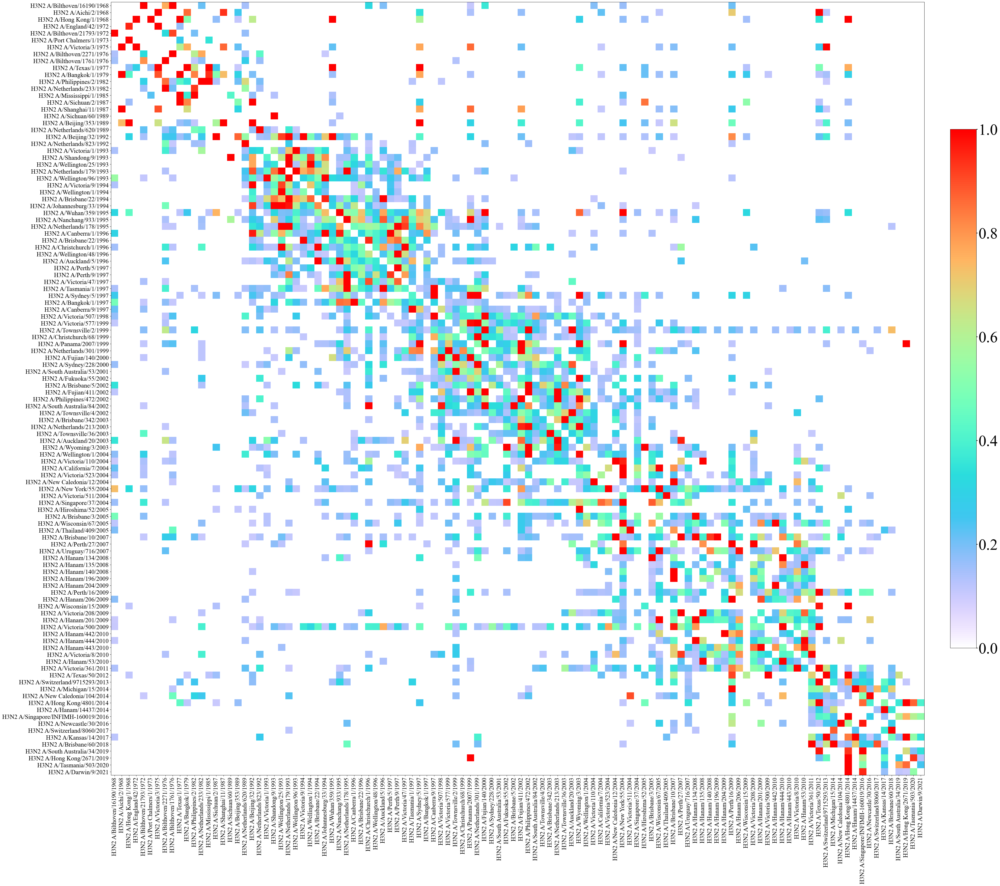

In [64]:
save_path = 'Figures/Panels/FigS5.png'

plot_heatmap(
    importance_dict_combined=importance_dict_combined,
    virus_years=virus_years,
    transparency_factor=3.0,  # tweak this to reduce or increase fading
    save_path=save_path
)


### Fig 5C and 5D

In [ ]:
from Capybara.utils import load_json

combined_virus_groups_dict = load_json("results/virus_groups_all_datasets.json")
importance_dict_combined = load_json("results/importance_virus_groups.json")


In [44]:
from Capybara.ridge_equations import (
    ThresholdEquationBuilder,
    EquationEvaluator,
    EquationAverager,
)
# You have:
#   dataset_dict = { "DatasetA": dfA, "DatasetB": dfB, ... }
#   combined_virus_groups_dict = { "DatasetA": {...}, "DatasetB": {...}, ... }

builder = ThresholdEquationBuilder(
    dataset_dict=dataset_dict,
    combined_virus_groups_dict=combined_virus_groups_dict,
    desired_thresh=0.2,
    fallback_step=0.05,
    store_refit_only=True  # or True if you only want the refit approach
)
equations_df = builder.build_equations_dataframe()
# -------------------------------------------------------------
# Format the results: pivot, sort, clean, etc.
# -------------------------------------------------------------
#formatter = EquationDataFrameFormatter(equations_df)
def sorted_feature_tuple(feat_list):
    """
    Return a sorted tuple of features so that the order doesn't affect grouping.
    For example, ["virusA", "virusB"] and ["virusB", "virusA"] both become ("virusA", "virusB").
    """
    return tuple(sorted(feat_list))

# Assume equations_df has columns:
# ["Dataset", "Target Virus", "Features", "Coefficients", "Intercept", ...]
# Compute a new column for the sorted feature tuple.
equations_df["Feature Tuple"] = equations_df["Features"].apply(sorted_feature_tuple)

# Define grouping columns: each unique combination of target virus and feature set
group_cols = ["Target Virus", "Feature Tuple"]

# List to store averaged equation results
grouped_list = []

for (tgt_virus, feat_tuple), group_df in equations_df.groupby(group_cols):
    # Average the intercepts
    intercept_avg = group_df["Intercept"].mean()
    
    # Average the coefficients.
    # We assume the "Coefficients" column contains lists of floats.
    coeffs_array = np.array(group_df["Coefficients"].tolist())
    coeffs_avg = coeffs_array.mean(axis=0)  # average element-wise
    
    # Optionally, store the set of source datasets that contributed to this group.
    source_ds_set = set(group_df["Dataset"].unique())
    
    grouped_list.append({
        "Target Virus": tgt_virus,
        "Feature Tuple": feat_tuple,
        "Intercept Avg": intercept_avg,
        "Coefficients Avg": coeffs_avg,
        "Source Datasets": source_ds_set
    })

# Create the averaged equations DataFrame
averaged_eqns_df = pd.DataFrame(grouped_list)

print("Averaged Equations DataFrame:")
print(averaged_eqns_df.head())


Averaged Equations DataFrame:
              Target Virus                                      Feature Tuple  \
0      H3N2 A/Aichi/2/1968  (H3N2 A/Bangkok/1/1979, H3N2 A/Panama/2007/199...   
1      H3N2 A/Aichi/2/1968    (H3N2 A/Bangkok/1/1979, H3N2 A/Victoria/3/1975)   
2      H3N2 A/Aichi/2/1968       (H3N2 A/Perth/16/2009, H3N2 A/Texas/50/2012)   
3  H3N2 A/Auckland/20/2003  (H3N2 A/Brisbane/10/2007, H3N2 A/Brisbane/342/...   
4  H3N2 A/Auckland/20/2003  (H3N2 A/Brisbane/22/1996, H3N2 A/New Caledonia...   

   Intercept Avg                                   Coefficients Avg  \
0       0.196110  [0.6538265459542091, -0.037872382920650226, 0....   
1       0.163684          [0.4520358626722062, 0.45203586267220636]   
2       0.768157         [-0.1697359263690458, 0.24610640621619548]   
3       0.222792  [-0.3287279439374032, -0.2732097030700031, -0....   
4      -0.166778  [0.19394668987963215, 0.20784517632192961, -0....   

  Source Datasets  
0    {2015 Hin_V}  
1    {2014 Hin_V

In [ ]:
import numpy as np
import pandas as pd
from sklearn.metrics import mean_squared_error, r2_score
import re
def shorten_virus_name(virus_name):
    """
    Shorten a virus name by removing common prefixes and returning the location and year.
    For example, 'H3N2 A/Darwin/9/2021' becomes 'Darwin 2021'.
    """
    # Remove common prefixes
    virus_name = virus_name.replace("H3N2 ", "")
    if virus_name.startswith("A/"):
        virus_name = virus_name[2:]
    
    parts = virus_name.split("/")
    if len(parts) >= 2:
        return f"{parts[0]} {parts[-1]}"
    else:
        return virus_name
# --------------------------------------------------------------------- #
# 1.  Helper – evaluate a multi-virus linear equation on any dataset
# --------------------------------------------------------------------- #
def evaluate_equation_on_dataset(df, target, features, coefs, intercept):
    """
    Returns (y_true_log, y_pred_log, rmse, r2) or None if required columns
    are missing.
    """
    required_cols = [target, *features]
    if not all(col in df.columns for col in required_cols):
        return None

    y_true = df[target].values
    y_pred = intercept + sum(c * df[f].values for c, f in zip(coefs, features))

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    r2   = r2_score(y_true, y_pred)
    return y_true, y_pred, rmse, r2


# --------------------------------------------------------------------- #
# 2.  Vaccine strains of interest  (define *once*, use everywhere)
# --------------------------------------------------------------------- #
VACCINE_STRAINS = [
    "H3N2 A/Hong Kong/4801/2014",
    "H3N2 A/Switzerland/9715293/2013",
    "H3N2 A/Kansas/14/2017",
    "H3N2 A/Victoria/361/2011",
    "H3N2 A/Perth/16/2009",
    "H3N2 A/Singapore/INFIMH-160019/2016",
    "H3N2 A/Darwin/9/2021",
    "H3N2 A/Texas/50/2012",
    "H3N2 A/Hong Kong/2671/2019",
    "H3N2 A/Brisbane/10/2007",
    "H3N2 A/Wisconsin/67/2005",
    "H3N2 A/Tasmania/503/2020",
    "H3N2 A/California/7/2004",
    "H3N2 A/New York/55/2004",
]

PATTERN_VACCINE = "|".join(map(re.escape, VACCINE_STRAINS))


# --------------------------------------------------------------------- #
# 3.  Filter equation table down to H3N2 vaccine-strain targets
# --------------------------------------------------------------------- #
#`equations_df` has cols:
# ["Dataset", "Target Virus", "Features", "Coefficients", "Intercept"]
mask_vaccine_target = equations_df["Target Virus"].str.contains(PATTERN_VACCINE, na=False)
vaccine_eqns_df = equations_df[mask_vaccine_target].copy()

# --------------------------------------------------------------------- #
# 4.  Apply each vaccine equation to *every* external dataset
# --------------------------------------------------------------------- #
prediction_rows = []

for eq_id, row in vaccine_eqns_df.iterrows():
    train_ds   = row["Dataset"]
    tgt        = row["Target Virus"]
    feats      = row["Features"]
    coefs      = row["Coefficients"]
    intercept  = row["Intercept"]

    for test_ds, df_test in dataset_dict.items():
        if test_ds == train_ds:
            continue  # external evaluation only

        eval_out = evaluate_equation_on_dataset(df_test, tgt, feats, coefs, intercept)
        if eval_out is None:
            continue

        y_true_log, y_pred_log, rmse, r2 = eval_out
        for subj, y_t, y_p in zip(df_test.index, y_true_log, y_pred_log):
            prediction_rows.append({
                "Equation ID"   : eq_id,
                "Train Dataset" : train_ds,
                "Test Dataset"  : test_ds,
                "Subject"       : subj,
                "Target Virus"  : tgt,
                "Measured_Log2" : y_t,
                "Predicted_Log2": y_p
            })

vaccine_preds_df = pd.DataFrame(prediction_rows)

# --------------------------------------------------------------------- #
# 5.  Aggregate predictions → one row per (dataset × subject × virus)
# --------------------------------------------------------------------- #
avg_preds_df = (
    vaccine_preds_df
        .groupby(["Test Dataset", "Subject", "Target Virus"], as_index=False)
        .agg({"Predicted_Log2": "mean", "Measured_Log2": "first"})
)
avg_preds_df["Predicted_Raw"] = 5 * (2 ** avg_preds_df["Predicted_Log2"])
avg_preds_df["Measured_Raw"]  = 5 * (2 ** avg_preds_df["Measured_Log2"])

# --------------------------------------------------------------------- #
# 6.    Best 5-virus subset cover analysis
#     (kept exactly once, with no self-predicting equations)
# --------------------------------------------------------------------- #
from collections import defaultdict
from itertools import combinations

# `averaged_eqns_df` assumed available with columns:
# ["Target Virus", "Feature Tuple", "Intercept Avg", "Coefficients Avg", ...]
mask_vaccine_target = averaged_eqns_df["Target Virus"].isin(VACCINE_STRAINS)
vaccine_averaged_eqns_df = averaged_eqns_df[mask_vaccine_target].copy()

def is_self_predicting(row):
    return row["Target Virus"] in row["Feature Tuple"]

vaccine_averaged_eqns_df = vaccine_averaged_eqns_df[~vaccine_averaged_eqns_df.apply(is_self_predicting, axis=1)]

# Build coverage dictionary: feature-set → vaccine targets it can predict
coverage = defaultdict(set)
for _, r in vaccine_averaged_eqns_df.iterrows():
    coverage[frozenset(r["Feature Tuple"])].add(r["Target Virus"])

all_predictors = sorted({v for ft in coverage for v in ft})

best_subset, best_covered = None, set()
for combo in combinations(all_predictors, 5):
    S = set(combo)
    covered = {t for ft, tgts in coverage.items() if ft.issubset(S) for t in tgts if t not in S}
    if len(covered) > len(best_covered):
        best_subset, best_covered = S, covered

print("\nBest 5-virus subset:", best_subset)
print("   Covers", len(best_covered), "other vaccine strains")

# Filter equations to those feasible under best subset
feasible_eqns = vaccine_averaged_eqns_df[
    vaccine_averaged_eqns_df["Feature Tuple"].apply(lambda ft: set(ft).issubset(best_subset)) &
    (~vaccine_averaged_eqns_df["Target Virus"].isin(best_subset))
].copy()

# Re-evaluate feasible equations externally
filtered_rows = []
for idx, r in feasible_eqns.iterrows():
    tgt, feats, intercept, coeffs, source_ds = (
        r["Target Virus"], r["Feature Tuple"], r["Intercept Avg"], r["Coefficients Avg"], r.get("Source Datasets", set())
    )
    for test_ds, df_test in dataset_dict.items():
        if test_ds in source_ds:
            continue
        eval_out = evaluate_equation_on_dataset(df_test, tgt, feats, coeffs, intercept)
        if eval_out is None:
            continue
        y_true_log, y_pred_log, _, _ = eval_out
        for subj, y_t, y_p in zip(df_test.index, y_true_log, y_pred_log):
            filtered_rows.append({
                "Equation ID"   : idx,
                "Test Dataset"  : test_ds,
                "Subject"       : subj,
                "Target Virus"  : tgt,
                "Measured_Log2" : y_t,
                "Predicted_Log2": y_p
            })

filtered_eqn_predictions = pd.DataFrame(filtered_rows)
filtered_perf_df = (
    filtered_eqn_predictions
        .groupby(["Test Dataset", "Subject", "Target Virus"], as_index=False)
        .agg({"Predicted_Log2": "mean", "Measured_Log2": "first"})
)
filtered_perf_df["Predicted_Raw"] = 5 * (2 ** filtered_perf_df["Predicted_Log2"])
filtered_perf_df["Measured_Raw"]  = 5 * (2 ** filtered_perf_df["Measured_Log2"])

print("\nPerformance with best 5-virus subset:")
print(filtered_perf_df.head())



 Vaccine-strain equations found:
      Dataset              Target Virus
8   1997 Fonv   H3N2 A/Brisbane/10/2007
14  1997 Fonv  H3N2 A/California/7/2004
32  1997 Fonv   H3N2 A/New York/55/2004
34  1997 Fonv      H3N2 A/Perth/16/2009
53  1997 Fonv  H3N2 A/Victoria/361/2011

Best 5-virus subset: {'H3N2 A/Hong Kong/4801/2014', 'H3N2 A/Hong Kong/2671/2019', 'H3N2 A/Victoria/8/2010', 'H3N2 A/Wisconsin/67/2005', 'H3N2 A/Wisconsin/15/2009'}
   Covers 10 other vaccine strains

Performance with best 5-virus subset:
  Test Dataset                                         Subject  \
0    1997 Fonv   Subject106Age19_1997Fonville_S5_1997Fonv_Day0   
1    1997 Fonv   Subject106Age19_1997Fonville_S5_1997Fonv_Day0   
2    1997 Fonv   Subject106Age19_1997Fonville_S5_1997Fonv_Day0   
3    1997 Fonv   Subject106Age19_1997Fonville_S5_1997Fonv_Day0   
4    1997 Fonv  Subject106Age19_1997Fonville_S5_1997Fonv_Day28   

               Target Virus  Predicted_Log2  Measured_Log2  Predicted_Raw  \
0   H3N2 A/Br

In [46]:
import matplotlib.pyplot as plt
import re

# --- tiny helpers -------------------------------------------------
def extract_year(name: str) -> int:
    m = re.findall(r"(\d{4})", name)
    return int(m[-1]) if m else 9999

def build_color_map(*dfs, col="Target Virus", cmap_name="tab20"):
    """
    Return {virus → RGBA tuple} spanning every virus that appears in the
    provided DataFrames (looked up in `col`).
    """
    # unique viruses across all frames
    all_viruses = sorted(
        set().union(*(df[col].unique() for df in dfs)),
        key=extract_year                    # order by year for nicer palette
    )
    cmap = plt.cm.get_cmap(cmap_name, len(all_viruses))
    return {v: cmap(i) for i, v in enumerate(all_viruses)}

# ------------------------------------------------------------------
# now it will work
color_map = build_color_map(avg_preds_df, filtered_perf_df)


C:\Users\sorsinelli\AppData\Local\Temp\ipykernel_37856\252592279.py:19: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap(cmap_name, len(all_viruses))


In [47]:
plt.rcParams["font.family"] = "Times New Roman"
def scatter_plot(df, title="", jitter=0.08,
                 meas="Measured_Raw", pred="Predicted_Raw", tgt="Target Virus"):

    plt.figure(figsize=(15, 15))

    for virus in sorted(df[tgt].unique(), key=extract_year):
        sub = df[df[tgt] == virus]
        m = sub[meas].values * (1 + np.random.normal(0, jitter, len(sub)))
        p = sub[pred].values * (1 + np.random.normal(0, jitter, len(sub)))
        plt.scatter(m, p, color=color_map[virus], alpha=0.3)

    # legend
    handles = [plt.scatter([], [], color=color_map[v], label=shorten_virus_name(v))
               for v in sorted(df[tgt].unique(), key=extract_year)]
    legend = plt.legend(
    handles=handles,
    bbox_to_anchor=(1.01, 1),
    loc="upper left",
    title="Target Virus",
    markerscale=2,
    fontsize=18,
    title_fontsize=18,
    handletextpad=0.0
    )
    legend.get_frame().set_linewidth(2.0)  # Legend border thickness
    legend.get_frame().set_edgecolor("black")  # Optional: set color


    # axes, RMSE annotation
    plt.xscale("log", base=2); plt.yscale("log", base=2)
    plt.xlim(5, 5120);          plt.ylim(5, 5120)
    ticks = [5 * (2 ** i) for i in range(0, 11, 2)]
    plt.xticks(ticks, ticks, fontsize=40); plt.yticks(ticks, ticks, fontsize=40)
    plt.tick_params(
        direction='in',    # ticks point inward
        length=12,         # length of the ticks
        width=4,           # thickness of the ticks
        which='both'       # apply to both major and minor ticks
    )

    rmse_fold = 2 ** np.sqrt(mean_squared_error(df["Measured_Log2"], df["Predicted_Log2"]))
    plt.text(0.03, 0.97, fr"$\sigma_{{\rm Actual}}$ = {rmse_fold:.1f}x" + f"\n$N$ = {len(df)}",
             transform=plt.gca().transAxes, fontsize=45, va="top", linespacing=2.0,
             bbox=dict(fc="white", alpha=0.6, ec="none"))

    low, high = df[[meas, pred]].min().min(), df[[meas, pred]].max().max()
    plt.plot([low, high], [low, high], "k--", lw=2)
    ax = plt.gca()
    for spine in ax.spines.values():
        spine.set_linewidth(2.5)  # Thicker border
        spine.set_edgecolor("black")  # Make sure it's black

    plt.gca().set_aspect("equal", adjustable="box")
    plt.title(title); plt.tight_layout(); plt.show()


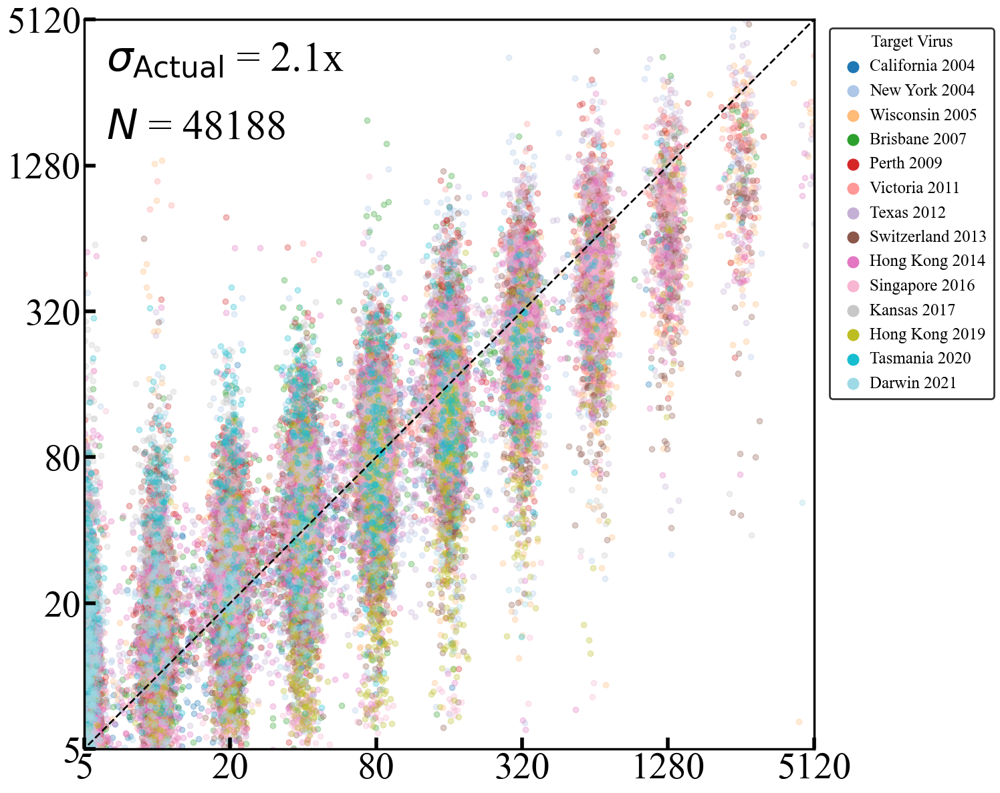

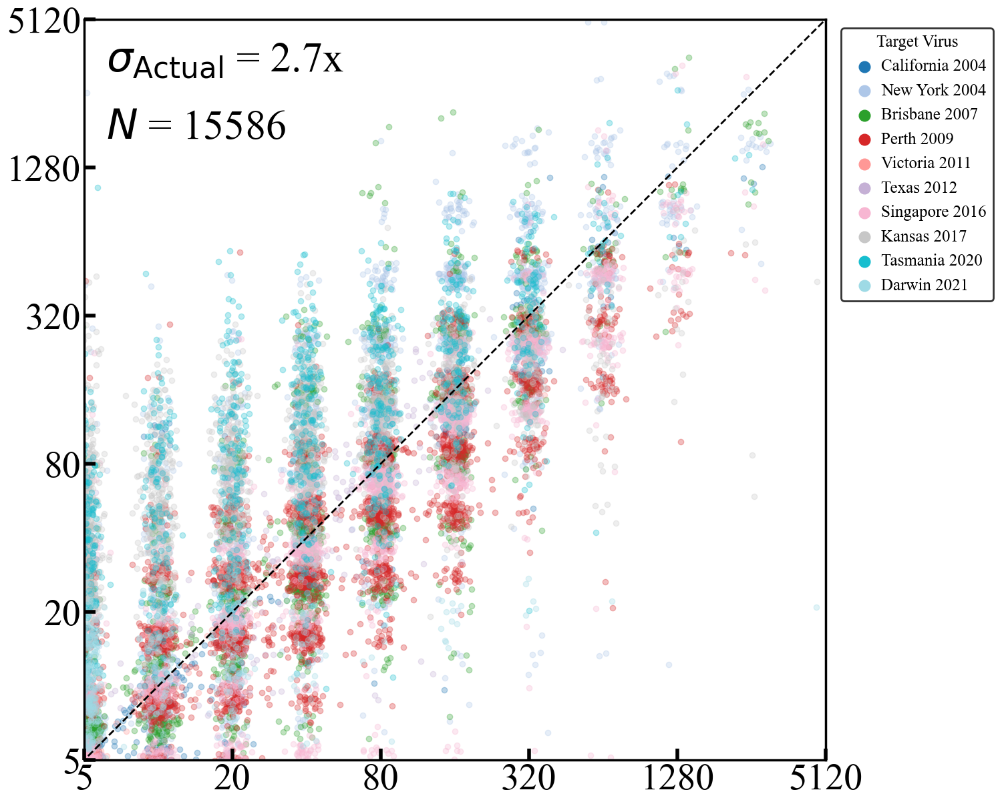

In [48]:
scatter_plot(avg_preds_df)
            # title="Measured vs Predicted – All Vaccine Strains")

scatter_plot(filtered_perf_df)
             #title="Measured vs Predicted – Vaccine Targets (5-virus subset)")


### SI Table with Ridge Equations

In [ ]:
import re
import numpy as np
import pandas as pd
from Capybara.ridge_equations import (
    ThresholdEquationBuilder,
    EquationEvaluator,
    EquationAverager,
)
from sklearn.metrics import mean_squared_error, r2_score

def evaluate_equation_on_dataset(
    df_dataset, 
    target_virus, 
    feature_viruses, 
    coefficients, 
    intercept
):
    """
    Evaluate the multi-virus equation:
        y_pred = intercept + sum(coeff_i * X(feature_viruses[i]))
    on df_dataset. Returns (rmse, r2) or None if columns are missing.
    """
    # Check presence of required columns
    if target_virus not in df_dataset.columns:
        return None
    for feat in feature_viruses:
        if feat not in df_dataset.columns:
            return None

    y_true = df_dataset[target_virus].values

    # Build predictions
    y_pred = intercept
    for coef, feat in zip(coefficients, feature_viruses):
        X_feat = df_dataset[feat].values
        y_pred += coef * X_feat

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    r2   = r2_score(y_true, y_pred)
    return (rmse, r2)

# ------------------------------------------------------------------ #
# 1.  Build the raw equation DataFrame
# ------------------------------------------------------------------ #
builder = ThresholdEquationBuilder(
    dataset_dict              = dataset_dict,
    combined_virus_groups_dict= combined_virus_groups_dict,
    desired_thresh            = 0.20,
    fallback_step             = 0.05,
    store_refit_only          = True,       # ← change if you need both versions
)
equations_df = builder.build_equations_dataframe()

# normalise feature order so identical sets collapse together
equations_df["Feature Tuple"] = equations_df["Features"].apply(lambda lst: tuple(sorted(lst)))

# ------------------------------------------------------------------ #
# 2.  Average intercept / coefficients across identical (target, feat-set)
# ------------------------------------------------------------------ #
grouped = (
    equations_df
      .groupby(["Target Virus", "Feature Tuple"])
)

def _avg_coeffs(arr_of_lists: list[list[float]]) -> np.ndarray:
    return np.vstack(arr_of_lists).mean(axis=0)

averaged_eqns_df = (
    grouped
      .agg(
          Intercept_Avg    = ("Intercept",   "mean"),
          Coefficients_Avg = ("Coefficients", _avg_coeffs),
          Source_Datasets  = ("Dataset",     lambda s: set(s))
      )
      .reset_index()
)

# ------------------------------------------------------------------ #
# 3.  Human-readable equation string + feature counts and Ensure viruses are ordered by   (# features first ,  year newest firts)
# ------------------------------------------------------------------ #
def build_equation_string(intercept, features, coeffs):
    terms = [f"{intercept:+.2f}"] + [f"({c:+.2f})·{f}" for c, f in zip(coeffs, features)]
    return " + ".join(terms)

averaged_eqns_df["EquationStr"]  = averaged_eqns_df.apply(
    lambda r: build_equation_string(r["Intercept_Avg"], r["Feature Tuple"], r["Coefficients_Avg"]),
    axis=1
)
averaged_eqns_df["Num_Features"] = averaged_eqns_df["Feature Tuple"].str.len()

def extract_year(name: str) -> int:
    """Return the last 4-digit year in the virus name (or +∞ if none)."""
    yrs = re.findall(r"\d{4}", name)
    return int(yrs[-1]) if yrs else float("inf")

# • smallest feature-count needed for each target virus
min_feat = (
    averaged_eqns_df
      .groupby("Target Virus")["Num_Features"]
      .min()
      .rename("MinCount")
)

averaged_eqns_df = (
    averaged_eqns_df
      .merge(min_feat, on="Target Virus")
      .assign(VirusYear=lambda d: d["Target Virus"].apply(extract_year))
      .sort_values(["MinCount", "VirusYear"], ascending=[True, False])
)

# ------------------------------------------------------------------ #
# 4.  Pivot so each virus gets a compact equation table  (unchanged)
# ------------------------------------------------------------------ #
pivot_df = (
    averaged_eqns_df
      .assign(EqIndex=lambda d: d.groupby(["Target Virus", "Num_Features"]).cumcount() + 1)
      .pivot_table(
          index   = "Target Virus",
          columns = ["Num_Features", "EqIndex"],
          values  = "EquationStr",
          aggfunc = "first"
      )
)

# keep the row order we just sorted by
pivot_df = pivot_df.reindex(averaged_eqns_df["Target Virus"].unique())

# Flatten the MultiIndex columns:  2Feats_Eq1, 3Feats_Eq2, …
pivot_df.columns = [f"{n}Feats_Eq{idx}" for n, idx in pivot_df.columns]
pivot_df.reset_index(inplace=True)


# ------------------------------------------------------------------ #
# 5.  Evaluate each averaged equation on *external* datasets
# ------------------------------------------------------------------ #
perf_rows = []

for _, row in averaged_eqns_df.iterrows():
    tgt                 = row["Target Virus"]
    feats, coeffs       = row["Feature Tuple"], row["Coefficients_Avg"]
    intercept           = row["Intercept_Avg"]
    src_sets            = row["Source_Datasets"]

    for ds_name, df_test in dataset_dict.items():
        if ds_name in src_sets:          # skip internal datasets
            continue

        out = evaluate_equation_on_dataset(df_test, tgt, feats, coeffs, intercept)
        if out is None:
            continue

        rmse, r2 = out          # ← only two values returned
        perf_rows.append({
            "Target Virus": tgt,
            "EquationStr" : row["EquationStr"],
            "Test Dataset": ds_name,
            "RMSE"        : rmse,
            "R2"          : r2,
        })

eqn_perf_df = pd.DataFrame(perf_rows)


# ------------------------------------------------------------------ #
# 6.  Build a mirror-shaped RMSE DataFrame matching the equation table
#     (use ×-fold space = 2^RMSE, as in your earlier code)
# ------------------------------------------------------------------ #
rmse_lookup = (
    eqn_perf_df
      .groupby(["Target Virus", "EquationStr"])["RMSE"]
      .median()
      .to_dict()
)

colors_df = pivot_df.copy()
for virus_idx, virus in enumerate(colors_df["Target Virus"]):
    for col in colors_df.columns[1:]:
        eq_str = colors_df.at[virus_idx, col]
        rmse   = rmse_lookup.get((virus, eq_str))
        colors_df.at[virus_idx, col] = 2 ** rmse if rmse is not None else np.nan

# ------------------------------------------------------------------ #
# 7.  Write an Excel workbook with conditional-formatted colours
# ------------------------------------------------------------------ #
from xlsxwriter.utility import xl_range
out_path = "virus_equations_colour.xlsx"

with pd.ExcelWriter(out_path, engine="xlsxwriter") as xw:
    pivot_df.to_excel(  xw, sheet_name="Equations", index=False)
    colors_df.to_excel( xw, sheet_name="Colors",    index=False)

    ws = xw.sheets["Colors"]
    n_rows, n_cols = colors_df.shape
    data_rng = xl_range(1, 1, n_rows, n_cols - 1)

    ws.conditional_format(data_rng, {
        "type"     : "3_color_scale",
        "min_type" : "num", "min_value": colors_df.iloc[:, 1:].min().min(),
        "mid_type" : "num", "mid_value": 3,
        "max_type" : "num", "max_value": 5,
        "min_color": "#228B22",   # green
        "mid_color": "#FFFF00",   # yellow
        "max_color": "#FF0000",   # red
    })

print(f"Workbook saved to {out_path}")


Workbook saved to virus_equations_colour.xlsx


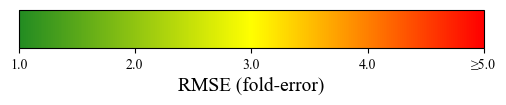

In [51]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

# Custom colormap: green → yellow → red
cmap = mcolors.LinearSegmentedColormap.from_list("rmse_scale", [
    (0.0, "#228B22"),   # green @ RMSE = 1
    (0.5, "#FFFF00"),   # yellow @ RMSE ≈ 3
    (1.0, "#FF0000"),   # red @ RMSE = 5+
])

# Normalize between 1 and 5
norm = mcolors.Normalize(vmin=1, vmax=5)

fig, ax = plt.subplots(figsize=(6, 1))
fig.subplots_adjust(bottom=0.5)

cb = plt.colorbar(
    plt.cm.ScalarMappable(norm=norm, cmap=cmap),
    cax=ax,
    orientation='horizontal'
)

cb.set_label('RMSE (fold-error)', fontsize=14)
cb.set_ticks([1, 2, 3, 4, 5])
cb.set_ticklabels(['1.0', '2.0', '3.0', '4.0', '≥5.0'])  # customize last tick

plt.savefig("rmse_color_key_capped.png", dpi=300, bbox_inches='tight')
plt.show()


### Fig 5B Vaccine Equations Table

In [ ]:
#   dataset_dict = { "DatasetA": dfA, "DatasetB": dfB, ... }
#   combined_virus_groups_dict = { "DatasetA": {...}, "DatasetB": {...}, ... }

builder = ThresholdEquationBuilder(
    dataset_dict=dataset_dict,
    combined_virus_groups_dict=combined_virus_groups_dict,
    desired_thresh=0.2,
    fallback_step=0.05,
    store_refit_only=True  # or True if you only want the refit approach
)

equations_df = builder.build_equations_dataframe()
print("Raw results with thresholds, intercepts, etc.:")
print(equations_df.head(10))

def sorted_feature_tuple(feat_list):
    """
    Return a sorted tuple of features so that the order doesn't affect grouping.
    For example, ["virusA", "virusB"] and ["virusB", "virusA"] both become ("virusA", "virusB").
    """
    return tuple(sorted(feat_list))

# Assume equations_df has columns:
# ["Dataset", "Target Virus", "Features", "Coefficients", "Intercept", ...]
# Compute a new column for the sorted feature tuple.
equations_df["Feature Tuple"] = equations_df["Features"].apply(sorted_feature_tuple)

# Define grouping columns: each unique combination of target virus and feature set
group_cols = ["Target Virus", "Feature Tuple"]
grouped_list = []
for (tgt_virus, feat_tuple), group_df in equations_df.groupby(group_cols):
    # Each group_df has the same set of features (in sorted order).
    
    # Collect intercepts
    intercepts = group_df["Intercept"].values
    
    # Collect coefficients: an array of lists
    # e.g. [ [0.5, 1.2], [0.4, 1.0], ... ]
    # We'll stack them or just do element-wise sums
    all_coeffs = group_df["Coefficients"].tolist()
    # Convert to a 2D numpy array for easy averaging
    coeff_array = np.array(all_coeffs)  # shape = (num_equations_in_group, num_features_in_tuple)
    
    intercept_avg = np.mean(intercepts)
    coeffs_avg    = coeff_array.mean(axis=0)  # element-wise average across all rows in group

    # Also gather the set of source datasets
    source_ds_set = set(group_df["Dataset"].unique())
    
    grouped_list.append({
        "Target Virus": tgt_virus,
        "Feature Tuple": feat_tuple,
        "Intercept Avg": intercept_avg,
        "Coefficients Avg": coeffs_avg,  # e.g. np.array
        "Source Datasets": source_ds_set
    })

averaged_eqns_df = pd.DataFrame(grouped_list)
print("Averaged multi-virus equations:\n", averaged_eqns_df.head(10))
def build_equation_string(intercept, features, coefficients):
    """
    Return a string like: "+0.32 + (+0.98)·VirusA + (+0.55)·VirusB"
    """
    eq_str = f"{intercept:+.2f}"  # e.g. "+0.30" or "-0.12"
    for c, f in zip(coefficients, features):
        eq_str += f" + ({c:+.2f})·{f}"
    return eq_str

averaged_eqns_df["EquationStr"] = averaged_eqns_df.apply(
    lambda row: build_equation_string(
        row["Intercept Avg"],
        row["Feature Tuple"],
        row["Coefficients Avg"]
    ),
    axis=1
)

# Also store how many features
averaged_eqns_df["Num_Features"] = averaged_eqns_df["Feature Tuple"].apply(len)

averaged_eqns_df.sort_values(["Target Virus", "Num_Features", "Feature Tuple"], inplace=True)

averaged_eqns_df["EqIndex"] = (
    averaged_eqns_df
    .groupby(["Target Virus", "Num_Features"])
    .cumcount()  # 0-based
    + 1          # make it 1-based
)


Raw results with thresholds, intercepts, etc.:
     Dataset                 Target Virus Approach  Effective Threshold  \
0  1997 Fonv      H3N2 A/Auckland/20/2003    Refit                  0.2   
1  1997 Fonv       H3N2 A/Auckland/5/1996    Refit                  0.2   
2  1997 Fonv        H3N2 A/Bangkok/1/1997    Refit                  0.2   
3  1997 Fonv       H3N2 A/Beijing/32/1992    Refit                  0.2   
4  1997 Fonv  H3N2 A/Bilthoven/16190/1968    Refit                  0.2   
5  1997 Fonv   H3N2 A/Bilthoven/1761/1976    Refit                  0.2   
6  1997 Fonv  H3N2 A/Bilthoven/21793/1972    Refit                  0.2   
7  1997 Fonv   H3N2 A/Bilthoven/2271/1976    Refit                  0.2   
8  1997 Fonv      H3N2 A/Brisbane/10/2007    Refit                  0.2   
9  1997 Fonv      H3N2 A/Brisbane/22/1994    Refit                  0.2   

   Intercept                                           Features  \
0  -0.166778  [H3N2 A/New Caledonia/12/2004, H3N2 A/Victoria

In [40]:
pivot_df = averaged_eqns_df.pivot_table(
    index="Target Virus",
    columns=["Num_Features", "EqIndex"],
    values="EquationStr",
    aggfunc="first"  # There's only one row per (Target,Feature Tuple) anyway
)
# Flatten the multi-level columns into single strings
flattened_cols = []
for (num_feats, eq_idx) in pivot_df.columns:
    col_name = f"{num_feats}Feats_Eq{eq_idx}"
    flattened_cols.append(col_name)

pivot_df.columns = flattened_cols
pivot_df.reset_index(inplace=True)

# Function to extract the last 4-digit number as the year
def extract_year(virus_name):
    # This finds all 4-digit numbers and returns the last one
    matches = re.findall(r'\d{4}', virus_name)
    return int(matches[-1]) if matches else float('inf')

# 1) Compute the minimum number of features for each target virus
min_features_df = averaged_eqns_df.groupby("Target Virus")["Num_Features"].min().reset_index(name="MinCount")

# 2) Merge this with your pivot table (pivot_df)
pivot_df = pivot_df.merge(min_features_df, on="Target Virus", how="left")

# 3) Extract the virus year and add it as a new column
pivot_df["Virus Year"] = pivot_df["Target Virus"].apply(extract_year)

# 4) Sort by 'MinCount' (ascending: viruses with equations having 1 feature come first)
#    and then by 'Virus Year' (descending: more recent viruses come first)
pivot_df.sort_values(["MinCount", "Virus Year"], ascending=[True, False], inplace=True)

# Optionally, if you no longer need the helper columns, drop them:
pivot_df.drop(columns=["MinCount", "Virus Year"], inplace=True)

In [50]:
import pandas as pd

# --- Step 1: Filter pivot_df for vaccine strains ---
vaccine_strain_keywords = [
    "H3N2 A/Hong Kong/4801/2014",
    "H3N2 A/Switzerland/9715293/2013",
    "H3N2 A/Kansas/14/2017",
    "H3N2 A/Victoria/361/2011",
    "H3N2 A/Perth/16/2009",
    "H3N2 A/Singapore/INFIMH-160019/2016",
    "H3N2 A/Darwin/9/2021",
    "H3N2 A/Texas/50/2012",
    "H3N2 A/Hong Kong/2671/2019",
    "H3N2 A/Brisbane/10/2007",
    "H3N2 A/Wisconsin/67/2005",
    "H3N2 A/Tasmania/503/2020",
    "H3N2 A/California/7/2004",
    "H3N2 A/New York/55/2004"
]

# Assuming pivot_df has a column "Target Virus", filter the rows.
# This assumes the names in "Target Virus" exactly match one of the keywords.
vaccine_df = pivot_df[pivot_df["Target Virus"].isin(vaccine_strain_keywords)].copy()

# --- Step 2: Select only one equation per feature count ---
# In our wide table, we created columns like "1Feats_Eq1", "1Feats_Eq2", "2Feats_Eq1", etc.
# Here we simply pick "1Feats_Eq1" and "2Feats_Eq1" for the 1 feature and 2 feature equations, respectively.

# Ensure these columns exist. If a vaccine strain did not have an equation of that type,
# the resulting cell will be NaN (or blank).
if "1Feats_Eq1" not in vaccine_df.columns:
    vaccine_df["1Feats_Eq1"] = ""
if "2Feats_Eq1" not in vaccine_df.columns:
    vaccine_df["2Feats_Eq1"] = ""

# --- Step 3: Create the final table ---
vaccine_table = vaccine_df[["Target Virus", "1Feats_Eq1", "2Feats_Eq1"]].copy()
vaccine_table.rename(columns={
    "1Feats_Eq1": "1 Feature Equation",
    "2Feats_Eq1": "2 Feature Equation"
}, inplace=True)

# Optionally, sort the table by target virus name (or any other desired order)
vaccine_table.sort_values("Target Virus", inplace=True)

# For example, assuming you have a DataFrame called vaccine_table with a "Target Virus" column:
vaccine_table["Virus Year"] = vaccine_table["Target Virus"].apply(extract_year)

# Sort the table by Virus Year, for example descending (more recent first)
vaccine_table.sort_values("Virus Year", ascending=False, inplace=True)

# Optionally, remove the helper column if you don't need it
vaccine_table.drop(columns=["Virus Year"], inplace=True)
vaccine_table

,Target Virus,1 Feature Equation,2 Feature Equation
23,H3N2 A/Darwin/9/2021,-0.63 + (+0.44)·H3N2 A/Hong Kong/2671/2019,-1.65 + (+0.28)·H3N2 A/Hong Kong/4801/2014 + (...
82,H3N2 A/Tasmania/503/2020,NaN,+1.21 + (+0.47)·H3N2 A/Hong Kong/2671/2019 + (...
42,H3N2 A/Hong Kong/2671/2019,+0.68 + (+0.80)·H3N2 A/Tasmania/503/2020,-0.05 + (+0.60)·H3N2 A/Panama/2007/1999 + (+0....
45,H3N2 A/Kansas/14/2017,NaN,+0.10 + (+0.29)·H3N2 A/Darwin/9/2021 + (+0.59)...
73,H3N2 A/Singapore/INFIMH-160019/2016,+0.09 + (+0.92)·H3N2 A/Hong Kong/4801/2014,-0.42 + (+0.45)·H3N2 A/Hong Kong/4801/2014 + (...
43,H3N2 A/Hong Kong/4801/2014,+0.69 + (+1.01)·H3N2 A/Perth/16/2009,+0.06 + (+0.28)·H3N2 A/Perth/16/2009 + (+0.54)...
78,H3N2 A/Switzerland/9715293/2013,NaN,-2.09 + (+0.76)·H3N2 A/Perth/16/2009 + (+0.32)...
84,H3N2 A/Texas/50/2012,+2.21 + (+0.77)·H3N2 A/Perth/16/2009,-0.24 + (+0.62)·H3N2 A/Perth/16/2009 + (+0.36)...
94,H3N2 A/Victoria/361/2011,+0.59 + (+0.89)·H3N2 A/Texas/50/2012,+2.04 + (+0.22)·H3N2 A/Perth/16/2009 + (+0.62)...
61,H3N2 A/Perth/16/2009,+0.18 + (+0.98)·H3N2 A/Hanam/206/2009,-0.22 + (+0.59)·H3N2 A/Hong Kong/4801/2014 + (...


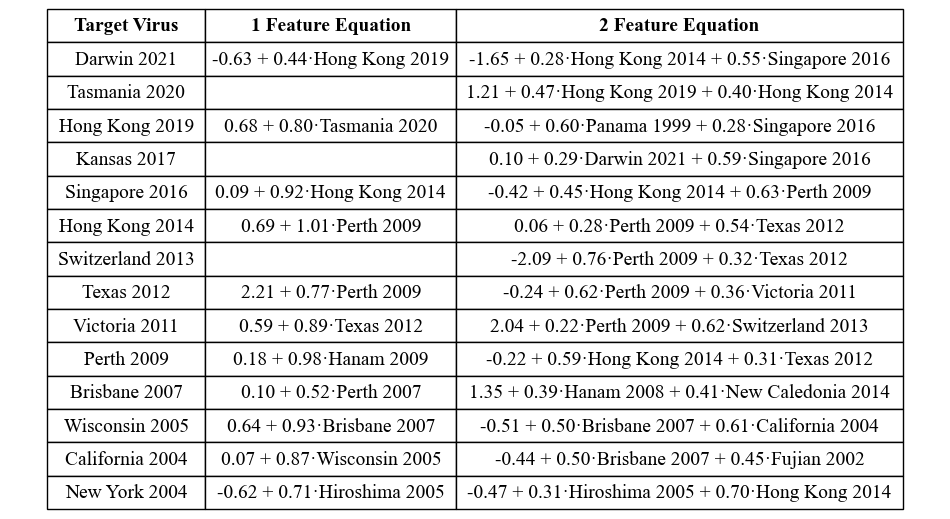

In [ ]:
import pandas as pd
import re
from typing import Union

# ------------------------------------------------------------------------------
# 1. Pretty-print formatting function for equations
# ------------------------------------------------------------------------------
def pretty_equation(eq: Union[str, float]):
    if pd.isna(eq) or not isinstance(eq, str):
        return eq  # leave NaN or non-strings unchanged

    eq = re.sub(r'\(\s*\+?(-?\d*\.?\d+)\)', r'\1', eq)            # unwrap (+0.44)
    eq = re.sub(r'^\s*\+\s*', '', eq)                             # drop leading "+"
    eq = re.sub(r'\+\s*-', ' - ', eq)                             # "+ -0.48" → "- 0.48"
    eq = re.sub(r'\s*\+\s*', ' + ', eq)                           # space around "+"
    eq = re.sub(r'(?<!^)\s*-\s*', ' - ', eq)                      # space around "-"
    eq = re.sub(r'\s+', ' ', eq).strip()                          # collapse spaces
    return eq

# ------------------------------------------------------------------------------
# 2. Function to shorten virus names (used in Target Virus and inside equations)
# ------------------------------------------------------------------------------
def shorten_virus_name(virus_name):
    """
    Shorten a virus name by removing common prefixes and returning the location and year.
    For example, 'H3N2 A/Darwin/9/2021' becomes 'Darwin 2021'.
    """
    # Remove common prefixes
    virus_name = virus_name.replace("H3N2 ", "")
    if virus_name.startswith("A/"):
        virus_name = virus_name[2:]
    
    parts = virus_name.split("/")
    if len(parts) >= 2:
        return f"{parts[0]} {parts[-1]}"
    else:
        return virus_name

def shorten_virus_names_in_equation(equation_str: str):
    # Support 2 to 4 segments in virus names
    pattern = r'(?:H3N2\s+)?(?:A/)?(?:[A-Za-z0-9\-]+/){1,3}[A-Za-z0-9\-]+'

    def replacer(match):
        return shorten_virus_name(match.group(0))

    return re.sub(pattern, replacer, equation_str)

# ------------------------------------------------------------------------------
# 3. Apply cleaning to your vaccine_table
# ------------------------------------------------------------------------------
# Shorten the Target Virus names (like "A/Darwin/9/2021" → "Darwin 2021")
vaccine_table["Target Virus"] = vaccine_table["Target Virus"].apply(shorten_virus_name)

# Apply shortening and pretty-formatting to equations
cols_to_clean = ["1 Feature Equation", "2 Feature Equation"]

for col in cols_to_clean:
    vaccine_table[col] = vaccine_table[col].apply(
        lambda s: pretty_equation(shorten_virus_names_in_equation(s)) if pd.notnull(s) else s
    )

# ------------------------------------------------------------------------------
# 4.Sort by Target Virus or Year
# ------------------------------------------------------------------------------
def extract_year(name: str) -> int:
    matches = re.findall(r'\d{4}', name)
    return int(matches[-1]) if matches else float('inf')

vaccine_table["Virus Year"] = vaccine_table["Target Virus"].apply(extract_year)
vaccine_table.sort_values("Virus Year", ascending=False, inplace=True)
vaccine_table.drop(columns=["Virus Year"], inplace=True)

# ------------------------------------------------------------------------------
# 5. Visualize as a table with matplotlib
# ------------------------------------------------------------------------------
import matplotlib.pyplot as plt

vaccine_table.fillna("", inplace=True)  # Replace NaN with blanks for display

cell_text = vaccine_table.values.tolist()
col_labels = vaccine_table.columns.tolist()

fig, ax = plt.subplots(figsize=(12, 4))
ax.axis('tight')
ax.axis('off')

table = ax.table(cellText=cell_text,
                 colLabels=col_labels,
                 colWidths=[0.17, 0.27, 0.48],
                 cellLoc='center',
                 loc='center')

# Bold header
for (row, col), cell in table.get_celld().items():
    if row == 0:
        cell.get_text().set_fontweight('bold')

table.auto_set_font_size(False)
table.set_fontsize(14)
table.scale(1, 2)

plt.savefig("Figures/Fig5B.png", dpi=600, bbox_inches="tight")
plt.show()
